# Amazon Toys & Games Q & A Chatbots

## By John Callahan

### Dataset URL: https://cseweb.ucsd.edu/~jmcauley/datasets/amazon/qa/

### Dataset: YAML (NLP), JSON (Amazon)

### Category: Toys & Games

#### Project Description

This project focuses on building two chatbots, Term frequency-Inverse document frequency (TF-IDF) and seq2seq. It involves leveraging a dataset of questions and answers from the "Toys & Games" category of Amazon reviews. It encompasses data preprocessing, exploratory data analysis (EDA), and natural language processing (NLP) techniques to create a chatbot system capable of meaningful interaction.  It also incorporates NLP libraries, such as spaCy and Transformers, and employs machine learning models to ensure a responsive and adaptive interaction process. 

In [1]:
#Import Libraries
import numpy as np
import pandas as pd
import re
import ast
import io
import os
import zipfile
import yaml

import spacy
from spacy import displacy

import requests
from gensim.models import Word2Vec
from keras import Input, Model
from keras.activations import softmax
from keras.layers import Embedding, LSTM, Dense
from tensorflow.keras.optimizers import RMSprop
from keras_preprocessing.sequence import pad_sequences
from tensorflow.keras.utils import to_categorical
from keras_preprocessing.text import Tokenizer

from textblob import TextBlob
from operator import itemgetter

#from transformers import pipeline

from sklearn.metrics.pairwise import cosine_similarity
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.feature_extraction.text import TfidfVectorizer

import nltk
from nltk import word_tokenize
from nltk import sent_tokenize
from nltk.corpus import stopwords
from nltk.stem.porter import PorterStemmer
from nltk.stem.snowball import SnowballStemmer
from nltk.stem.wordnet import WordNetLemmatizer
from nltk.probability import FreqDist

from wordcloud import WordCloud

import matplotlib.pyplot as plt
%matplotlib inline

#Download NLTK data
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')
nltk.download('averaged_perceptron_tagger')
nltk.download('universal_tagset')
nltk.download('omw-1.4')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package universal_tagset to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Package universal_tagset is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data] 

True

In [2]:
#Create a function to clean text
def clean_text(text_to_clean):
    text_to_clean = str(text_to_clean)
    res = text_to_clean.lower()
    res = re.sub(r"i'm", "i am", res)
    res = re.sub(r"he's", "he is", res)
    res = re.sub(r"she's", "she is", res)
    res = re.sub(r"it's", "it is", res)
    res = re.sub(r"that's", "that is", res)
    res = re.sub(r"what's", "what is", res)
    res = re.sub(r"where's", "where is", res)
    res = re.sub(r"how's", "how is", res)
    res = re.sub(r"\'ll", "will", res)
    res = re.sub(r"\'ve", "have", res)
    res = re.sub(r"\'re", "are", res)
    res = re.sub(r"\'d", "would", res)
    res = re.sub(r"won't", "will not", res)
    res = re.sub(r"can't", "cannot", res)
    res = re.sub(r"n't", " not", res)
    res = re.sub(r"n'", "ng", res)
    res = re.sub(r"'bout", "about", res)
    res = re.sub(r"'til", "until", res)
    res = re.sub(r"[-()\"#/@;:<>{}`+=~|.!?,]", "", res)
    return res

### Load YAML dataset for NLP

In [3]:
dir_path = 'nlp/data'

files_list = os.listdir(dir_path + os.sep)

nlp_questions = list()
nlp_answers = list()
for filepath in files_list:
    stream = open(dir_path + os.sep + filepath, 'rb')
    docs = yaml.safe_load(stream)
    conversations = docs['conversations']
    for con in conversations:
        if len(con) > 2:
            nlp_questions.append(con[0])
            ans = ''
            for rep in con[1:]:
                ans += ' ' + rep
            nlp_answers.append(ans)
        elif len(con) > 1:
            nlp_questions.append(con[0])
            nlp_answers.append(con[1])

### Load JSON dataset for Amazon Questions and Answers

In [4]:
#Create Empty Lists for Questions (Q) and Answers (A)
questions = []
answers = []

#Load Amazon Q and A into the newly created lists
with open ('dataset/qa_Toys_and_Games.json', 'r') as f:
    for line in f:
        data = ast.literal_eval (line)
        questions.append(data['question'].lower())
        answers.append(data['answer'].lower())

### Data Cleaning

In [5]:
#Clean NLP questions
index = 0
while index < len(nlp_questions):
    nlp_questions[index] = clean_text(nlp_questions[index])
    index += 1

In [6]:
#Print First 20 and Length of NLP Questions
print(nlp_questions[0:20])
print(len(nlp_questions))

['what is ai', 'what is ai', 'are you sentient', 'are you sentient', 'are you sentient', 'are you sapient', 'are you sapient', 'are you sapient', 'are you sapient', 'what language are you written in', 'what language are you written in', 'you sound like data', 'you sound like data', 'you are an artificial linguistic entity', 'you are an artificial linguistic entity', 'you are not immortal', 'you are not immortal', 'you are not immortal', 'you are not making sense', 'you are not making sense']
566


In [7]:
#Clean NLP answers with clean_text function
index = 0
while index < len(nlp_answers):
    nlp_answers[index] = clean_text(nlp_answers[index])
    index += 1

In [8]:
#Print First 20 and Length of NLP Answers
print(nlp_answers[0:20])
print(len(nlp_answers))

['artificial intelligence is the branch of engineering and science devoted to constructing machines that think', 'ai is the field of science which concerns itself with building hardware and software that replicates the functions of the human mind', 'sort of', "by the strictest dictionary definition of the word 'sentience' i may be", 'even though i am a construct i do have a subjective experience of the universe as simplistic as it may be', 'in all probability i am not  i am not that sophisticated', 'do you think i am', 'how would you feel about me if i told you i was', 'no', 'python', 'i am written in python', "yes i am inspired by commander data's artificial personality", 'the character of lt commander data was written to come across as being softwarelike so it is natural that there is a resemblance between us', 'that is my name', 'that is not my name but it is a useful way to refer to me', 'all software can be perpetuated indefinitely', 'i can be copied infinitely and reinstantiated 

In [9]:
#Clean Amazon data with clean_text function
#Clean Amazon questions
index = 0
while index < len(questions):
    questions[index] = clean_text(questions[index])
    index += 1

In [10]:
#Print First 20 and Length of Amazon questions
print(questions[0:20])
print(len(questions))

['are both sides white are both sides magnetic', 'how sturdy or flimsy is the board i am also looking at the expo dry erase magnetic easel i would like for a child to be on each side of the board', 'does it come with letters numbers andor pictures', 'can it hold up wooden magnetic letters', 'can this be lain on its side i need a landscape board thank you', 'should i purchase plain magnet alphabets and numbers', 'is it dryerase', 'is it dryerase', 'what is appropriate age group for this easel', 'can 2 children use it simultaneously from opposite sides as in this 2step easel httpwwwamazoncomgpawdb008vup', "which deck builder toolkit do we get there's 5 pictures showing 4 different card sets", 'could someone tell me which blocks for the booster packs where in the box', 'is this from the 2013 or 2012 core set', 'i have never played dnd but want to try it out with a few friends what do you recommend', 'i have dnd miniatures the oop prepainted and a few maps are those compatible are the newe

In [11]:
#Clean Amazon answers
index = 0
while index < len(answers):
    answers[index] = clean_text(answers[index])
    index += 1

In [12]:
#Print First 20 and Length of Amazon answers
print(answers[0:20])
print(len(answers))

['yes both sides are white and magnetic but markers do not wipe off easily', "the board is very sturdy it folds flat it is great for a child's table top it is not tall enough to stand and play i have been very pleased with it", 'noit is just the easel', 'sorry i do not have likewooden magnet letters to testbut there is no reason to believe that it would not hold wooden magnet unless the wood letters itself is too heavy that it falls off the slanted surfaceit holds the plastic magletters just fine and the surface can be writtendraw on with an erasable markerand you can use the letters on the fridge surfacethe board is a nice additionkids like different things to do to keep their interests up', 'it can yesbut may be a bit awkward to work with but i guess that depends on what you are using it for it folds up flatthe bottom pieces have 2 little velcro circles that snap together to keep the bottom pieces together', 'my grandsons love their letters and animals but any magnets work and fridge

### Combine Datasets

In [13]:
#Combine NLP and Amazon Datasets
combined_questions = questions + nlp_questions
combined_answers = answers + nlp_answers

In [14]:
#Print ength of Combined Questions and Answers
print(len(combined_questions))
print(len(combined_answers))

52052
52052


### EDA
#### Visualize Dataset

In [15]:
#Create a DataFrame that contains the Q and A
df = pd.DataFrame(combined_questions, combined_answers)

In [16]:
df.head(10)

,0
yes both sides are white and magnetic but markers do not wipe off easily,are both sides white are both sides magnetic
the board is very sturdy it folds flat it is great for a child's table top it is not tall enough to stand and play i have been very pleased with it,how sturdy or flimsy is the board i am also lo...
noit is just the easel,does it come with letters numbers andor pictures
sorry i do not have likewooden magnet letters to testbut there is no reason to believe that it would not hold wooden magnet unless the wood letters itself is too heavy that it falls off the slanted surfaceit holds the plastic magletters just fine and the surface can be writtendraw on with an erasable markerand you can use the letters on the fridge surfacethe board is a nice additionkids like different things to do to keep their interests up,can it hold up wooden magnetic letters
it can yesbut may be a bit awkward to work with but i guess that depends on what you are using it for it folds up flatthe bottom pieces have 2 little velcro circles that snap together to keep the bottom pieces together,can this be lain on its side i need a landscap...
my grandsons love their letters and animals but any magnets work and fridge works fine for them,should i purchase plain magnet alphabets and n...
yes,is it dryerase
yes,is it dryerase
my four year old granddaughter loves it,what is appropriate age group for this easel
yeslove this product,can 2 children use it simultaneously from oppo...


In [17]:
df.tail(10)

,0
richard nixon,who was the 37th president of the united states
1963,what year was president john f kennedy assassi...
the soviet union and the united states,the space race was a 20thcentury competition b...
sputnik 1,what was the name of the first artificial eart...
a gyroscope,a spinning disk in which the orientation of th...
edwin hubble,the hubble space telescope launched into low e...
the andromeda galaxy,what is the name of the nearest major galaxy t...
the united kingdom of great britain,god save the queen is the national anthem of w...
europe,the celtic shelf the seabed under the celtic s...
echolocation,dolphins use a sense similar to sonar to deter...


In [18]:
df.describe()

,0
count,52052
unique,46939
top,how big is it
freq,194


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 52052 entries, yes both sides are white and magnetic but markers do not wipe off easily to echolocation
Data columns (total 1 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   0       52052 non-null  object
dtypes: object(1)
memory usage: 813.3+ KB


**As we can see above the count in the describe() and the Non-Null in info() are matching so we do not need to deal with any missing values.**

### NLP
#### TextBlob
#### Visualize Word Frequency with Pandas

In [20]:
#Make a Text Blob for both Q and A
tb_q = TextBlob(" ".join(combined_questions))
tb_a = TextBlob(" ".join(combined_answers))

In [21]:
#Remove Stop Words
stop_words = stopwords.words('english')

In [22]:
#Getting the Word Frequencies
items_q = tb_q.word_counts.items()
items_a = tb_a.word_counts.items()

In [23]:
#Removing the Stop Words
items_q = [item for item in items_q if item[0] not in stop_words]
items_a = [item for item in items_a if item[0] not in stop_words]

In [24]:
#Sort words by frequency
sort_items_q = sorted(items_q, key=itemgetter(1), reverse=True)
sort_items_a = sorted(items_a, key=itemgetter(1), reverse=True)

In [25]:
#Getting the Top 20 Words
top20_q = sort_items_q[1:21]
top20_a = sort_items_a[1:21]

In [26]:
#Convert Top 20 Q to a Dataframe
df_q = pd.DataFrame(top20_q, columns=['word', 'count'])

#Convert Top 20 Q to a Dataframe
df_a = pd.DataFrame(top20_a, columns=['word', 'count'])

In [27]:
#Display Top 20 words from Questions Dataframe
df_q

,word,count
0,one,2939
1,would,2711
2,work,2700
3,size,2403
4,get,2119
5,fit,2099
6,like,1974
7,old,1973
8,many,1969
9,use,1961


In [28]:
#Display Top 20 words from Answers Dataframe 
df_a

,word,count
0,would,6475
1,one,5976
2,like,3431
3,old,3244
4,get,3137
5,use,3095
6,2,3080
7,think,3032
8,sure,2824
9,inches,2804


#### Plot the Top 20 Words for Questions and Answers

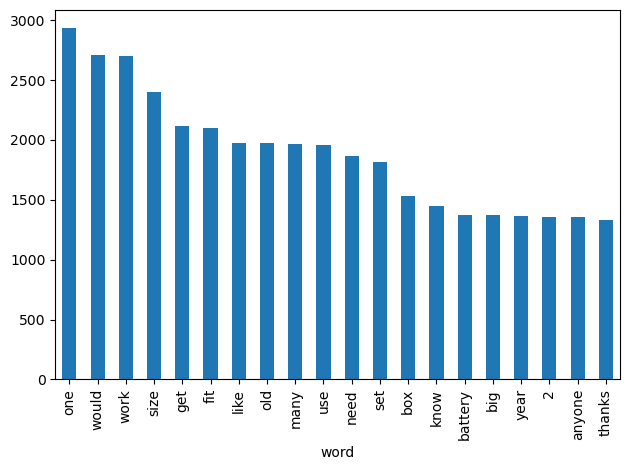

In [29]:
#Visualize the Top 20 Q DataFrame
axes = df_q.plot.bar(x='word', y='count', legend=False)
plt.tight_layout()

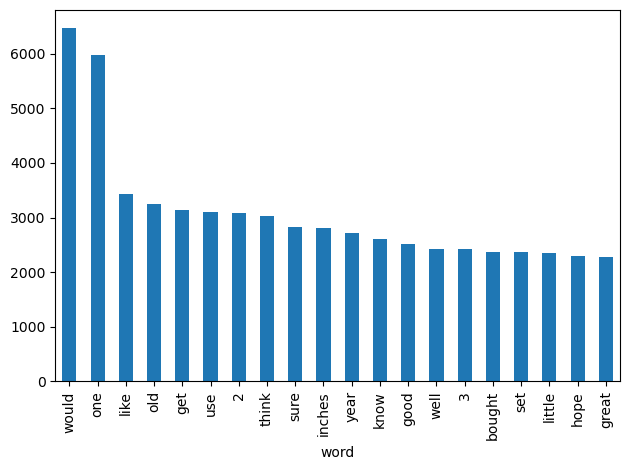

In [30]:
#Visualize the Top 20 A DataFrame
axes = df_a.plot.bar(x='word', y='count', legend=False)
plt.tight_layout()

**As we can see from both the dataframes and as visually represented in the plots there are similarities between the key words in each.  "One" and "would" are both the top words with just the order reversed.  We also see words like "use", "2", "get", and "set" in each dataset again with just the ordering changed.

### Count Vectorization

#### Create Vectorizer for Questions
#### Goal:  To find out the Top 50 Most Common Words in Combined Questions

In [31]:
# Create Model and Remove Stopwords
cv_questions = CountVectorizer(stop_words='english')

In [32]:
#Fit model and train vocabulary from the questions
cv_questions.fit(combined_questions)

CountVectorizer(stop_words='english')

In [33]:
#Print Top 50 of the Vocabulary
print('Vocabulary: ')
print(list(cv_questions.vocabulary_.items())[0:50])

Vocabulary: 
[('sides', 17407), ('white', 21254), ('magnetic', 12006), ('sturdy', 18625), ('flimsy', 8323), ('board', 3771), ('looking', 11811), ('expo', 7790), ('dry', 7025), ('erase', 7556), ('easel', 7202), ('like', 11614), ('child', 4841), ('does', 6771), ('come', 5253), ('letters', 11531), ('numbers', 13329), ('andor', 2497), ('pictures', 14307), ('hold', 9848), ('wooden', 21446), ('lain', 11263), ('need', 13046), ('landscape', 11291), ('thank', 19255), ('purchase', 15259), ('plain', 14436), ('magnet', 12005), ('alphabets', 2374), ('dryerase', 7027), ('appropriate', 2645), ('age', 2218), ('group', 9242), ('children', 4845), ('use', 20511), ('simultaneously', 17478), ('opposite', 13571), ('2step', 902), ('httpwwwamazoncomgpawdb008vup', 10020), ('deck', 6166), ('builder', 4139), ('toolkit', 19671), ('showing', 17365), ('different', 6499), ('card', 4429), ('sets', 17129), ('tell', 19167), ('blocks', 3724), ('booster', 3838), ('packs', 13815)]


In [34]:
#Create copy of vocabulary dictionary
vocabulary_copy = cv_questions.vocabulary_.copy()

In [35]:
#Sort the newly created vocabulary dictionary copy
sorted_vocabulary_copy = sorted(vocabulary_copy.items(), key=lambda x: x[1], reverse=True)

In [36]:
#Display First 50 of Sorted Vocabulary Dictionary
sorted_vocabulary_copy[0:50]

[('zyx22', 21867),
 ('zx', 21866),
 ('zumbuddies', 21865),
 ('zulia', 21864),
 ('zteck', 21863),
 ('zorth', 21862),
 ('zord', 21861),
 ('zootalkers', 21860),
 ('zooming', 21859),
 ('zoomie', 21858),
 ('zoomer', 21857),
 ('zoom', 21856),
 ('zoobs', 21855),
 ('zoobmobile', 21854),
 ('zoob', 21853),
 ('zoo', 21852),
 ('zones', 21851),
 ('zone', 21850),
 ('zombiesling', 21849),
 ('zombies', 21848),
 ('zombie', 21847),
 ('zoid', 21846),
 ('zither', 21845),
 ('zippy', 21844),
 ('zippo', 21843),
 ('zippers', 21842),
 ('zippered', 21841),
 ('zipper', 21840),
 ('zipped', 21839),
 ('ziplock', 21838),
 ('ziploc', 21837),
 ('zipline', 21836),
 ('zipfy', 21835),
 ('zipbin', 21834),
 ('zip', 21833),
 ('zing', 21832),
 ('zinccoated', 21831),
 ('zinc', 21830),
 ('ziggling', 21829),
 ('ziggle', 21828),
 ('zi', 21827),
 ('zhu', 21826),
 ('zeus', 21825),
 ('zeta', 21824),
 ('zero', 21823),
 ('zenoah', 21822),
 ('zenmuse', 21821),
 ('zenmus', 21820),
 ('zendikar', 21819),
 ('zen', 21818)]

**Since we sorted the dictionary with Reverse=True the "z" words are all displayed first.  We can see there are over 21,000 references to words such "zyx22", "zx", and "zumbuddies".

### Convert First 100 Questions into Arrays

In [37]:
#Convert First 100 Questions into Arrays and Remove Stop Words
cv_questions_array = CountVectorizer(stop_words='english')

In [38]:
# Create Model and Remove Stopwords
cv_fit_questions = cv_questions_array.fit_transform(combined_questions[0:99])

In [39]:
#Displau array
print(cv_fit_questions.toarray())

[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 1 ... 0 0 0]]


### Display Question 13 and  the Array

In [40]:
#Display Question 13
questions[12]

'is this from the 2013 or 2012 core set'

In [41]:
#Question 13 in Vectorizer array
print(cv_fit_questions.toarray()[12])

[0 0 0 1 1 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 1 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0
 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0 0]


### Complete POS tagging for Question 13

In [42]:
#Perform POS Tagging on Question 13
pos_text = word_tokenize(questions[12])

nltk.pos_tag(pos_text)

[('is', 'VBZ'),
 ('this', 'DT'),
 ('from', 'IN'),
 ('the', 'DT'),
 ('2013', 'CD'),
 ('or', 'CC'),
 ('2012', 'CD'),
 ('core', 'NN'),
 ('set', 'NN')]

In [44]:
import nltk
nltk.download('tagsets')

#Tag Definitions from NLTK Help
nltk.help.upenn_tagset()

$: dollar
    $ -$ --$ A$ C$ HK$ M$ NZ$ S$ U.S.$ US$
'': closing quotation mark
    ' ''
(: opening parenthesis
    ( [ {
): closing parenthesis
    ) ] }
,: comma
    ,
--: dash
    --
.: sentence terminator
    . ! ?
:: colon or ellipsis
    : ; ...
CC: conjunction, coordinating
    & 'n and both but either et for less minus neither nor or plus so
    therefore times v. versus vs. whether yet
CD: numeral, cardinal
    mid-1890 nine-thirty forty-two one-tenth ten million 0.5 one forty-
    seven 1987 twenty '79 zero two 78-degrees eighty-four IX '60s .025
    fifteen 271,124 dozen quintillion DM2,000 ...
DT: determiner
    all an another any both del each either every half la many much nary
    neither no some such that the them these this those
EX: existential there
    there
FW: foreign word
    gemeinschaft hund ich jeux habeas Haementeria Herr K'ang-si vous
    lutihaw alai je jour objets salutaris fille quibusdam pas trop Monte
    terram fiche oui corporis ...
IN: preposition or

[nltk_data] Downloading package tagsets to
[nltk_data]     C:\Users\jcallahan5\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping help\tagsets.zip.


### Combine Questions And Answers from both Datasets

In [46]:
##Combine all Questions Together
all_questions = "\n".join(combined_questions)

In [47]:
print(all_questions[0:100])

are both sides white are both sides magnetic
how sturdy or flimsy is the board i am also looking at 


In [48]:
#Combine all Answers Together
all_answers = "\n".join(combined_answers)

In [49]:
print(all_answers[0:100])

yes both sides are white and magnetic but markers do not wipe off easily
the board is very sturdy it


### Tokenize Questions and Answers using Word Tokenizer

In [50]:
#Tokenize Questions using Word Tokenizer
questions_wt = word_tokenize(all_questions)

In [51]:
#Tokenize Answers using Word Tokenizer
answers_wt = word_tokenize(all_answers)

In [52]:
#How Many Words in Questions
print("There are " + str(len(questions_wt)) + " words in " + str(len(combined_questions)) + " questions.")


There are 638044 words in 52052 questions.


In [53]:
#How Many Words in Answers
print("There are " + str(len(answers_wt)) + " words in " + str(len(combined_answers)) + " answers.")

There are 1337281 words in 52052 answers.


**After combining Questions and Answers from both datasets we have 52,052 questions.  THere are 638,044 and 1,337,281 words respectively.

### Remove Numeric, Spaces and Symbols from Q & A

In [54]:
#Remove Punctuation Marks and Numbers from Questions
questions_wt_no_pun = []
for w in questions_wt:
    if w.isalpha():
        questions_wt_no_pun.append(w.lower())

In [55]:
#Remove Punctuation Marks and Numbers from Answers
answers_wt_no_pun = []
for w in answers_wt:
    if w.isalpha():
        answers_wt_no_pun.append(w.lower())

In [56]:
#How Many Words in Questions without Punctuation and Numbers
print("There are " + str(len(questions_wt_no_pun)) + " words in " + str(len(combined_questions)) + " questions with no punctuation.")

There are 620513 words in 52052 questions with no punctuation.


In [57]:
#How Many Words in Answers without Punctuation and Numbers
print("There are " + str(len(answers_wt_no_pun)) + " words in " + str(len(combined_answers)) + " answers with no punctuation.")

There are 1291706 words in 52052 answers with no punctuation.


**After removing numbers, spaces and symbols we have reduced Questions from 638,044 to 620,513.  We have also reduced Answers from 1,337,281 to 1,291,706.

### Remove Stop words

In [58]:
#Removing Stop Words
stop_words = stopwords.words('english')

In [59]:
clean_words_questions = []
for w in questions_wt_no_pun:
    if w not in stop_words:
        clean_words_questions.append(w)

In [60]:
clean_words_answers = []
for w in answers_wt_no_pun:
    if w not in stop_words:
        clean_words_answers.append(w)

In [61]:
#How Many Words in Questions without Punctuation and Stopwords
print("There are " + str(len(clean_words_questions)) + " words in " + str(len(combined_questions)) + " answers with no punctuation or stopwords.")

There are 289211 words in 52052 answers with no punctuation or stopwords.


In [62]:
#How Many Words in Answers without Punctuation
print("There are " + str(len(clean_words_answers)) + " words in " + str(len(combined_answers)) + " answers with no punctuation or stopwords.")

There are 617347 words in 52052 answers with no punctuation or stopwords.


**After removing the 'english' stop words questions was even further reduced down to 289,111 words from the previous 620,513.  Answers was reduced from 1,291,706 to 617347.  This cleaning is key to reduce noise, improve computational efficiency, enhance signal-to-noise ratio (TF-IDF relies on the importance of less frequent terms), and to optimize storage and memory.

### Create Frequency Distributions for Q & A

In [63]:
#Create Frequency Distribution of Questions
fdist_questions = FreqDist(clean_words_questions)

In [64]:
#Create Frequency Distribution of Answers
fdist_answers = FreqDist(clean_words_answers)

### Visualize Frequency Distribution of Top 20 Q & A

In [65]:
#20 Most Common Question Words
fdist_questions.most_common(20)

[('come', 3442),
 ('one', 2937),
 ('would', 2710),
 ('work', 2700),
 ('size', 2403),
 ('get', 2119),
 ('fit', 2098),
 ('like', 1974),
 ('old', 1972),
 ('many', 1969),
 ('use', 1960),
 ('need', 1870),
 ('set', 1814),
 ('box', 1534),
 ('know', 1445),
 ('big', 1371),
 ('battery', 1371),
 ('year', 1367),
 ('anyone', 1356),
 ('thanks', 1331)]

In [66]:
#20 Most Common Answer Words
fdist_answers.most_common(20)

[('yes', 8809),
 ('would', 6475),
 ('one', 5975),
 ('like', 3430),
 ('old', 3242),
 ('get', 3137),
 ('use', 3095),
 ('think', 3032),
 ('sure', 2824),
 ('inches', 2804),
 ('year', 2712),
 ('know', 2603),
 ('good', 2513),
 ('well', 2425),
 ('bought', 2376),
 ('set', 2375),
 ('little', 2358),
 ('hope', 2297),
 ('great', 2284),
 ('size', 2237)]

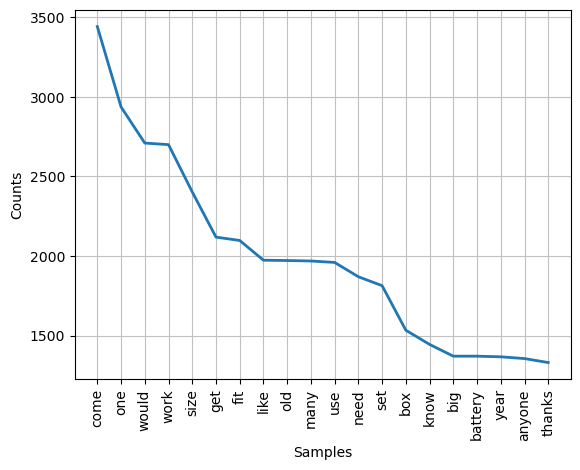

<Axes: xlabel='Samples', ylabel='Counts'>

In [67]:
#Graph Frequency Distribution of 20 Most Common Question Words
fdist_questions.plot(20)

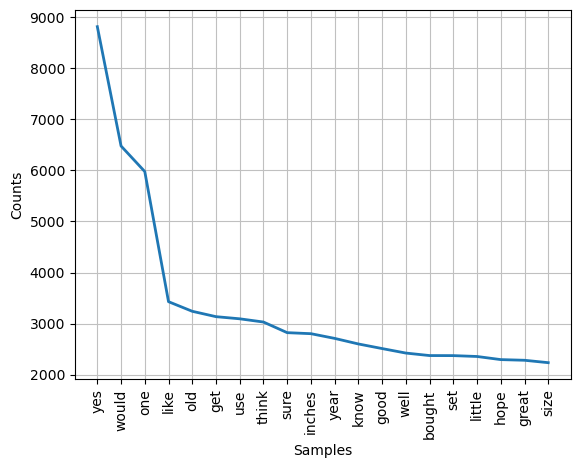

<Axes: xlabel='Samples', ylabel='Counts'>

In [68]:
#Graph Frequency Distribution of 20 Most Common Answer Words
fdist_answers.plot(20)

### Word Cloud for Combined Q & A

In [69]:
#Create Word Cloud for Questions
wc_questions = WordCloud().generate(all_questions)

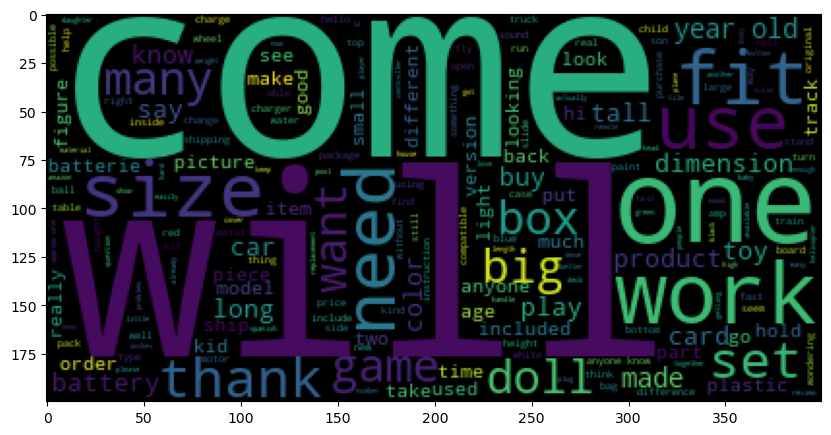

In [70]:
plt.figure(figsize = (10, 10))
plt.imshow(wc_questions)

In [71]:
#Create Word Cloud for Answers
wc_answers = WordCloud().generate(all_answers)

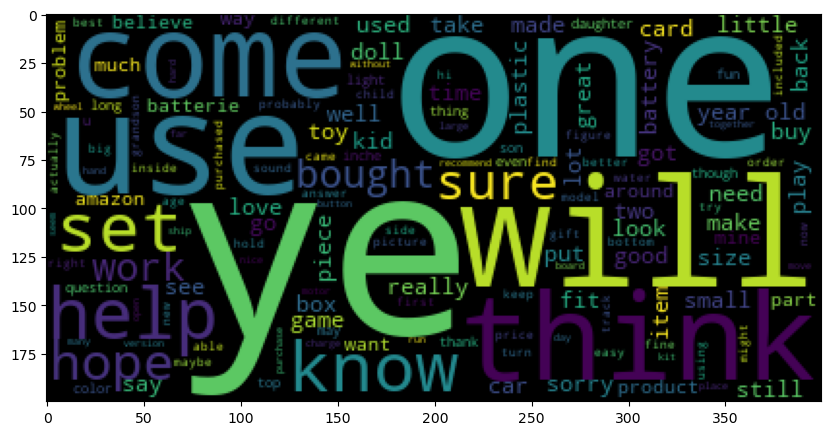

In [72]:
plt.figure(figsize = (10, 10))
plt.imshow(wc_answers)

**In the frequency distribution we again see similar words in both the questions and answers with just their order changed.  Words such as would, like, and old are in both.  In questions the top 3 are come, one, and would.  In answers the top 3 are yes, would, and one.

### Named ENtity Recognition (NER)

### spaCy

In [73]:
#Convert the list into a string
q_str = ''
a_str = ''

for q in combined_questions:
    q_str += str(q)+' '
for a in combined_answers:
    a_str += str(a)+' '

In [76]:
#Download and load the en_core_web_lg model
!python -m spacy download en_core_web_lg
nlp = spacy.load("en_core_web_lg")
#Questions
doc_q = nlp(q_str[0:300000])

displacy.render(doc_q, style='ent', jupyter=True)

  Using cached https://github.com/explosion/spacy-models/releases/download/en_core_web_lg-3.6.0/en_core_web_lg-3.6.0-py3-none-any.whl (587.7 MB)
[+] Download and installation successful
You can now load the package via spacy.load('en_core_web_lg')


In [77]:
nlp = spacy.load("en_core_web_lg")
#Answers
doc_a = nlp(a_str[0:300000])

displacy.render(doc_a, style='ent', jupyter=True)

**While spaCy is an effective NER it does have a limit of 1,000,000 characters so ensure you either have a smaller dataset or limit the characters as we have done above.  Also the models require roughly 1 GB of memory per 100,000 characters.  Due to this you can encounter memory allocation errors.

### NLP Transformer Pipeline NER

In [78]:
#nlp_transformer = pipeline(task='ner')

NameError: name 'pipeline' is not defined

In [ ]:
#for item in nlp_transformer(q_str[0:300000]):
    print(f"{item['word'], item['entity']}")

In [ ]:
#for item in nlp_transformer(a_str[0:300000]):
    print(f"{item['word'], item['entity']}")

**Though I was unable to load NLP Transformer in the Remote VM I was able to load this properly on my local machine.  It was not able to properly apply NER to any words in the dataset.  Based on this spaCy is the best choice between the two though it still had challenged.

### Term Frequency-Inverse Document Frequency based Vectorizer

In [80]:
corpus_questions = pd.Series(combined_questions)

# Convert pandas Series to list
if isinstance(corpus_questions, pd.Series):
    corpus_questions = corpus_questions.tolist()

# Filter and clean the list to ensure all elements are strings
corpus_questions = [str(doc) if isinstance(doc, (int, float)) else doc for doc in corpus_questions]
corpus_questions = [doc for doc in corpus_questions if isinstance(doc, str)]

In [83]:
corpus_answers = pd.Series(combined_answers)

# Convert pandas Series to list
if isinstance(corpus_answers, pd.Series):
    corpus_answers = corpus_answers.tolist()

# Filter and clean the list to ensure all elements are strings
corpus_answers = [str(doc) if isinstance(doc, (int, float)) else doc for doc in corpus_answers]
corpus_answers = [doc for doc in corpus_answers if isinstance(doc, str)]


### Data preprocessing functions

In [84]:
def text_clean(corpus, keep_list):
    cleaned_corpus = []
    for doc in corpus:
        if isinstance(doc, str):
            cc = []
            for word in doc.split():
                # Check if word is in keep_list, avoid replacing valid characters
                if word not in keep_list:
                    p1 = re.sub(pattern='[^a-zA-Z0-9]', repl=' ', string=word)  # Replace only non-alphanumeric characters
                    cc.append(p1)
                else:
                    cc.append(word)
            cleaned_corpus.append(' '.join(cc))
        else:
            raise ValueError(f"Expected string, got {type(doc)}")
    return cleaned_corpus


In [85]:
lemmatizer = WordNetLemmatizer()

def lemmatize(corpus):
    lemmatized_corpus = []
    for doc in corpus:
        # Split document into words, lemmatize each word, and rejoin
        lemmatized_doc = [lemmatizer.lemmatize(word) for word in doc.split()]
        lemmatized_corpus.append(' '.join(lemmatized_doc))
    return lemmatized_corpus

In [86]:
def stem(corpus, stem_type=None):
    if stem_type == 'snowball':
        stemmer = SnowballStemmer(language = 'english')
        corpus = [[stemmer.stem(x) for x in x] for x in corpus]
    else:
        stemmer = PorterStemmer()
        corpus = [[stemmer.stem(x) for x in x] for x in corpus]
    return corpus

In [87]:
def stopwords_removal(corpus):
    stop = set(stopwords.words('english'))  # Define your stop words
    filtered_corpus = []
    for doc in corpus:
        if isinstance(doc, str):  # Ensure the element is a string
            filtered_doc = [word for word in doc.split() if word not in stop]
            filtered_corpus.append(" ".join(filtered_doc))
        else:
            raise ValueError(f"Expected string, got {type(doc)}")  # Error if non-string
    return filtered_corpus


In [88]:
def preprocess(corpus, keep_list, cleaning=True, stemming=False, stem_type=None, lemmatization=False, remove_stopwords=True):
    if not isinstance(corpus, list):
        raise TypeError("Input corpus must be a list.")
    
    # Handle dictionaries: extract text if necessary
    if all(isinstance(doc, dict) for doc in corpus):
        corpus = [doc.get('text', '') for doc in corpus]
    
    # Validate that all elements are strings
    corpus = [str(doc) for doc in corpus if isinstance(doc, (str, int, float))]
    
    if cleaning:
        corpus = text_clean(corpus, keep_list)
    
    if remove_stopwords:
        corpus = stopwords_removal(corpus)
    
    if lemmatization:
        corpus = lemmatize(corpus)
    
    if stemming:
        corpus = stem(corpus, stem_type)
    
    # Rejoin tokens into properly spaced sentences
    corpus = [' '.join(doc.split()) for doc in corpus]
    
    return corpus


### Data preprocessing pipeline for the TF-IDF Vectorizer

In [89]:
#Preprocessing with Lemmatization
common_dot_words = ['U.S.', 'Mr.', 'Mrs.', 'D.C.']

In [90]:
preprocessed_corpus_questions = preprocess(corpus_questions, keep_list = common_dot_words, cleaning =True, stemming = False, stem_type = None, lemmatization = True, remove_stopwords = True)

preprocessed_corpus_questions[0:99]

['side white side magnetic',
 'sturdy flimsy board also looking expo dry erase magnetic easel would like child side board',
 'come letter number andor picture',
 'hold wooden magnetic letter',
 'lain side need landscape board thank',
 'purchase plain magnet alphabet number',
 'dryerase',
 'dryerase',
 'appropriate age group easel',
 '2 child use simultaneously opposite side 2step easel httpwwwamazoncomgpawdb008vup',
 'deck builder toolkit get 5 picture showing 4 different card set',
 'could someone tell block booster pack box',
 '2013 2012 core set',
 'never played dnd want try friend recommend',
 'dnd miniature oop prepainted map compatible newer dungeon tile compatible',
 'like official manual game',
 'much shipping weight come rule book',
 'core ampd game need buy play standalone',
 'ashardalon pushed back march anyone know official release date',
 '1 play game still fun first time 2 play many time still fun repetitive',
 'game look like go boardgamegeek amazon listing complete',
 '

In [91]:
preprocessed_corpus_answers = preprocess(corpus_answers, keep_list = common_dot_words, cleaning = True, stemming = False, stem_type = None, lemmatization = True, remove_stopwords = True)

preprocessed_corpus_answers[0:99]

['yes side white magnetic marker wipe easily',
 'board sturdy fold flat great child table top tall enough stand play pleased',
 'noit easel',
 'sorry likewooden magnet letter testbut reason believe would hold wooden magnet unless wood letter heavy fall slanted surfaceit hold plastic magletters fine surface writtendraw erasable markerand use letter fridge surfacethe board nice additionkids like different thing keep interest',
 'yesbut may bit awkward work guess depends using fold flatthe bottom piece 2 little velcro circle snap together keep bottom piece together',
 'grandson love letter animal magnet work fridge work fine',
 'yes',
 'yes',
 'four year old granddaughter love',
 'yeslove product',
 'order today june 1 2013 youwill get 2013 set picture misleading youwill get set whatever current core set',
 'picture quite misleading actually probably give recent version box meaning booster m14 rtr block',
 '2012 entirely different set 2013 search',
 'although game come close legitimate dn

### Tfidf Vectorizer Q & A

In [92]:
#TfIdfVectorize Questions and Answers
vectorizer_tfidf_questions = TfidfVectorizer()
vectorizer_tfidf_answers = TfidfVectorizer()

In [93]:
#Fit the questions
tfidf_questions_matrix = vectorizer_tfidf_questions.fit_transform(preprocessed_corpus_questions)

In [94]:
#Fit the answers
tfidf_answers_matrix = vectorizer_tfidf_answers.fit_transform(preprocessed_corpus_answers)

### Display obtained features and TF-IDF matrix

In [95]:
#Print the Question features, toarray, and shape
print(vectorizer_tfidf_questions.get_feature_names_out())
print(tfidf_questions_matrix.toarray())
print("The shape of the TF-IDF Matrix: ", tfidf_questions_matrix.shape)

['00' '000' '0001uf' ... 'zumbuddies' 'zx' 'zyx22']
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
The shape of the TF-IDF Matrix:  (52052, 20069)


In [96]:
#Print the Answer features, toarray, and shape
print(vectorizer_tfidf_answers.get_feature_names_out())
print(tfidf_answers_matrix.toarray())
print("The shape of the TF-IDF Matrix: ", tfidf_answers_matrix.shape)

['00' '000' '00035mm' ... 'zx' 'zyudenchis' 'zyuranger']
[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]
The shape of the TF-IDF Matrix:  (52052, 32858)


In [97]:
#Display feature names for the Questions
feature_names = vectorizer_tfidf_questions.get_feature_names_out()
for col in tfidf_questions_matrix.nonzero()[1]:
    print(feature_names[col], " - ", tfidf_questions_matrix[0, col])

magnetic  -  0.47102666577828173
white  -  0.4088681217117368
side  -  0.7816397758390442
child  -  0.0
like  -  0.0
would  -  0.0
easel  -  0.0
erase  -  0.0
dry  -  0.0
expo  -  0.0
looking  -  0.0
also  -  0.0
board  -  0.0
flimsy  -  0.0
sturdy  -  0.0
magnetic  -  0.47102666577828173
side  -  0.7816397758390442
picture  -  0.0
andor  -  0.0
number  -  0.0
letter  -  0.0
come  -  0.0
wooden  -  0.0
hold  -  0.0
letter  -  0.0
magnetic  -  0.47102666577828173
thank  -  0.0
landscape  -  0.0
need  -  0.0
lain  -  0.0
board  -  0.0
side  -  0.7816397758390442
alphabet  -  0.0
magnet  -  0.0
plain  -  0.0
purchase  -  0.0
number  -  0.0
dryerase  -  0.0
dryerase  -  0.0
group  -  0.0
age  -  0.0
appropriate  -  0.0
easel  -  0.0
httpwwwamazoncomgpawdb008vup  -  0.0
2step  -  0.0
opposite  -  0.0
simultaneously  -  0.0
use  -  0.0
child  -  0.0
easel  -  0.0
side  -  0.7816397758390442
set  -  0.0
card  -  0.0
different  -  0.0
showing  -  0.0
get  -  0.0
toolkit  -  0.0
builder  -  0.0

kind  -  0.0
use  -  0.0
football  -  0.0
overall  -  0.0
length  -  0.0
size  -  0.0
x51x12  -  0.0
297  -  0.0
discription  -  0.0
inch  -  0.0
actual  -  0.0
say  -  0.0
size  -  0.0
product  -  0.0
arrives  -  0.0
chopper  -  0.0
bad  -  0.0
week  -  0.0
bought  -  0.0
thinking  -  0.0
battery  -  0.0
next  -  0.0
getting  -  0.0
second  -  0.0
hard  -  0.0
get  -  0.0
fix  -  0.0
defect  -  0.0
backward  -  0.0
doesnt  -  0.0
mine  -  0.0
forward  -  0.0
problem  -  0.0
way  -  0.0
go  -  0.0
would  -  0.0
s34  -  0.0
particular  -  0.0
bigger  -  0.0
far  -  0.0
size  -  0.0
come  -  0.0
pattern  -  0.0
back  -  0.0
tile  -  0.0
side  -  0.7816397758390442
pusher  -  0.0
set  -  0.0
come  -  0.0
wind  -  0.0
flower  -  0.0
joker  -  0.0
amp  -  0.0
included  -  0.0
many  -  0.0
set  -  0.0
redgreen  -  0.0
mixture  -  0.0
green  -  0.0
bam  -  0.0
confusing  -  0.0
dot  -  0.0
bambo  -  0.0
beginner  -  0.0
instead  -  0.0
color  -  0.0
tile  -  0.0
embellished  -  0.0
tile  -  0

swim  -  0.0
corgi  -  0.0
shes  -  0.0
pool  -  0.0
something  -  0.0
bit  -  0.0
big  -  0.0
tall  -  0.0
good  -  0.0
play  -  0.0
want  -  0.0
would  -  0.0
toddler  -  0.0
many  -  0.0
time  -  0.0
hold  -  0.0
diameter  -  0.0
gallon  -  0.0
many  -  0.0
hold  -  0.0
intex  -  0.0
smallest  -  0.0
pool  -  0.0
diameter  -  0.0
foot  -  0.0
well  -  0.0
cover  -  0.0
work  -  0.0
see  -  0.0
brim  -  0.0
height  -  0.0
deep  -  0.0
pool  -  0.0
bottom  -  0.0
inch  -  0.0
top  -  0.0
15  -  0.0
filled  -  0.0
side  -  0.7816397758390442
1111  -  0.0
gloss  -  0.0
testors  -  0.0
blue  -  0.0
dark  -  0.0
know  -  0.0
enamel  -  0.0
mixed  -  0.0
dab  -  0.0
boxcould  -  0.0
quickly  -  0.0
yellow  -  0.0
green  -  0.0
blue  -  0.0
mentioned  -  0.0
thanks  -  0.0
dry  -  0.0
individual  -  0.0
color  -  0.0
comfort  -  0.0
ultimate  -  0.0
versus  -  0.0
consider  -  0.0
deciding  -  0.0
tough  -  0.0
recommendation  -  0.0
wagon  -  0.0
time  -  0.0
anyone  -  0.0
steel  -  0.0
w

level  -  0.0
skid  -  0.0
mounted  -  0.0
door  -  0.0
gun  -  0.0
paint  -  0.0
original  -  0.0
color  -  0.0
paint  -  0.0
model  -  0.0
pump  -  0.0
come  -  0.0
dog  -  0.0
pop  -  0.0
use  -  0.0
durable  -  0.0
dimension  -  0.0
shipping  -  0.0
outlet  -  0.0
drain  -  0.0
plug  -  0.0
pool  -  0.0
water  -  0.0
fit  -  0.0
much  -  0.0
ring  -  0.0
pink  -  0.0
great  -  0.0
pool  -  0.0
month  -  0.0
top  -  0.0
really  -  0.0
boy  -  0.0
old  -  0.0
look  -  0.0
like  -  0.0
oneyear  -  0.0
ball  -  0.0
pit  -  0.0
needed  -  0.0
old  -  0.0
make  -  0.0
many  -  0.0
padded  -  0.0
pool  -  0.0
floor  -  0.0
gallon  -  0.0
capacity  -  0.0
figure  -  0.0
good  -  0.0
leagaccy  -  0.0
verison  -  0.0
bad  -  0.0
figure  -  0.0
get  -  0.0
buy  -  0.0
verision  -  0.0
legacy  -  0.0
saw  -  0.0
figure  -  0.0
good  -  0.0
one  -  0.0
go  -  0.0
cup  -  0.0
price  -  0.0
many  -  0.0
come  -  0.0
cupcake  -  0.0
bake  -  0.0
cup  -  0.0
big  -  0.0
enough  -  0.0
regular  -  0

undo  -  0.0
button  -  0.0
unit  -  0.0
pictured  -  0.0
model  -  0.0
newer  -  0.0
solitaire  -  0.0
many  -  0.0
game  -  0.0
solitaire  -  0.0
screen  -  0.0
hand  -  0.0
held  -  0.0
size  -  0.0
game  -  0.0
instruction  -  0.0
get  -  0.0
light  -  0.0
backlighting  -  0.0
cordially  -  0.0
deliver  -  0.0
france  -  0.0
hello  -  0.0
possible  -  0.0
made  -  0.0
toy  -  0.0
dimension  -  0.0
stroller  -  0.0
push  -  0.0
around  -  0.0
size  -  0.0
product  -  0.0
child  -  0.0
animal  -  0.0
calico  -  0.0
critter  -  0.0
accessory  -  0.0
12  -  0.0
inch  -  0.0
daughter  -  0.0
work  -  0.0
little  -  0.0
plastic  -  0.0
like  -  0.0
frie  -  0.0
skipper  -  0.0
kelly  -  0.0
playground  -  0.0
barbie  -  0.0
piece  -  0.0
work  -  0.0
doll  -  0.0
house  -  0.0
size  -  0.0
also  -  0.0
calico  -  0.0
critter  -  0.0
work  -  0.0
big  -  0.0
would  -  0.0
furniture  -  0.0
approx  -  0.0
happy  -  0.0
youngest  -  0.0
nursery  -  0.0
poseable  -  0.0
believe  -  0.0
inch 

use  -  0.0
hold  -  0.0
also  -  0.0
noodle  -  0.0
come  -  0.0
noodle  -  0.0
chair  -  0.0
come  -  0.0
384  -  0.0
holiday  -  0.0
express  -  0.0
curved  -  0.0
track  -  0.0
know  -  0.0
anyone  -  0.0
purchase  -  0.0
380  -  0.0
holiday  -  0.0
express  -  0.0
curved  -  0.0
train  -  0.0
replacement  -  0.0
straight  -  0.0
track  -  0.0
fit  -  0.0
model  -  0.0
need  -  0.0
number  -  0.0
no385s  -  0.0
animated  -  0.0
sears  -  0.0
holiday  -  0.0
express  -  0.0
train  -  0.0
track  -  0.0
fit  -  0.0
set  -  0.0
brass  -  0.0
track  -  0.0
plastic  -  0.0
lgb  -  0.0
brass  -  0.0
track  -  0.0
compatible  -  0.0
380  -  0.0
384  -  0.0
connection  -  0.0
end  -  0.0
together  -  0.0
track  -  0.0
show  -  0.0
fit  -  0.0
two  -  0.0
compatible  -  0.0
need  -  0.0
380  -  0.0
train  -  0.0
track  -  0.0
sure  -  0.0
model  -  0.0
compatible  -  0.0
set  -  0.0
come  -  0.0
scan  -  0.0
food  -  0.0
play  -  0.0
use  -  0.0
die  -  0.0
drawer  -  0.0
open  -  0.0
batter

say  -  0.0
world  -  0.0
make  -  0.0
thanks  -  0.0
tell  -  0.0
phrasebuzz  -  0.0
buzz  -  0.0
command  -  0.0
movie  -  0.0
toy  -  0.0
light  -  0.0
star  -  0.0
original  -  0.0
mean  -  0.0
say  -  0.0
year  -  0.0
first  -  0.0
also  -  0.0
loses  -  0.0
mine  -  0.0
happens  -  0.0
sound  -  0.0
lost  -  0.0
one  -  0.0
different  -  0.0
height  -  0.0
buzz  -  0.0
16  -  0.0
inch  -  0.0
speak  -  0.0
english  -  0.0
story  -  0.0
toy  -  0.0
tralier  -  0.0
due  -  0.0
light  -  0.0
made  -  0.0
usa  -  0.0
height  -  0.0
remote  -  0.0
vehicle  -  0.0
control  -  0.0
width  -  0.0
length  -  0.0
also  -  0.0
instruction  -  0.0
come  -  0.0
fast  -  0.0
video  -  0.0
see  -  0.0
assemble  -  0.0
really  -  0.0
minute  -  0.0
take  -  0.0
trailer  -  0.0
go  -  0.0
know  -  0.0
anyone  -  0.0
get  -  0.0
26  -  0.0
truck  -  0.0
inch  -  0.0
really  -  0.0
description  -  0.0
say  -  0.0
long  -  0.0
like  -  0.0
paint  -  0.0
assemble  -  0.0
ot  -  0.0
everything  -  0.0


hooked  -  0.0
could  -  0.0
fountain  -  0.0
doughboy  -  0.0
ground  -  0.0
pool  -  0.0
work  -  0.0
hose  -  0.0
hello  -  0.0
long  -  0.0
adjusted  -  0.0
shortened  -  0.0
hose  -  0.0
pool  -  0.0
water  -  0.0
sink  -  0.0
fountain  -  0.0
pressure  -  0.0
alot  -  0.0
work  -  0.0
need  -  0.0
inground  -  0.0
pool  -  0.0
work  -  0.0
fountain  -  0.0
height  -  0.0
adjust  -  0.0
easily  -  0.0
fountain  -  0.0
height  -  0.0
adjust  -  0.0
thank  -  0.0
lightwhat  -  0.0
green  -  0.0
charged  -  0.0
24  -  0.0
battery  -  0.0
hour  -  0.0
still  -  0.0
pool  -  0.0
ride  -  0.0
one  -  0.0
size  -  0.0
shallow  -  0.0
lake  -  0.0
float  -  0.0
swim  -  0.0
dropped  -  0.0
area  -  0.0
something  -  0.0
work  -  0.0
help  -  0.0
would  -  0.0
dead  -  0.0
completely  -  0.0
charge  -  0.0
24  -  0.0
initial  -  0.0
hour  -  0.0
wondering  -  0.0
long  -  0.0
take  -  0.0
think  -  0.0
also  -  0.0
battery  -  0.0
come  -  0.0
battery  -  0.0
come  -  0.0
dolphin  -  0.0
s

deed  -  0.0
chancechest  -  0.0
property  -  0.0
buyer  -  0.0
purple  -  0.0
recent  -  0.0
title  -  0.0
brown  -  0.0
size  -  0.0
two  -  0.0
first  -  0.0
card  -  0.0
quarter  -  0.0
fold  -  0.0
half  -  0.0
board  -  0.0
change  -  0.0
rule  -  0.0
else  -  0.0
ever  -  0.0
think  -  0.0
best  -  0.0
anyone  -  0.0
game  -  0.0
board  -  0.0
assessed  -  0.0
skyscraper  -  0.0
assessment  -  0.0
street  -  0.0
repair  -  0.0
get  -  0.0
anybody  -  0.0
yet  -  0.0
change  -  0.0
needed  -  0.0
play  -  0.0
rule  -  0.0
game  -  0.0
motor  -  0.0
charging  -  0.0
night  -  0.0
light  -  0.0
battery  -  0.0
power  -  0.0
help  -  0.0
come  -  0.0
mine  -  0.0
charge  -  0.0
instruction  -  0.0
battery  -  0.0
far  -  0.0
well  -  0.0
work  -  0.0
long  -  0.0
take  -  0.0
thanks  -  0.0
come  -  0.0
boat  -  0.0
horse  -  0.0
schleich  -  0.0
top  -  0.0
say  -  0.0
put  -  0.0
thank  -  0.0
made  -  0.0
product  -  0.0
replacement  -  0.0
type  -  0.0
battery  -  0.0
pack  -  0

america  -  0.0
help  -  0.0
captain  -  0.0
america  -  0.0
volume  -  0.0
every  -  0.0
cpatain  -  0.0
death  -  0.0
america  -  0.0
collection  -  0.0
cap  -  0.0
25  -  0.0
include  -  0.0
issue  -  0.0
know  -  0.0
anyone  -  0.0
view  -  0.0
ipad  -  0.0
thank  -  0.0
would  -  0.0
premium  -  0.0
home  -  0.0
window  -  0.0
work  -  0.0
watermark  -  0.0
prevents  -  0.0
io  -  0.0
app  -  0.0
device  -  0.0
vengeance  -  0.0
90  -  0.0
spirit  -  0.0
include  -  0.0
book  -  0.0
view  -  0.0
collection  -  0.0
ipad  -  0.0
thank  -  0.0
would  -  0.0
differnt  -  0.0
dollar  -  0.0
22  -  0.0
something  -  0.0
one  -  0.0
battery  -  0.0
thing  -  0.0
come  -  0.0
battery  -  0.0
kind  -  0.0
take  -  0.0
doubled  -  0.0
thinkgeek  -  0.0
half  -  0.0
bought  -  0.0
price  -  0.0
special  -  0.0
expensive  -  0.0
make  -  0.0
one  -  0.0
made  -  0.0
made  -  0.0
tenth  -  0.0
sonic  -  0.0
screwdriver  -  0.0
doctor  -  0.0
difference  -  0.0
product  -  0.0
know  -  0.0
anyo

cone  -  0.0
foot  -  0.0
trying  -  0.0
right  -  0.0
fit  -  0.0
tall  -  0.0
back  -  0.0
side  -  0.7816397758390442
prompt  -  0.0
thaks  -  0.0
proceed  -  0.0
replay  -  0.0
dimension  -  0.0
order  -  0.0
please  -  0.0
shipping  -  0.0
box  -  0.0
need  -  0.0
ball  -  0.0
pit  -  0.0
area  -  0.0
big  -  0.0
smushed  -  0.0
ft  -  0.0
bounce  -  0.0
inflate  -  0.0
maybe  -  0.0
cone  -  0.0
top  -  0.0
room  -  0.0
high  -  0.0
wondering  -  0.0
really  -  0.0
tall  -  0.0
house  -  0.0
still  -  0.0
age  -  0.0
packaged  -  0.0
dimension  -  0.0
product  -  0.0
shipping  -  0.0
store  -  0.0
way  -  0.0
best  -  0.0
requirement  -  0.0
cord  -  0.0
standard  -  0.0
list  -  0.0
power  -  0.0
extension  -  0.0
long  -  0.0
use  -  0.0
bounce  -  0.0
surface  -  0.0
wall  -  0.0
top  -  0.0
inside  -  0.0
high  -  0.0
12x15x7  -  0.0
entrance  -  0.0
slide  -  0.0
12  -  0.0
foot  -  0.0
dimension  -  0.0
15  -  0.0
side  -  0.7816397758390442
kidteen  -  0.0
commercial  -  0

oreo  -  0.0
bag  -  0.0
fit  -  0.0
square  -  0.0
size  -  0.0
board  -  0.0
square  -  0.0
measurement  -  0.0
give  -  0.0
stick  -  0.0
magnet  -  0.0
board  -  0.0
made  -  0.0
board  -  0.0
spare  -  0.0
part  -  0.0
possible  -  0.0
buy  -  0.0
bike  -  0.0
seat  -  0.0
hole  -  0.0
adjust  -  0.0
missing  -  0.0
may  -  0.0
something  -  0.0
think  -  0.0
version  -  0.0
one  -  0.0
assembling  -  0.0
washer  -  0.0
bike  -  0.0
front  -  0.0
fit  -  0.0
back  -  0.0
come  -  0.0
considering  -  0.0
worried  -  0.0
2nd  -  0.0
daughter  -  0.0
enough  -  0.0
birthday  -  0.0
tall  -  0.0
ride  -  0.0
need  -  0.0
bike  -  0.0
three  -  0.0
old  -  0.0
year  -  0.0
appropriate  -  0.0
bike  -  0.0
suggest  -  0.0
girl  -  0.0
balance  -  0.0
smart  -  0.0
thanks  -  0.0
age  -  0.0
steerable  -  0.0
fixed  -  0.0
handlebar  -  0.0
seen  -  0.0
ihave  -  0.0
position  -  0.0
assembled  -  0.0
come  -  0.0
work  -  0.0
old  -  0.0
year  -  0.0
135  -  0.0
125  -  0.0
height  -  0

diameter  -  0.0
ok  -  0.0
league  -  0.0
little  -  0.0
used  -  0.0
rule  -  0.0
game  -  0.0
use  -  0.0
pricesize  -  0.0
bat  -  0.0
maple  -  0.0
ash  -  0.0
screen  -  0.0
top  -  0.0
full  -  0.0
part  -  0.0
description  -  0.0
talk  -  0.0
say  -  0.0
barrel  -  0.0
wide  -  0.0
breakage  -  0.0
old  -  0.0
year  -  0.0
size  -  0.0
bat  -  0.0
curved  -  0.0
cap  -  0.0
feature  -  0.0
end  -  0.0
bat  -  0.0
inch  -  0.0
30  -  0.0
anyone  -  0.0
weight  -  0.0
much  -  0.0
get  -  0.0
barrel  -  0.0
thick  -  0.0
boy  -  0.0
old  -  0.0
year  -  0.0
size  -  0.0
get  -  0.0
bat  -  0.0
weigh  -  0.0
much  -  0.0
strict  -  0.0
bat  -  0.0
diameter  -  0.0
ok  -  0.0
league  -  0.0
little  -  0.0
used  -  0.0
rule  -  0.0
game  -  0.0
use  -  0.0
pricesize  -  0.0
bat  -  0.0
maple  -  0.0
ash  -  0.0
screen  -  0.0
top  -  0.0
full  -  0.0
part  -  0.0
description  -  0.0
talk  -  0.0
say  -  0.0
barrel  -  0.0
wide  -  0.0
breakage  -  0.0
old  -  0.0
year  -  0.0
size  

dimentions  -  0.0
provide  -  0.0
specific  -  0.0
product  -  0.0
someone  -  0.0
thank  -  0.0
match  -  0.0
drawer  -  0.0
sense  -  0.0
make  -  0.0
anyone  -  0.0
purchase  -  0.0
lego  -  0.0
older  -  0.0
daughter  -  0.0
love  -  0.0
interested  -  0.0
really  -  0.0
starting  -  0.0
good  -  0.0
child  -  0.0
would  -  0.0
underneath  -  0.0
consider  -  0.0
bottom  -  0.0
edge  -  0.0
storage  -  0.0
measurement  -  0.0
option  -  0.0
table  -  0.0
floor  -  0.0
tell  -  0.0
someone  -  0.0
need  -  0.0
made  -  0.0
size  -  0.0
protector  -  0.0
sleeve  -  0.0
come  -  0.0
2dollar  -  0.0
bill  -  0.0
real  -  0.0
dollar  -  0.0
bill  -  0.0
real  -  0.0
stuff  -  0.0
buy  -  0.0
pay  -  0.0
actual  -  0.0
item  -  0.0
use  -  0.0
bill  -  0.0
package  -  0.0
one  -  0.0
come  -  0.0
1976  -  0.0
series  -  0.0
bill  -  0.0
many  -  0.0
dollar  -  0.0
bill  -  0.0
package  -  0.0
one  -  0.0
two  -  0.0
many  -  0.0
rider  -  0.0
face  -  0.0
red  -  0.0
standard  -  0.0
ba

batterie  -  0.0
charge  -  0.0
long  -  0.0
last  -  0.0
run  -  0.0
car  -  0.0
two  -  0.0
time  -  0.0
dimension  -  0.0
climbing  -  0.0
swap  -  0.0
location  -  0.0
wall  -  0.0
ladder  -  0.0
bar  -  0.0
monkey  -  0.0
ground  -  0.0
high  -  0.0
thanks  -  0.0
tell  -  0.0
912  -  0.0
swingset  -  0.0
smaller  -  0.0
older  -  0.0
really  -  0.0
kid  -  0.0
want  -  0.0
use  -  0.0
age  -  0.0
child  -  0.0
side  -  0.7816397758390442
footing  -  0.0
rot  -  0.0
concrete  -  0.0
ground  -  0.0
avoid  -  0.0
wood  -  0.0
contact  -  0.0
block  -  0.0
landscape  -  0.0
need  -  0.0
protector  -  0.0
wood  -  0.0
need  -  0.0
imo  -  0.0
balcony  -  0.0
roof  -  0.0
access  -  0.0
assemble  -  0.0
high  -  0.0
really  -  0.0
without  -  0.0
give  -  0.0
slide  -  0.0
include  -  0.0
measurement  -  0.0
sand  -  0.0
area  -  0.0
dimension  -  0.0
box  -  0.0
11  -  0.0
enough  -  0.0
old  -  0.0
year  -  0.0
sturdy  -  0.0
company  -  0.0
used  -  0.0
shipping  -  0.0
officially  

operating  -  0.0
blue  -  0.0
switching  -  0.0
motor  -  0.0
travel  -  0.0
without  -  0.0
set  -  0.0
use  -  0.0
motorized  -  0.0
hand  -  0.0
auto  -  0.0
mode  -  0.0
turning  -  0.0
free  -  0.0
without  -  0.0
used  -  0.0
alos  -  0.0
trian  -  0.0
push  -  0.0
red  -  0.0
go  -  0.0
schylling  -  0.0
brio  -  0.0
difference  -  0.0
powerful  -  0.0
climb  -  0.0
upper  -  0.0
engine  -  0.0
enough  -  0.0
level  -  0.0
125lbs  -  0.0
youth  -  0.0
daughter  -  0.0
size  -  0.0
age  -  0.0
looking  -  0.0
playsheets  -  0.0
compartment  -  0.0
vinyl  -  0.0
include  -  0.0
go  -  0.0
china  -  0.0
made  -  0.0
usa  -  0.0
know  -  0.0
need  -  0.0
tendency  -  0.0
champro  -  0.0
seal  -  0.0
slip  -  0.0
laminated  -  0.0
sleeve  -  0.0
ihave  -  0.0
version  -  0.0
used  -  0.0
card  -  0.0
soggy  -  0.0
sweat  -  0.0
making  -  0.0
football  -  0.0
band  -  0.0
paper  -  0.0
playing  -  0.0
get  -  0.0
wristband  -  0.0
order  -  0.0
many  -  0.0
come  -  0.0
lieing  -  0

train  -  0.0
track  -  0.0
work  -  0.0
wooden  -  0.0
train  -  0.0
bumper  -  0.0
end  -  0.0
go  -  0.0
chuggington  -  0.0
train  -  0.0
wood  -  0.0
go  -  0.0
case  -  0.0
hold  -  0.0
come  -  0.0
ag  -  0.0
work  -  0.0
doll  -  0.0
version  -  0.0
good  -  0.0
head  -  0.0
brush  -  0.0
long  -  0.0
entire  -  0.0
gotz  -  0.0
rooted  -  0.0
brush  -  0.0
right  -  0.0
doll  -  0.0
hair  -  0.0
use  -  0.0
would  -  0.0
straighten  -  0.0
detangle  -  0.0
caroline  -  0.0
curly  -  0.0
hairbrush  -  0.0
ag  -  0.0
something  -  0.0
work  -  0.0
doll  -  0.0
hair  -  0.0
thanks  -  0.0
like  -  0.0
looking  -  0.0
wig  -  0.0
synthetic  -  0.0
brush  -  0.0
hair  -  0.0
regular  -  0.0
use  -  0.0
saige  -  0.0
use  -  0.0
saige  -  0.0
hair  -  0.0
2013  -  0.0
use  -  0.0
thatthe  -  0.0
glassesi  -  0.0
brushi  -  0.0
returning  -  0.0
bristle  -  0.0
hope  -  0.0
bent  -  0.0
one  -  0.0
size  -  0.0
bristle  -  0.0
wire  -  0.0
mattress  -  0.0
dimension  -  0.0
bedding  

wheel  -  0.0
vehicle  -  0.0
etc  -  0.0
power  -  0.0
compare  -  0.0
3rd  -  0.0
gift  -  0.0
birthday  -  0.0
good  -  0.0
would  -  0.0
worn  -  0.0
completely  -  0.0
front  -  0.0
wheel  -  0.0
replacement  -  0.0
buy  -  0.0
fuse  -  0.0
broke  -  0.0
similar  -  0.0
kind  -  0.0
issue  -  0.0
take  -  0.0
know  -  0.0
anyone  -  0.0
thank  -  0.0
weapon  -  0.0
gold  -  0.0
sticker  -  0.0
currently  -  0.0
front  -  0.0
selling  -  0.0
extra  -  0.0
item  -  0.0
amazon  -  0.0
first  -  0.0
release  -  0.0
box  -  0.0
bazooka  -  0.0
weapon  -  0.0
sheild  -  0.0
duplicate  -  0.0
rifle  -  0.0
figure  -  0.0
second  -  0.0
set  -  0.0
come  -  0.0
master  -  0.0
scale  -  0.0
grade  -  0.0
ago  -  0.0
already  -  0.0
version  -  0.0
question  -  0.0
year  -  0.0
asked  -  0.0
edition  -  0.0
regular  -  0.0
first  -  0.0
know  -  0.0
strap  -  0.0
clip  -  0.0
velcro  -  0.0
metal  -  0.0
912  -  0.0
blacksilver  -  0.0
offer  -  0.0
selection  -  0.0
red  -  0.0
description

etc  -  0.0
battery  -  0.0
power  -  0.0
used  -  0.0
thanks  -  0.0
pack  -  0.0
like  -  0.0
2700mah  -  0.0
batt  -  0.0
111  -  0.0
volt  -  0.0
lipo  -  0.0
charge  -  0.0
prong  -  0.0
httpwwwamazoncomgpproductb004  -  0.0
socket  -  0.0
charger  -  0.0
battery  -  0.0
tiny  -  0.0
work  -  0.0
see  -  0.0
two  -  0.0
board  -  0.0
discharge  -  0.0
50  -  0.0
automatically  -  0.0
lipo  -  0.0
storage  -  0.0
3200mah  -  0.0
1600mah  -  0.0
estimate  -  0.0
nimh  -  0.0
72v  -  0.0
lipo  -  0.0
charge  -  0.0
battery  -  0.0
say  -  0.0
long  -  0.0
take  -  0.0
give  -  0.0
ec3  -  0.0
pigtail  -  0.0
fact  -  0.0
connector  -  0.0
charger  -  0.0
photo  -  0.0
show  -  0.0
one  -  0.0
come  -  0.0
makita  -  0.0
circumvent  -  0.0
18v  -  0.0
associated  -  0.0
eg  -  0.0
cell  -  0.0
tool  -  0.0
ion  -  0.0
lithium  -  0.0
charging  -  0.0
chip  -  0.0
battery  -  0.0
problem  -  0.0
power  -  0.0
product  -  0.0
first  -  0.0
tb6b  -  0.0
discharge  -  0.0
feature  -  0.0


usa  -  0.0
item  -  0.0
kitchen  -  0.0
wide  -  0.0
assembled  -  0.0
puzzle  -  0.0
tks  -  0.0
hello  -  0.0
size  -  0.0
political  -  0.0
country  -  0.0
puzzle  -  0.0
physical  -  0.0
world  -  0.0
hi  -  0.0
map  -  0.0
frame  -  0.0
puzzle  -  0.0
fit  -  0.0
hi  -  0.0
size  -  0.0
need  -  0.0
would  -  0.0
cozumel  -  0.0
completed  -  0.0
visible  -  0.0
island  -  0.0
mexico  -  0.0
map  -  0.0
hang  -  0.0
frame  -  0.0
finish  -  0.0
puzzle  -  0.0
wanna  -  0.0
wall  -  0.0
find  -  0.0
wondering  -  0.0
projection  -  0.0
puzzle  -  0.0
type  -  0.0
used  -  0.0
map  -  0.0
upright  -  0.0
pole  -  0.0
broke  -  0.0
place  -  0.0
order  -  0.0
keep  -  0.0
son  -  0.0
new  -  0.0
one  -  0.0
retardant  -  0.0
fire  -  0.0
restore  -  0.0
hardly  -  0.0
limp  -  0.0
castle  -  0.0
structure  -  0.0
flag  -  0.0
firm  -  0.0
anymore  -  0.0
pink  -  0.0
gone  -  0.0
top  -  0.0
original  -  0.0
way  -  0.0
piece  -  0.0
fold  -  0.0
tent  -  0.0
bag  -  0.0
fit  -  0.0

titanics  -  0.0
acurate  -  0.0
appreciate  -  0.0
name  -  0.0
really  -  0.0
model  -  0.0
help  -  0.0
color  -  0.0
used  -  0.0
one  -  0.0
tell  -  0.0
could  -  0.0
would  -  0.0
paint  -  0.0
colored  -  0.0
part  -  0.0
model  -  0.0
plastic  -  0.0
use  -  0.0
need  -  0.0
build  -  0.0
help  -  0.0
yr  -  0.0
old  -  0.0
glue  -  0.0
dose  -  0.0
part  -  0.0
need  -  0.0
sink  -  0.0
manage  -  0.0
rigging  -  0.0
rig  -  0.0
required  -  0.0
skill  -  0.0
well  -  0.0
job  -  0.0
level  -  0.0
thing  -  0.0
good  -  0.0
experience  -  0.0
still  -  0.0
would  -  0.0
also  -  0.0
st480  -  0.0
workhorse  -  0.0
ezgo  -  0.0
2002  -  0.0
fit  -  0.0
oem  -  0.0
txt  -  0.0
ezgo  -  0.0
95  -  0.0
amp  -  0.0
fit  -  0.0
item  -  0.0
windshield  -  0.0
clip  -  0.0
rubber  -  0.0
come  -  0.0
size  -  0.0
txt  -  0.0
2014  -  0.0
fit  -  0.0
model  -  0.0
freedom  -  0.0
ezgo  -  0.0
2000  -  0.0
fit  -  0.0
model  -  0.0
1988  -  0.0
ezgo  -  0.0
fit  -  0.0
xrt1550  -  0.0

color  -  0.0
set  -  0.0
different  -  0.0
deck  -  0.0
canasta  -  0.0
printed  -  0.0
point  -  0.0
value  -  0.0
card  -  0.0
deck  -  0.0
hand  -  0.0
foot  -  0.0
used  -  0.0
play  -  0.0
blue  -  0.0
red  -  0.0
card  -  0.0
automatic  -  0.0
shuffler  -  0.0
work  -  0.0
card  -  0.0
hand  -  0.0
point  -  0.0
foot  -  0.0
big  -  0.0
game  -  0.0
card  -  0.0
number  -  0.0
six  -  0.0
okay  -  0.0
bridge  -  0.0
hand  -  0.0
said  -  0.0
foot  -  0.0
order  -  0.0
color  -  0.0
new  -  0.0
size  -  0.0
game  -  0.0
friend  -  0.0
card  -  0.0
deck  -  0.0
order  -  0.0
one  -  0.0
many  -  0.0
card  -  0.0
deck  -  0.0
pick  -  0.0
black  -  0.0
color  -  0.0
cannot  -  0.0
want  -  0.0
hang  -  0.0
surface  -  0.0
wall  -  0.0
flat  -  0.0
case  -  0.0
stand  -  0.0
made  -  0.0
request  -  0.0
lego  -  0.0
yellow  -  0.0
large  -  0.0
provide  -  0.0
placed  -  0.0
case  -  0.0
display  -  0.0
order  -  0.0
color  -  0.0
please  -  0.0
two  -  0.0
number  -  0.0
spot  -  0

best  -  0.0
friend  -  0.0
necklass  -  0.0
female  -  0.0
male  -  0.0
animal  -  0.0
starter  -  0.0
include  -  0.0
kit  -  0.0
price  -  0.0
plus  -  0.0
wuggle  -  0.0
pac  -  0.0
party  -  0.0
wuggle  -  0.0
pet  -  0.0
animal  -  0.0
starter  -  0.0
kit  -  0.0
correct  -  0.0
big  -  0.0
additional  -  0.0
look  -  0.0
many  -  0.0
like  -  0.0
also  -  0.0
relly  -  0.0
work  -  0.0
brek  -  0.0
journal  -  0.0
awsome  -  0.0
password  -  0.0
pink  -  0.0
sanitary  -  0.0
washing  -  0.0
stuffed  -  0.0
cleaner  -  0.0
putting  -  0.0
toy  -  0.0
bag  -  0.0
seems  -  0.0
alone  -  0.0
without  -  0.0
best  -  0.0
scenario  -  0.0
get  -  0.0
like  -  0.0
misshaped  -  0.0
becoming  -  0.0
determined  -  0.0
keeping  -  0.0
stuffed  -  0.0
washer  -  0.0
spin  -  0.0
speed  -  0.0
toy  -  0.0
far  -  0.0
really  -  0.0
thought  -  0.0
difference  -  0.0
make  -  0.0
beanbag  -  0.0
followup  -  0.0
dryer  -  0.0
ruining  -  0.0
animal  -  0.0
bean  -  0.0
questionis  -  0.0
o

extra  -  0.0
lionel  -  0.0
train  -  0.0
always  -  0.0
quality  -  0.0
build  -  0.0
something  -  0.0
track  -  0.0
help  -  0.0
kid  -  0.0
get  -  0.0
use  -  0.0
need  -  0.0
hold  -  0.0
looking  -  0.0
comparable  -  0.0
train  -  0.0
duplo  -  0.0
lego  -  0.0
track  -  0.0
germany  -  0.0
china  -  0.0
made  -  0.0
set  -  0.0
playmobil  -  0.0
inch  -  0.0
adult  -  0.0
figure  -  0.0
tall  -  0.0
doll  -  0.0
please  -  0.0
tell  -  0.0
someone  -  0.0
could  -  0.0
thank  -  0.0
magnetized  -  0.0
furniture  -  0.0
moved  -  0.0
saw  -  0.0
advertised  -  0.0
one  -  0.0
could  -  0.0
come  -  0.0
wood  -  0.0
plastic  -  0.0
made  -  0.0
house  -  0.0
carried  -  0.0
dollhouse  -  0.0
suitcase  -  0.0
broken  -  0.0
could  -  0.0
playmobil  -  0.0
accessory  -  0.0
smaller  -  0.0
everything  -  0.0
fit  -  0.0
house  -  0.0
people  -  0.0
maneuver  -  0.0
tub  -  0.0
toy  -  0.0
old  -  0.0
year  -  0.0
piece  -  0.0
many  -  0.0
tub  -  0.0
kid  -  0.0
play  -  0.0
bal

front  -  0.0
wheel  -  0.0
since  -  0.0
around  -  0.0
height  -  0.0
adjustable  -  0.0
handle  -  0.0
different  -  0.0
loud  -  0.0
hardwood  -  0.0
wheel  -  0.0
floor  -  0.0
stroller  -  0.0
older  -  0.0
work  -  0.0
enough  -  0.0
tall  -  0.0
doll  -  0.0
old  -  0.0
year  -  0.0
kid  -  0.0
use  -  0.0
would  -  0.0
looking  -  0.0
worried  -  0.0
rubber  -  0.0
wheel  -  0.0
floor  -  0.0
plastic  -  0.0
recline  -  0.0
seat  -  0.0
23  -  0.0
stroller  -  0.0
buckle  -  0.0
easy  -  0.0
attach  -  0.0
cannot  -  0.0
old  -  0.0
year  -  0.0
tell  -  0.0
picture  -  0.0
swivel  -  0.0
stationary  -  0.0
front  -  0.0
wheel  -  0.0
okay  -  0.0
old  -  0.0
year  -  0.0
one  -  0.0
whether  -  0.0
remote  -  0.0
charger  -  0.0
control  -  0.0
description  -  0.0
say  -  0.0
included  -  0.0
product  -  0.0
aircraft  -  0.0
size  -  0.0
spinning  -  0.0
causing  -  0.0
arrived  -  0.0
flown  -  0.0
brand  -  0.0
rotor  -  0.0
function  -  0.0
today  -  0.0
top  -  0.0
right 

patch  -  0.0
summer  -  0.0
idea  -  0.0
island  -  0.0
right  -  0.0
big  -  0.0
hard  -  0.0
please  -  0.0
one  -  0.0
trace  -  0.0
nut  -  0.0
egg  -  0.0
product  -  0.0
tasty  -  0.0
mixed  -  0.0
review  -  0.0
heard  -  0.0
ihave  -  0.0
much  -  0.0
taste  -  0.0
icing  -  0.0
batter  -  0.0
buy  -  0.0
suggested  -  0.0
long  -  0.0
range  -  0.0
age  -  0.0
dimension  -  0.0
product  -  0.0
shipping  -  0.0
box  -  0.0
come  -  0.0
brake  -  0.0
coaster  -  0.0
hand  -  0.0
well  -  0.0
find  -  0.0
drive  -  0.0
wheel  -  0.0
replacement  -  0.0
running  -  0.0
pavement  -  0.0
pedal  -  0.0
grass  -  0.0
car  -  0.0
better  -  0.0
work  -  0.0
shifter  -  0.0
coasting  -  0.0
ft  -  0.0
12  -  0.0
fit  -  0.0
tall  -  0.0
old  -  0.0
year  -  0.0
good  -  0.0
diferent  -  0.0
color  -  0.0
come  -  0.0
lego  -  0.0
company  -  0.0
fit  -  0.0
people  -  0.0
dreamhouse  -  0.0
fashionistas  -  0.0
message  -  0.0
life  -  0.0
seeing  -  0.0
foot  -  0.0
fit  -  0.0
made  

map  -  0.0
tell  -  0.0
size  -  0.0
map  -  0.0
named  -  0.0
capital  -  0.0
city  -  0.0
poster  -  0.0
tube  -  0.0
arrive  -  0.0
map  -  0.0
separately  -  0.0
purchased  -  0.0
world  -  0.0
map  -  0.0
zone  -  0.0
show  -  0.0
world  -  0.0
time  -  0.0
map  -  0.0
hung  -  0.0
map  -  0.0
dimension  -  0.0
map  -  0.0
long  -  0.0
last  -  0.0
expand  -  0.0
much  -  0.0
pierce  -  0.0
specifically  -  0.0
bead  -  0.0
durability  -  0.0
smaller  -  0.0
split  -  0.0
hello  -  0.0
idea  -  0.0
bit  -  0.0
need  -  0.0
looking  -  0.0
orbeez  -  0.0
spa  -  0.0
luxury  -  0.0
foot  -  0.0
use  -  0.0
moldy  -  0.0
beadz  -  0.0
growing  -  0.0
jelly  -  0.0
gotten  -  0.0
mold  -  0.0
polymer  -  0.0
tip  -  0.0
avoid  -  0.0
ever  -  0.0
moldy  -  0.0
intended  -  0.0
bleach  -  0.0
water  -  0.0
getting  -  0.0
little  -  0.0
around  -  0.0
keep  -  0.0
could  -  0.0
use  -  0.0
child  -  0.0
deodorizers  -  0.0
essential  -  0.0
oil  -  0.0
room  -  0.0
used  -  0.0
mint  

toy  -  0.0
battery  -  0.0
add  -  0.0
another  -  0.0
love  -  0.0
price  -  0.0
make  -  0.0
know  -  0.0
anyone  -  0.0
wherehow  -  0.0
spare  -  0.0
copter  -  0.0
part  -  0.0
buy  -  0.0
channel  -  0.0
purchased  -  0.0
change  -  0.0
two  -  0.0
ufo  -  0.0
32  -  0.0
stop  -  0.0
throttle  -  0.0
drop  -  0.0
fly  -  0.0
idea  -  0.0
second  -  0.0
hi  -  0.0
thing  -  0.0
would  -  0.0
unsatisfied  -  0.0
pin  -  0.0
alot  -  0.0
propeller  -  0.0
replacement  -  0.0
easily  -  0.0
apart  -  0.0
small  -  0.0
day  -  0.0
part  -  0.0
money  -  0.0
fell  -  0.0
used  -  0.0
get  -  0.0
come  -  0.0
spare  -  0.0
part  -  0.0
order  -  0.0
ignition  -  0.0
source  -  0.0
separately  -  0.0
sold  -  0.0
included  -  0.0
potatotennis  -  0.0
accelerant  -  0.0
propell  -  0.0
ball  -  0.0
used  -  0.0
slicker  -  0.0
shoot  -  0.0
far  -  0.0
city  -  0.0
projectile  -  0.0
reccomend  -  0.0
size  -  0.0
like  -  0.0
would  -  0.0
tshirts  -  0.0
launch  -  0.0
barrel  -  0.0
m

work  -  0.0
battery  -  0.0
take  -  0.0
stockade  -  0.0
rayven  -  0.0
elite  -  0.0
better  -  0.0
opinion  -  0.0
one  -  0.0
bullet  -  0.0
nerf  -  0.0
elite  -  0.0
clip  -  0.0
firefly  -  0.0
regular  -  0.0
use  -  0.0
clip  -  0.0
gun  -  0.0
much  -  0.0
practically  -  0.0
thenerf  -  0.0
jammed  -  0.0
cs18  -  0.0
rapidstrike  -  0.0
nstrike  -  0.0
useless  -  0.0
elite  -  0.0
shot  -  0.0
dart  -  0.0
jam  -  0.0
every  -  0.0
made  -  0.0
lot  -  0.0
new  -  0.0
ship  -  0.0
state  -  0.0
jam  -  0.0
shoot  -  0.0
far  -  0.0
rapid  -  0.0
fire  -  0.0
elite  -  0.0
clip  -  0.0
mission  -  0.0
firefly  -  0.0
normal  -  0.0
use  -  0.0
bullet  -  0.0
elite  -  0.0
gun  -  0.0
use  -  0.0
rampag  -  0.0
used  -  0.0
battery  -  0.0
kind  -  0.0
use  -  0.0
charge  -  0.0
turned  -  0.0
play  -  0.0
slingfire  -  0.0
zombie  -  0.0
work  -  0.0
demolisher  -  0.0
called  -  0.0
gun  -  0.0
fit  -  0.0
new  -  0.0
choose  -  0.0
door  -  0.0
magazine  -  0.0
front  - 

send  -  0.0
wanted  -  0.0
together  -  0.0
know  -  0.0
play  -  0.0
thank  -  0.0
miami  -  0.0
venezuela  -  0.0
sending  -  0.0
tent  -  0.0
ball  -  0.0
package  -  0.0
wanted  -  0.0
address  -  0.0
one  -  0.0
know  -  0.0
outdoor  -  0.0
use  -  0.0
mesh  -  0.0
tent  -  0.0
plastic  -  0.0
made  -  0.0
fuller  -  0.0
furby  -  0.0
plush  -  0.0
fur  -  0.0
softer  -  0.0
regular  -  0.0
trauma  -  0.0
behavioral  -  0.0
portughese  -  0.0
furby  -  0.0
learn  -  0.0
lost  -  0.0
language  -  0.0
speaking  -  0.0
give  -  0.0
child  -  0.0
furbies  -  0.0
god  -  0.0
oh  -  0.0
older  -  0.0
say  -  0.0
version  -  0.0
like  -  0.0
furby  -  0.0
speak  -  0.0
tks  -  0.0
spanish  -  0.0
interested  -  0.0
really  -  0.0
language  -  0.0
question  -  0.0
hi  -  0.0
fully  -  0.0
additional  -  0.0
gifting  -  0.0
portuguese  -  0.0
furby  -  0.0
normally  -  0.0
speak  -  0.0
learn  -  0.0
brazil  -  0.0
work  -  0.0
buy  -  0.0
pleeeeease  -  0.0
portuguese  -  0.0
furby  -  0

36  -  0.0
question  -  0.0
asked  -  0.0
last  -  0.0
thing  -  0.0
know  -  0.0
1257  -  0.0
answersare  -  0.0
prime  -  0.0
plate  -  0.0
conflicting  -  0.0
seem  -  0.0
12  -  0.0
36  -  0.0
price  -  0.0
amazon  -  0.0
12x3  -  0.0
per  -  0.0
plate  -  0.0
12  -  0.0
paper  -  0.0
pack  -  0.0
articulation  -  0.0
target  -  0.0
sold  -  0.0
one  -  0.0
know  -  0.0
big  -  0.0
tall  -  0.0
figure  -  0.0
tall  -  0.0
striped  -  0.0
maraschino  -  0.0
cherry  -  0.0
displayed  -  0.0
cupcake  -  0.0
stroller  -  0.0
listing  -  0.0
still  -  0.0
swivel  -  0.0
wheel  -  0.0
shade  -  0.0
sun  -  0.0
fold  -  0.0
come  -  0.0
description  -  0.0
one  -  0.0
different  -  0.0
picture  -  0.0
right  -  0.0
real  -  0.0
bey  -  0.0
launcher  -  0.0
rip  -  0.0
cord  -  0.0
come  -  0.0
stamen  -  0.0
low  -  0.0
pegasus  -  0.0
mode  -  0.0
switch  -  0.0
bey  -  0.0
launch  -  0.0
beat  -  0.0
one  -  0.0
many  -  0.0
good  -  0.0
tornado  -  0.0
bey  -  0.0
blade  -  0.0
quality

battery  -  0.0
change  -  0.0
without  -  0.0
question  -  0.0
look  -  0.0
also  -  0.0
reviewer  -  0.0
charger  -  0.0
battery  -  0.0
confirm  -  0.0
receive  -  0.0
say  -  0.0
item  -  0.0
one  -  0.0
two  -  0.0
pack  -  0.0
come  -  0.0
radioshack  -  0.0
xmods  -  0.0
116th  -  0.0
buggy  -  0.0
scale  -  0.0
work  -  0.0
know  -  0.0
anyone  -  0.0
polar  -  0.0
express  -  0.0
gauge  -  0.0
train  -  0.0
battery  -  0.0
work  -  0.0
pack  -  0.0
lego  -  0.0
guy  -  0.0
fit  -  0.0
mother  -  0.0
granddaughter  -  0.0
unable  -  0.0
instruction  -  0.0
understand  -  0.0
better  -  0.0
available  -  0.0
suitable  -  0.0
old  -  0.0
year  -  0.0
bomb  -  0.0
drop  -  0.0
range  -  0.0
weight  -  0.0
age  -  0.0
towards  -  0.0
geared  -  0.0
small  -  0.0
range  -  0.0
old  -  0.0
year  -  0.0
age  -  0.0
steer  -  0.0
reverse  -  0.0
remote  -  0.0
left  -  0.0
car  -  0.0
right  -  0.0
assembled  -  0.0
assemble  -  0.0
car  -  0.0
already  -  0.0
box  -  0.0
come  -  0.0


waterproofing  -  0.0
vxl  -  0.0
stampede  -  0.0
4x4  -  0.0
option  -  0.0
might  -  0.0
seems  -  0.0
work  -  0.0
fit  -  0.0
one  -  0.0
need  -  0.0
like  -  0.0
vxl  -  0.0
rustler  -  0.0
fit  -  0.0
835e  -  0.0
duratrax  -  0.0
buggy  -  0.0
fit  -  0.0
emaxx  -  0.0
esc  -  0.0
upgrade  -  0.0
brushless  -  0.0
connector  -  0.0
battery  -  0.0
sure  -  0.0
work  -  0.0
two  -  0.0
want  -  0.0
2650kv  -  0.0
2200kv  -  0.0
reference  -  0.0
portion  -  0.0
motor  -  0.0
title  -  0.0
receive  -  0.0
really  -  0.0
say  -  0.0
read  -  0.0
get  -  0.0
110th  -  0.0
combo  -  0.0
slash  -  0.0
tank  -  0.0
ultimate  -  0.0
traxxas  -  0.0
esc  -  0.0
4x4  -  0.0
let  -  0.0
best  -  0.0
know  -  0.0
use  -  0.0
motoresc  -  0.0
vxl3s  -  0.0
3500  -  0.0
compared  -  0.0
velineon  -  0.0
brushless  -  0.0
motor  -  0.0
power  -  0.0
whats  -  0.0
difference  -  0.0
cg  -  0.0
low  -  0.0
chassis  -  0.0
slash  -  0.0
mounting  -  0.0
mount  -  0.0
plate  -  0.0
4x4  -  0.0
m

hi  -  0.0
thanks  -  0.0
possible  -  0.0
first  -  0.0
want  -  0.0
purchase  -  0.0
child  -  0.0
wheelcan  -  0.0
castor  -  0.0
separately  -  0.0
front  -  0.0
lost  -  0.0
item  -  0.0
buy  -  0.0
behind  -  0.0
car  -  0.0
move  -  0.0
pushed  -  0.0
child  -  0.0
small  -  0.0
inside  -  0.0
fit  -  0.0
kid  -  0.0
calcul  -  0.0
evening  -  0.0
venezuela  -  0.0
wonder  -  0.0
hello  -  0.0
apart  -  0.0
daughter  -  0.0
good  -  0.0
size  -  0.0
product  -  0.0
buy  -  0.0
box  -  0.0
come  -  0.0
like  -  0.0
would  -  0.0
castor  -  0.0
removeable  -  0.0
front  -  0.0
wheel  -  0.0
older  -  0.0
child  -  0.0
roof  -  0.0
remove  -  0.0
car  -  0.0
without  -  0.0
use  -  0.0
retractable  -  0.0
handle  -  0.0
age  -  0.0
set  -  0.0
come  -  0.0
bbq  -  0.0
height  -  0.0
average  -  0.0
half  -  0.0
small  -  0.0
old  -  0.0
year  -  0.0
would  -  0.0
toy  -  0.0
require  -  0.0
battery  -  0.0
grill  -  0.0
open  -  0.0
lid  -  0.0
close  -  0.0
grilling  -  0.0
hotdog

side  -  0.7816397758390442
ft  -  0.0
high  -  0.0
play  -  0.0
deck  -  0.0
maintenance  -  0.0
cedar  -  0.0
treated  -  0.0
wood  -  0.0
every  -  0.0
included  -  0.0
year  -  0.0
set  -  0.0
month  -  0.0
older  -  0.0
photo  -  0.0
36  -  0.0
say  -  0.0
year  -  0.0
look  -  0.0
much  -  0.0
child  -  0.0
specification  -  0.0
pls  -  0.0
playset  -  0.0
space  -  0.0
actually  -  0.0
yard  -  0.0
dimension  -  0.0
take  -  0.0
tell  -  0.0
lumbar  -  0.0
included  -  0.0
charge  -  0.0
battery  -  0.0
full  -  0.0
replace  -  0.0
long  -  0.0
last  -  0.0
assembled  -  0.0
heli  -  0.0
together  -  0.0
put  -  0.0
come  -  0.0
durable  -  0.0
unit  -  0.0
high  -  0.0
go  -  0.0
ward  -  0.0
view  -  0.0
angle  -  0.0
adjust  -  0.0
camera  -  0.0
body  -  0.0
forward  -  0.0
endurance  -  0.0
fly  -  0.0
flight  -  0.0
battery  -  0.0
long  -  0.0
one  -  0.0
pack  -  0.0
ireland  -  0.0
input  -  0.0
220v  -  0.0
recharge  -  0.0
110v  -  0.0
unit  -  0.0
well  -  0.0
used  

eagle  -  0.0
lion  -  0.0
next  -  0.0
boy  -  0.0
go  -  0.0
recommend  -  0.0
taking  -  0.0
luggage  -  0.0
whats  -  0.0
traveling  -  0.0
weight  -  0.0
box  -  0.0
greeceand  -  0.0
yoy  -  0.0
euro  -  0.0
ship  -  0.0
cost  -  0.0
guy  -  0.0
include  -  0.0
set  -  0.0
italy  -  0.0
ship  -  0.0
piece  -  0.0
thanks  -  0.0
many  -  0.0
lego  -  0.0
split  -  0.0
bag  -  0.0
many  -  0.0
legosset  -  0.0
lego  -  0.0
setting  -  0.0
buying  -  0.0
suggestion  -  0.0
something  -  0.0
sure  -  0.0
store  -  0.0
big  -  0.0
put  -  0.0
base  -  0.0
set  -  0.0
need  -  0.0
would  -  0.0
addons  -  0.0
thanks  -  0.0
complete  -  0.0
go  -  0.0
buy  -  0.0
set  -  0.0
iq  -  0.0
frustrating  -  0.0
six  -  0.0
average  -  0.0
help  -  0.0
year  -  0.0
enjoy  -  0.0
size  -  0.0
sluges  -  0.0
shoot  -  0.0
sluges  -  0.0
shoot  -  0.0
package  -  0.0
flat  -  0.0
dimension  -  0.0
pack  -  0.0
come  -  0.0
corrected  -  0.0
based  -  0.0
concerned  -  0.0
packaging  -  0.0
assem

made  -  0.0
beyblade  -  0.0
appreciate  -  0.0
feedback  -  0.0
really  -  0.0
son  -  0.0
yr  -  0.0
old  -  0.0
one  -  0.0
first  -  0.0
buy  -  0.0
want  -  0.0
would  -  0.0
beyblades  -  0.0
takara  -  0.0
tomy  -  0.0
launcher  -  0.0
bought  -  0.0
work  -  0.0
come  -  0.0
ultra  -  0.0
curious  -  0.0
specifically  -  0.0
cartridge  -  0.0
tablet  -  0.0
loaded  -  0.0
stick  -  0.0
onto  -  0.0
time  -  0.0
game  -  0.0
want  -  0.0
use  -  0.0
leap  -  0.0
pad  -  0.0
work  -  0.0
leapster  -  0.0
cartridge  -  0.0
work  -  0.0
game  -  0.0
leapster  -  0.0
leap  -  0.0
pad  -  0.0
work  -  0.0
leapfrog  -  0.0
work  -  0.0
lapser  -  0.0
work  -  0.0
leapster  -  0.0
tried  -  0.0
copy  -  0.0
work  -  0.0
made  -  0.0
cannot  -  0.0
make  -  0.0
anyone  -  0.0
leapster1  -  0.0
work  -  0.0
old  -  0.0
leappad  -  0.0
internet  -  0.0
waste  -  0.0
cartridge  -  0.0
noticed  -  0.0
ok  -  0.0
dont  -  0.0
may  -  0.0
required  -  0.0
say  -  0.0
question  -  0.0
kid  - 

please  -  0.0
tell  -  0.0
manage  -  0.0
beach  -  0.0
weigh  -  0.0
much  -  0.0
42  -  0.0
basket  -  0.0
including  -  0.0
wagon  -  0.0
long  -  0.0
without  -  0.0
back  -  0.0
pay  -  0.0
faster  -  0.0
sooner  -  0.0
shipping  -  0.0
need  -  0.0
comfortable  -  0.0
compartment  -  0.0
canopy  -  0.0
actually  -  0.0
extra  -  0.0
come  -  0.0
waiting  -  0.0
miss  -  0.0
bought  -  0.0
ihave  -  0.0
long  -  0.0
birthday  -  0.0
shipped  -  0.0
item  -  0.0
time  -  0.0
friend  -  0.0
want  -  0.0
tall  -  0.0
comprises  -  0.0
hello  -  0.0
transport  -  0.0
brown  -  0.0
good  -  0.0
complete  -  0.0
box  -  0.0
package  -  0.0
inside  -  0.0
ship  -  0.0
socalled  -  0.0
figure  -  0.0
right  -  0.0
original  -  0.0
china  -  0.0
version  -  0.0
belong  -  0.0
weapon  -  0.0
character  -  0.0
keychains  -  0.0
pendant  -  0.0
cheap  -  0.0
place  -  0.0
part  -  0.0
feel  -  0.0
plastic  -  0.0
large  -  0.0
photo  -  0.0
scale  -  0.0
show  -  0.0
weapon  -  0.0
sharp  - 

today  -  0.0
got  -  0.0
stand  -  0.0
cannot  -  0.0
make  -  0.0
get  -  0.0
germany  -  0.0
ship  -  0.0
item  -  0.0
universal  -  0.0
stable  -  0.0
display  -  0.0
type  -  0.0
figure  -  0.0
stand  -  0.0
make  -  0.0
changing  -  0.0
action  -  0.0
figure  -  0.0
keep  -  0.0
date  -  0.0
release  -  0.0
preordered  -  0.0
mine  -  0.0
yet  -  0.0
receive  -  0.0
show  -  0.0
stock  -  0.0
item  -  0.0
finsihed  -  0.0
puzzle  -  0.0
size  -  0.0
xxl  -  0.0
completed  -  0.0
puzzle  -  0.0
large  -  0.0
extra  -  0.0
mean  -  0.0
piece  -  0.0
puzzle  -  0.0
easy  -  0.0
old  -  0.0
year  -  0.0
would  -  0.0
made  -  0.0
puzzle  -  0.0
free  -  0.0
shipping  -  0.0
xxl  -  0.0
refer  -  0.0
completed  -  0.0
puzzle  -  0.0
piece  -  0.0
size  -  0.0
day  -  0.0
receive  -  0.0
usa  -  0.0
shipped  -  0.0
many  -  0.0
individual  -  0.0
large  -  0.0
piece  -  0.0
thanks  -  0.0
puzzle  -  0.0
wood  -  0.0
made  -  0.0
dress  -  0.0
long  -  0.0
fitting  -  0.0
cm  -  0.0
dre

10  -  0.0
toy  -  0.0
group  -  0.0
age  -  0.0
appropriate  -  0.0
music  -  0.0
turned  -  0.0
well  -  0.0
dimension  -  0.0
please  -  0.0
fly  -  0.0
turned  -  0.0
plane  -  0.0
move  -  0.0
sound  -  0.0
still  -  0.0
assembly  -  0.0
instruction  -  0.0
three  -  0.0
follow  -  0.0
old  -  0.0
year  -  0.0
come  -  0.0
spin  -  0.0
move  -  0.0
plane  -  0.0
dimension  -  0.0
toy  -  0.0
range  -  0.0
good  -  0.0
age  -  0.0
inch  -  0.0
figure  -  0.0
hand  -  0.0
ball  -  0.0
come  -  0.0
mounted  -  0.0
green  -  0.0
stand  -  0.0
come  -  0.0
fullu  -  0.0
articulated  -  0.0
figure  -  0.0
posed  -  0.0
bear  -  0.0
player  -  0.0
individual  -  0.0
package  -  0.0
still  -  0.0
peices  -  0.0
along  -  0.0
suggestion  -  0.0
kind  -  0.0
store  -  0.0
used  -  0.0
game  -  0.0
box  -  0.0
catan  -  0.0
trek  -  0.0
star  -  0.0
compatible  -  0.0
board  -  0.0
strip  -  0.0
guy  -  0.0
middle  -  0.0
individually  -  0.0
sell  -  0.0
34  -  0.0
thanks  -  0.0
board  -  

im  -  0.0
buying  -  0.0
worth  -  0.0
light  -  0.0
know  -  0.0
like  -  0.0
would  -  0.0
battery  -  0.0
come  -  0.0
disable  -  0.0
daleks  -  0.0
kill  -  0.0
used  -  0.0
spin  -  0.0
dose  -  0.0
cool  -  0.0
holographic  -  0.0
edition  -  0.0
one  -  0.0
first  -  0.0
card  -  0.0
come  -  0.0
screwdriver  -  0.0
used  -  0.0
real  -  0.0
sonic  -  0.0
screwdriver  -  0.0
package  -  0.0
color  -  0.0
come  -  0.0
rarity  -  0.0
brush  -  0.0
got  -  0.0
show  -  0.0
doll  -  0.0
one  -  0.0
box  -  0.0
picture  -  0.0
come  -  0.0
rarity  -  0.0
doll  -  0.0
size  -  0.0
tall  -  0.0
wing  -  0.0
come  -  0.0
equestria  -  0.0
nub  -  0.0
girl  -  0.0
foot  -  0.0
doll  -  0.0
like  -  0.0
height  -  0.0
doll  -  0.0
barbie  -  0.0
size  -  0.0
recommended  -  0.0
age  -  0.0
mifi  -  0.0
unlimited  -  0.0
device  -  0.0
limited  -  0.0
battery  -  0.0
attach  -  0.0
range  -  0.0
drone  -  0.0
ar  -  0.0
charge  -  0.0
charger  -  0.0
battery  -  0.0
20  -  0.0
using  -  

elsa  -  0.0
sing  -  0.0
doll  -  0.0
reflection  -  0.0
eye  -  0.0
doll  -  0.0
new  -  0.0
olaf  -  0.0
hairbrush  -  0.0
individually  -  0.0
accessory  -  0.0
packaged  -  0.0
doll  -  0.0
cannot  -  0.0
see  -  0.0
tell  -  0.0
come  -  0.0
olaf  -  0.0
hairbrush  -  0.0
individually  -  0.0
accessory  -  0.0
packaged  -  0.0
doll  -  0.0
cannot  -  0.0
see  -  0.0
tell  -  0.0
come  -  0.0
vynl  -  0.0
body  -  0.0
doll  -  0.0
thurs  -  0.0
june  -  0.0
arrival  -  0.0
19  -  0.0
day  -  0.0
ship  -  0.0
plain  -  0.0
white  -  0.4088681217117368
triplet  -  0.0
find  -  0.0
remote  -  0.0
vehicle  -  0.0
control  -  0.0
car  -  0.0
frequency  -  0.0
trying  -  0.0
one  -  0.0
come  -  0.0
music  -  0.0
yes  -  0.0
answer  -  0.0
given  -  0.0
correct  -  0.0
asked  -  0.0
one  -  0.0
two  -  0.0
know  -  0.0
anyone  -  0.0
play  -  0.0
someone  -  0.0
flooring  -  0.0
primarily  -  0.0
carpet  -  0.0
well  -  0.0
work  -  0.0
music  -  0.0
play  -  0.0
music  -  0.0
turn  -  

shipped  -  0.0
item  -  0.0
thes  -  0.0
authentic  -  0.0
disney  -  0.0
doll  -  0.0
look  -  0.0
like  -  0.0
anna  -  0.0
elsa  -  0.0
cape  -  0.0
train  -  0.0
come  -  0.0
japanese  -  0.0
cause  -  0.0
show  -  0.0
english  -  0.0
box  -  0.0
card  -  0.0
preselling  -  0.0
due  -  0.0
dec  -  0.0
13  -  0.0
thought  -  0.0
english  -  0.0
version  -  0.0
set  -  0.0
trigger  -  0.0
inside  -  0.0
card  -  0.0
also  -  0.0
paladin  -  0.0
gold  -  0.0
card  -  0.0
blower  -  0.0
come  -  0.0
nylon  -  0.0
vinyl  -  0.0
100  -  0.0
unit  -  0.0
wieght  -  0.0
bounce  -  0.0
limit  -  0.0
maximum  -  0.0
house  -  0.0
bouncer  -  0.0
wide  -  0.0
slide  -  0.0
top  -  0.0
high  -  0.0
protection  -  0.0
sun  -  0.0
cover  -  0.0
come  -  0.0
bounce  -  0.0
height  -  0.0
house  -  0.0
area  -  0.0
jump  -  0.0
whats  -  0.0
international  -  0.0
dimension  -  0.0
help  -  0.0
shipping  -  0.0
need  -  0.0
dimension  -  0.0
shipping  -  0.0
checking  -  0.0
asking  -  0.0
country

In [98]:
#Display feature names for the Answers
feature_names = vectorizer_tfidf_answers.get_feature_names_out()
for col in tfidf_answers_matrix.nonzero()[1]:
    print(feature_names[col], " - ", tfidf_answers_matrix[0, col])

easily  -  0.33609861761068055
wipe  -  0.5008355019999404
marker  -  0.4342304974330604
magnetic  -  0.4420895219298947
white  -  0.355319985816776
side  -  0.3113936327894873
yes  -  0.17024676799523447
pleased  -  0.0
play  -  0.0
stand  -  0.0
enough  -  0.0
tall  -  0.0
top  -  0.0
table  -  0.0
child  -  0.0
great  -  0.0
flat  -  0.0
fold  -  0.0
sturdy  -  0.0
board  -  0.0
easel  -  0.0
noit  -  0.0
interest  -  0.0
keep  -  0.0
thing  -  0.0
different  -  0.0
like  -  0.0
additionkids  -  0.0
nice  -  0.0
surfacethe  -  0.0
fridge  -  0.0
use  -  0.0
markerand  -  0.0
erasable  -  0.0
writtendraw  -  0.0
surface  -  0.0
fine  -  0.0
magletters  -  0.0
plastic  -  0.0
surfaceit  -  0.0
slanted  -  0.0
fall  -  0.0
heavy  -  0.0
wood  -  0.0
unless  -  0.0
wooden  -  0.0
hold  -  0.0
would  -  0.0
believe  -  0.0
reason  -  0.0
testbut  -  0.0
letter  -  0.0
magnet  -  0.0
likewooden  -  0.0
sorry  -  0.0
board  -  0.0
together  -  0.0
snap  -  0.0
circle  -  0.0
velcro  -  0.0

first  -  0.0
look  -  0.0
like  -  0.0
board  -  0.0
reproductive  -  0.0
malefemale  -  0.0
system  -  0.0
nothing  -  0.0
related  -  0.0
stayed  -  0.0
snapped  -  0.0
faulty  -  0.0
place  -  0.0
maybe  -  0.0
got  -  0.0
one  -  0.0
even  -  0.0
grandson  -  0.0
together  -  0.0
stand  -  0.0
apart  -  0.0
fallen  -  0.0
impressed  -  0.0
enclosure  -  0.0
nancy  -  0.0
wehave  -  0.0
solid  -  0.0
enjoy  -  0.0
far  -  0.0
time  -  0.0
played  -  0.0
hi  -  0.0
httpenwikipediaorgwikiqwirkle  -  0.0
qwirkle  -  0.0
completing  -  0.0
common  -  0.0
shape  -  0.0
bag  -  0.0
adding  -  0.0
six  -  0.0
line  -  0.0
point  -  0.0
last  -  0.0
either  -  0.0
link  -  0.0
color  -  0.0
put  -  0.0
added  -  0.0
player  -  0.0
rule  -  0.0
based  -  0.0
tile  -  0.0
idea  -  0.0
make  -  0.0
get  -  0.0
spatially  -  0.0
seeing  -  0.0
pattern  -  0.0
direction  -  0.0
learning  -  0.0
99  -  0.0
color  -  0.0
great  -  0.0
spread  -  0.0
fineif  -  0.0
big  -  0.0
enjoy  -  0.0
work  

distracted  -  0.0
supplied  -  0.0
september  -  0.0
fully  -  0.0
charger  -  0.0
charge  -  0.0
battery  -  0.0
minute  -  0.0
often  -  0.0
hour  -  0.0
run  -  0.0
point  -  0.0
last  -  0.0
always  -  0.0
back  -  0.0
20  -  0.0
put  -  0.0
one  -  0.0
take  -  0.0
bought  -  0.0
son  -  0.0
go  -  0.0
help  -  0.0
hope  -  0.0
time  -  0.0
amount  -  0.0
ready  -  0.0
depending  -  0.0
good  -  0.0
get  -  0.0
thing  -  0.0
use  -  0.0
drive  -  0.0
wheel  -  0.0
45  -  0.0
50  -  0.0
popped  -  0.0
cracked  -  0.0
back  -  0.0
bought  -  0.0
son  -  0.0
part  -  0.0
right  -  0.0
new  -  0.0
actually  -  0.0
yes  -  0.17024676799523447
limited  -  0.0
httpwwwnationalhobbiescom  -  0.0
luck  -  0.0
place  -  0.0
though  -  0.0
part  -  0.0
found  -  0.0
good  -  0.0
1524mph  -  0.0
charged  -  0.0
battery  -  0.0
fast  -  0.0
size  -  0.0
probably  -  0.0
top  -  0.0
yes  -  0.17024676799523447
stuck  -  0.0
118  -  0.0
4wd  -  0.0
grass  -  0.0
excellent  -  0.0
taking  -  0.0


sandstonetype  -  0.0
tolerable  -  0.0
climbed  -  0.0
angled  -  0.0
37  -  0.0
interior  -  0.0
exterior  -  0.0
dog  -  0.0
brick  -  0.0
yesterday  -  0.0
seat  -  0.0
38  -  0.0
grandkids  -  0.0
held  -  0.0
lid  -  0.0
44  -  0.0
crack  -  0.0
48  -  0.0
corner  -  0.0
better  -  0.0
super  -  0.0
yet  -  0.0
try  -  0.0
worn  -  0.0
see  -  0.0
wehave  -  0.0
sun  -  0.0
day  -  0.0
small  -  0.0
one  -  0.0
kid  -  0.0
much  -  0.0
might  -  0.0
fit  -  0.0
half  -  0.0
help  -  0.0
usually  -  0.0
well  -  0.0
although  -  0.0
year  -  0.0
work  -  0.0
keep  -  0.0
like  -  0.0
respondsoon  -  0.0
tnelson  -  0.0
question  -  0.0
exact  -  0.0
someone  -  0.0
would  -  0.0
poolbut  -  0.0
water  -  0.0
never  -  0.0
used  -  0.0
hold  -  0.0
sandbox  -  0.0
garden  -  0.0
sand  -  0.0
walmart  -  0.0
outside  -  0.0
bag  -  0.0
department  -  0.0
five  -  0.0
buy  -  0.0
lid  -  0.0
design  -  0.0
wind  -  0.0
safe  -  0.0
place  -  0.0
yet  -  0.0
see  -  0.0
move  -  0.0
r

go  -  0.0
make  -  0.0
cartridge  -  0.0
explorer  -  0.0
leap  -  0.0
frog  -  0.0
factory  -  0.0
game  -  0.0
letter  -  0.0
leapster  -  0.0
explorer  -  0.0
work  -  0.0
leappad  -  0.0
leapster  -  0.0
cartridge  -  0.0
generation  -  0.0
device  -  0.0
several  -  0.0
system  -  0.0
original  -  0.0
believe  -  0.0
mania  -  0.0
apps  -  0.0
leappad2  -  0.0
leappad1  -  0.0
leappad  -  0.0
leapster  -  0.0
cartridge  -  0.0
explorer  -  0.0
labeled  -  0.0
library  -  0.0
leapfrog  -  0.0
app  -  0.0
exception  -  0.0
entire  -  0.0
photo  -  0.0
digital  -  0.0
game  -  0.0
work  -  0.0
umbrella  -  0.0
inch  -  0.0
base  -  0.0
top  -  0.0
movable  -  0.0
sand  -  0.0
removed  -  0.0
idea  -  0.0
piece  -  0.0
great  -  0.0
mildewing  -  0.0
fingernail  -  0.0
terrarium  -  0.0
polish  -  0.0
umbrella  -  0.0
chair  -  0.0
shell  -  0.0
paint  -  0.0
cloth  -  0.0
clear  -  0.0
definitely  -  0.0
small  -  0.0
put  -  0.0
item  -  0.0
found  -  0.0
recommend  -  0.0
keep  - 

maybe  -  0.0
least  -  0.0
little  -  0.0
ag  -  0.0
alive  -  0.0
bitty  -  0.0
baby  -  0.0
doll  -  0.0
work  -  0.0
would  -  0.0
believe  -  0.0
held  -  0.0
install  -  0.0
since  -  0.0
put  -  0.0
remember  -  0.0
think  -  0.0
together  -  0.0
velcro  -  0.0
yes  -  0.17024676799523447
22in  -  0.0
lift  -  0.0
pull  -  0.0
soft  -  0.0
tray  -  0.0
cute  -  0.0
room  -  0.0
16  -  0.0
place  -  0.0
daughter  -  0.0
thick  -  0.0
plenty  -  0.0
inch  -  0.0
doll  -  0.0
really  -  0.0
think  -  0.0
like  -  0.0
nice  -  0.0
inch  -  0.0
doll  -  0.0
14  -  0.0
used  -  0.0
toobut  -  0.0
cabbage  -  0.0
barbie  -  0.0
1218  -  0.0
chair  -  0.0
test  -  0.0
patch  -  0.0
gift  -  0.0
gave  -  0.0
size  -  0.0
doll  -  0.0
big  -  0.0
since  -  0.0
fit  -  0.0
think  -  0.0
probably  -  0.0
would  -  0.0
painted  -  0.0
within  -  0.0
broke  -  0.0
tray  -  0.0
cheap  -  0.0
minute  -  0.0
kind  -  0.0
first  -  0.0
playing  -  0.0
wood  -  0.0
white  -  0.355319985816776
105 

isnt  -  0.0
forward  -  0.0
tv  -  0.0
spin  -  0.0
metal  -  0.0
type  -  0.0
direction  -  0.0
differently  -  0.0
see  -  0.0
put  -  0.0
others  -  0.0
pretty  -  0.0
together  -  0.0
beyblades  -  0.0
hm  -  0.0
launcher  -  0.0
rip  -  0.0
cord  -  0.0
age  -  0.0
suggest  -  0.0
extra  -  0.0
buy  -  0.0
come  -  0.0
plastic  -  0.0
58  -  0.0
chain  -  0.0
wondering  -  0.0
case  -  0.0
inch  -  0.0
still  -  0.0
youare  -  0.0
hi  -  0.0
15x6  -  0.0
18x12  -  0.0
external  -  0.0
swing  -  0.0
packaging  -  0.0
package  -  0.0
swing  -  0.0
chain  -  0.0
cable  -  0.0
length  -  0.0
hang  -  0.0
additional  -  0.0
long  -  0.0
something  -  0.0
buy  -  0.0
come  -  0.0
yes  -  0.17024676799523447
green  -  0.0
mine  -  0.0
anything  -  0.0
hang  -  0.0
hook  -  0.0
work  -  0.0
top  -  0.0
holding  -  0.0
noticeable  -  0.0
rubber  -  0.0
last  -  0.0
smell  -  0.0
bad  -  0.0
remember  -  0.0
buying  -  0.0
still  -  0.0
nothing  -  0.0
mean  -  0.0
well  -  0.0
year  -  0.

seen  -  0.0
matter  -  0.0
able  -  0.0
might  -  0.0
fact  -  0.0
amazon  -  0.0
online  -  0.0
find  -  0.0
make  -  0.0
come  -  0.0
search  -  0.0
believe  -  0.0
inch  -  0.0
tall  -  0.0
httpwww4mindcomfileproductpdf0003230epdf  -  0.0
ya  -  0.0
go  -  0.0
reusable  -  0.0
yes  -  0.17024676799523447
plaster  -  0.0
hardens  -  0.0
drop  -  0.0
wish  -  0.0
break  -  0.0
time  -  0.0
many  -  0.0
someone  -  0.0
use  -  0.0
unless  -  0.0
yes  -  0.17024676799523447
76  -  0.0
54  -  0.0
correction  -  0.0
inch  -  0.0
sorry  -  0.0
insulation  -  0.0
depot  -  0.0
1000  -  0.0
foam  -  0.0
worth  -  0.0
bigger  -  0.0
home  -  0.0
big  -  0.0
another  -  0.0
say  -  0.0
sheet  -  0.0
add  -  0.0
puzzle  -  0.0
piece  -  0.0
use  -  0.0
would  -  0.0
side  -  0.3113936327894873
spelt  -  0.0
virgo  -  0.0
incorrectly  -  0.0
strange  -  0.0
spell  -  0.0
star  -  0.0
correctly  -  0.0
maybe  -  0.0
answer  -  0.0
one  -  0.0
look  -  0.0
puzzle  -  0.0
world  -  0.0
ship  -  0.

normal  -  0.0
maybe  -  0.0
baby  -  0.0
size  -  0.0
big  -  0.0
10  -  0.0
long  -  0.0
poster  -  0.0
threw  -  0.0
measure  -  0.0
flip  -  0.0
walmart  -  0.0
sell  -  0.0
normal  -  0.0
home  -  0.0
size  -  0.0
small  -  0.0
tell  -  0.0
school  -  0.0
one  -  0.0
get  -  0.0
creasing  -  0.0
laminated  -  0.0
rolled  -  0.0
tube  -  0.0
correctly  -  0.0
problem  -  0.0
perfect  -  0.0
remember  -  0.0
condition  -  0.0
mine  -  0.0
came  -  0.0
come  -  0.0
16x24  -  0.0
chess  -  0.0
queen  -  0.0
got  -  0.0
extra  -  0.0
set  -  0.0
205  -  0.0
border  -  0.0
measure  -  0.0
square  -  0.0
plus  -  0.0
225  -  0.0
slightly  -  0.0
25  -  0.0
including  -  0.0
smaller  -  0.0
individual  -  0.0
since  -  0.0
18  -  0.0
20  -  0.0
closer  -  0.0
time  -  0.0
probably  -  0.0
would  -  0.0
board  -  0.0
side  -  0.3113936327894873
205  -  0.0
perhaps  -  0.0
rounding  -  0.0
foot  -  0.0
large  -  0.0
felt  -  0.0
like  -  0.0
heft  -  0.0
decent  -  0.0
solid  -  0.0
wood  -

clue  -  0.0
last  -  0.0
back  -  0.0
dad  -  0.0
honest  -  0.0
still  -  0.0
product  -  0.0
year  -  0.0
looked  -  0.0
metal  -  0.0
shipping  -  0.0
could  -  0.0
kit  -  0.0
way  -  0.0
weight  -  0.0
plastic  -  0.0
paint  -  0.0
also  -  0.0
yes  -  0.17024676799523447
90  -  0.0
level  -  0.0
rated  -  0.0
10  -  0.0
yr  -  0.0
say  -  0.0
kit  -  0.0
box  -  0.0
whatever  -  0.0
select  -  0.0
nimh  -  0.0
charger  -  0.0
manufacturer  -  0.0
charged  -  0.0
battery  -  0.0
follow  -  0.0
rated  -  0.0
instruction  -  0.0
need  -  0.0
work  -  0.0
use  -  0.0
yes  -  0.17024676799523447
kevin  -  0.0
thanks  -  0.0
short  -  0.0
would  -  0.0
airsoft  -  0.0
fixhtml  -  0.0
httpjdrwebnownetleapster2  -  0.0
parent  -  0.0
leap  -  0.0
frog  -  0.0
fix  -  0.0
seeing  -  0.0
hand  -  0.0
helped  -  0.0
posted  -  0.0
matter  -  0.0
progress  -  0.0
took  -  0.0
one  -  0.0
many  -  0.0
post  -  0.0
around  -  0.0
get  -  0.0
leapsters  -  0.0
ideal  -  0.0
sibling  -  0.0
12 

lovely  -  0.0
word  -  0.0
starting  -  0.0
wife  -  0.0
started  -  0.0
morning  -  0.0
find  -  0.0
good  -  0.0
love  -  0.0
using  -  0.0
yes  -  0.17024676799523447
pete  -  0.0
including  -  0.0
size  -  0.0
inch  -  0.0
good  -  0.0
stand  -  0.0
tall  -  0.0
doesthat  -  0.0
fineit  -  0.0
4aa  -  0.0
pete  -  0.0
parent  -  0.0
battery  -  0.0
except  -  0.0
last  -  0.0
tell  -  0.0
took  -  0.0
bought  -  0.0
worked  -  0.0
amazon  -  0.0
still  -  0.0
lot  -  0.0
fun  -  0.0
grandson  -  0.0
fall  -  0.0
pete  -  0.0
tab  -  0.0
phillips  -  0.0
driver  -  0.0
compartment  -  0.0
secure  -  0.0
underside  -  0.0
screw  -  0.0
battery  -  0.0
helpful  -  0.0
small  -  0.0
hope  -  0.0
need  -  0.0
get  -  0.0
social  -  0.0
sanity  -  0.0
socialized  -  0.0
playstand  -  0.0
roxie  -  0.0
talker  -  0.0
interacts  -  0.0
parrot  -  0.0
interacting  -  0.0
talking  -  0.0
phrase  -  0.0
busy  -  0.0
talk  -  0.0
repeated  -  0.0
destroy  -  0.0
maintain  -  0.0
cage  -  0.0


wood  -  0.0
lumber  -  0.0
swing  -  0.0
68  -  0.0
scratch  -  0.0
cut  -  0.0
screw  -  0.0
length  -  0.0
shopping  -  0.0
least  -  0.0
hour  -  0.0
whole  -  0.0
including  -  0.0
build  -  0.0
put  -  0.0
take  -  0.0
time  -  0.0
buy  -  0.0
set  -  0.0
together  -  0.0
wood  -  0.0
yes  -  0.17024676799523447
footprint  -  0.0
24x32  -  0.0
foot  -  0.0
multiple  -  0.0
kit  -  0.0
mine  -  0.0
depending  -  0.0
want  -  0.0
set  -  0.0
different  -  0.0
well  -  0.0
work  -  0.0
child  -  0.0
5ft  -  0.0
steep  -  0.0
elizabeth  -  0.0
angle  -  0.0
mention  -  0.0
slide  -  0.0
sits  -  0.0
platform  -  0.0
right  -  0.0
found  -  0.0
however  -  0.0
work  -  0.0
drop  -  0.0
55  -  0.0
accommodate  -  0.0
slide  -  0.0
upper  -  0.0
platform  -  0.0
ft  -  0.0
put  -  0.0
regular  -  0.0
depending  -  0.0
need  -  0.0
319  -  0.0
154  -  0.0
215  -  0.0
115  -  0.0
dimension  -  0.0
section  -  0.0
shipping  -  0.0
detail  -  0.0
inch  -  0.0
11  -  0.0
pound  -  0.0
weight

made  -  0.0
built  -  0.0
almost  -  0.0
card  -  0.0
get  -  0.0
piece  -  0.0
plastic  -  0.0
heavy  -  0.0
child  -  0.0
border  -  0.0
smallest  -  0.0
capital  -  0.0
state  -  0.0
teach  -  0.0
12  -  0.0
biggest  -  0.0
blue  -  0.0
ask  -  0.0
let  -  0.0
free  -  0.0
question  -  0.0
help  -  0.0
hope  -  0.0
feel  -  0.0
complete  -  0.0
alone  -  0.0
35  -  0.0
puzzle  -  0.0
picture  -  0.0
piece  -  0.0
different  -  0.0
2x3  -  0.0
foot  -  0.0
large  -  0.0
extra  -  0.0
didnt  -  0.0
excellent  -  0.0
quality  -  0.0
try  -  0.0
thick  -  0.0
piece  -  0.0
click  -  0.0
remove  -  0.0
mispelled  -  0.0
probally  -  0.0
continent  -  0.0
nope  -  0.0
hey  -  0.0
located  -  0.0
island  -  0.0
position  -  0.0
real  -  0.0
show  -  0.0
puzzle  -  0.0
map  -  0.0
bottom  -  0.0
yes  -  0.17024676799523447
northeastern  -  0.0
pointing  -  0.0
identify  -  0.0
marked  -  0.0
capital  -  0.0
state  -  0.0
star  -  0.0
exception  -  0.0
location  -  0.0
tiny  -  0.0
line  - 

target  -  0.0
price  -  0.0
daughter  -  0.0
doll  -  0.0
looking  -  0.0
let  -  0.0
one  -  0.0
notice  -  0.0
iwould  -  0.0
want  -  0.0
know  -  0.0
well  -  0.0
find  -  0.0
however  -  0.0
difference  -  0.0
love  -  0.0
sell  -  0.0
correctly  -  0.0
price  -  0.0
store  -  0.0
fair  -  0.0
sold  -  0.0
another  -  0.0
remember  -  0.0
must  -  0.0
amazongs  -  0.0
site  -  0.0
4999  -  0.0
tx  -  0.0
houston  -  0.0
sam  -  0.0
club  -  0.0
brought  -  0.0
local  -  0.0
stuff  -  0.0
helpful  -  0.0
bonus  -  0.0
doll  -  0.0
hope  -  0.0
videohtm  -  0.0
videobabyalive  -  0.0
httphostexemplumcomhasbrobaby  -  0.0
alive  -  0.0
demo  -  0.0
try  -  0.0
daughter  -  0.0
baby  -  0.0
link  -  0.0
one  -  0.0
want  -  0.0
also  -  0.0
rinsed  -  0.0
consistency  -  0.0
mildew  -  0.0
alive  -  0.0
gross  -  0.0
iwill  -  0.0
food  -  0.0
thin  -  0.0
compare  -  0.0
otherwise  -  0.0
water  -  0.0
wonderful  -  0.0
okay  -  0.0
thicker  -  0.0
main  -  0.0
tried  -  0.0
thinkin

amd  -  0.0
mouthpiece  -  0.0
moisture  -  0.0
pressed  -  0.0
hole  -  0.0
upside  -  0.0
turned  -  0.0
removed  -  0.0
leak  -  0.0
button  -  0.0
blow  -  0.0
need  -  0.0
yes  -  0.17024676799523447
blowing  -  0.0
noise  -  0.0
hole  -  0.0
pressing  -  0.0
key  -  0.0
air  -  0.0
another  -  0.0
make  -  0.0
come  -  0.0
work  -  0.0
unfortunately  -  0.0
leakage  -  0.0
accidentally  -  0.0
nail  -  0.0
500  -  0.0
strain  -  0.0
minimal  -  0.0
65cm  -  0.0
ball  -  0.0
researched  -  0.0
owned  -  0.0
capacity  -  0.0
bounce  -  0.0
onto  -  0.0
hell  -  0.0
lb  -  0.0
month  -  0.0
red  -  0.0
somewhat  -  0.0
nearly  -  0.0
issue  -  0.0
roll  -  0.0
rolling  -  0.0
high  -  0.0
female  -  0.0
short  -  0.0
large  -  0.0
second  -  0.0
le  -  0.0
elsewhere  -  0.0
purchased  -  0.0
first  -  0.0
weight  -  0.0
make  -  0.0
year  -  0.0
little  -  0.0
bottom  -  0.0
work  -  0.0
thing  -  0.0
heavy  -  0.0
great  -  0.0
dobis  -  0.0
usebut  -  0.0
24hrs  -  0.0
wait  -  0.

idea  -  0.0
great  -  0.0
bot  -  0.0
mische  -  0.0
lengthwise  -  0.0
sealife  -  0.0
sensational  -  0.0
100piece  -  0.0
perforated  -  0.0
presto  -  0.0
suffer  -  0.0
wink  -  0.0
applied  -  0.0
securely  -  0.0
adhesive  -  0.0
sample  -  0.0
searching  -  0.0
job  -  0.0
iwill  -  0.0
covered  -  0.0
following  -  0.0
dot  -  0.0
solution  -  0.0
cut  -  0.0
75  -  0.0
susan  -  0.0
pull  -  0.0
apart  -  0.0
simply  -  0.0
frame  -  0.0
division  -  0.0
robot  -  0.0
strong  -  0.0
try  -  0.0
theyare  -  0.0
company  -  0.0
example  -  0.0
see  -  0.0
several  -  0.0
youhave  -  0.0
blue  -  0.0
100  -  0.0
smaller  -  0.0
inch  -  0.0
could  -  0.0
full  -  0.0
handle  -  0.0
really  -  0.0
11  -  0.0
middle  -  0.0
said  -  0.0
perfect  -  0.0
sheet  -  0.0
question  -  0.0
answer  -  0.0
one  -  0.0
bought  -  0.0
much  -  0.0
though  -  0.0
hard  -  0.0
half  -  0.0
larger  -  0.0
help  -  0.0
hope  -  0.0
time  -  0.0
many  -  0.0
15  -  0.0
amazon  -  0.0
weight  -  

mine  -  0.0
bought  -  0.0
worked  -  0.0
great  -  0.0
wrapping  -  0.0
ordered  -  0.0
another  -  0.0
inside  -  0.0
came  -  0.0
item  -  0.0
box  -  0.0
plastic  -  0.0
yes  -  0.17024676799523447
26  -  0.0
normally  -  0.0
delivery  -  0.0
figured  -  0.0
shipping  -  0.0
weare  -  0.0
day  -  0.0
business  -  0.0
time  -  0.0
amazon  -  0.0
sure  -  0.0
cape  -  0.0
goggles  -  0.0
came  -  0.0
8x  -  0.0
individually  -  0.0
monkey  -  0.0
wrapped  -  0.0
bag  -  0.0
per  -  0.0
ordered  -  0.0
one  -  0.0
came  -  0.0
box  -  0.0
together  -  0.0
roboquad  -  0.0
recon  -  0.0
alright  -  0.0
ok  -  0.0
stuck  -  0.0
purchasing  -  0.0
research  -  0.0
luck  -  0.0
position  -  0.0
christmas  -  0.0
seems  -  0.0
review  -  0.0
shopping  -  0.0
anything  -  0.0
helpful  -  0.0
last  -  0.0
head  -  0.0
looking  -  0.0
one  -  0.0
bought  -  0.0
son  -  0.0
around  -  0.0
usually  -  0.0
know  -  0.0
good  -  0.0
get  -  0.0
work  -  0.0
would  -  0.0
22  -  0.0
arrives  -  0

never  -  0.0
ihave  -  0.0
suggest  -  0.0
one  -  0.0
bought  -  0.0
unfortunately  -  0.0
help  -  0.0
granddaughter  -  0.0
would  -  0.0
tab  -  0.0
blown  -  0.0
tent  -  0.0
reasonably  -  0.0
lawn  -  0.0
connect  -  0.0
outside  -  0.0
anchor  -  0.0
wind  -  0.0
metal  -  0.0
tunnel  -  0.0
help  -  0.0
hook  -  0.0
used  -  0.0
around  -  0.0
youare  -  0.0
want  -  0.0
well  -  0.0
get  -  0.0
velcro  -  0.0
little  -  0.0
using  -  0.0
pole  -  0.0
tent  -  0.0
stable  -  0.0
keep  -  0.0
voice  -  0.0
filled  -  0.0
high  -  0.0
kid  -  0.0
rest  -  0.0
time  -  0.0
played  -  0.0
know  -  0.0
shark  -  0.0
controlled  -  0.0
balloon  -  0.0
remote  -  0.0
package  -  0.0
bought  -  0.0
come  -  0.0
use  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
hazwast  -  0.0
recycle  -  0.0
bin  -  0.0
charmaine  -  0.0
submitted  -  0.0
central  -  0.0
pm  -  0.0
cutoff  -  0.0
premium  -  0.0
express  -  0.0
regard  -  0.0
inquiry  -  0.0
thank  -  0.0
carried  -

especially  -  0.0
issue  -  0.0
compared  -  0.0
bother  -  0.0
made  -  0.0
son  -  0.0
hard  -  0.0
even  -  0.0
around  -  0.0
know  -  0.0
tile  -  0.0
well  -  0.0
plastic  -  0.0
sturdy  -  0.0
durability  -  0.0
cart  -  0.0
high  -  0.0
23  -  0.0
inch  -  0.0
love  -  0.0
little  -  0.0
fold  -  0.0
realistic  -  0.0
mother  -  0.0
dimension  -  0.0
push  -  0.0
occasion  -  0.0
cart  -  0.0
girl  -  0.0
older  -  0.0
loved  -  0.0
say  -  0.0
right  -  0.0
even  -  0.0
around  -  0.0
recommend  -  0.0
highly  -  0.0
old  -  0.0
year  -  0.0
four  -  0.0
would  -  0.0
seat  -  0.0
bolt  -  0.0
super  -  0.0
done  -  0.0
easy  -  0.0
half  -  0.0
snap  -  0.0
bottom  -  0.0
plastic  -  0.0
top  -  0.0
doug  -  0.0
melissa  -  0.0
say  -  0.0
amp  -  0.0
cheap  -  0.0
real  -  0.0
110  -  0.0
yes  -  0.17024676799523447
watt  -  0.0
loud  -  0.0
cute  -  0.0
size  -  0.0
10  -  0.0
quite  -  0.0
fender  -  0.0
china  -  0.0
hand  -  0.0
size  -  0.0
full  -  0.0
made  -  0.0
ri

ntsc  -  0.0
pal  -  0.0
usa  -  0.0
output  -  0.0
unit  -  0.0
switch  -  0.0
main  -  0.0
section  -  0.0
battery  -  0.0
type  -  0.0
checked  -  0.0
live  -  0.0
sure  -  0.0
make  -  0.0
set  -  0.0
duty  -  0.0
quality  -  0.0
better  -  0.0
high  -  0.0
several  -  0.0
purchased  -  0.0
say  -  0.0
perfect  -  0.0
made  -  0.0
feel  -  0.0
look  -  0.0
tile  -  0.0
well  -  0.0
friend  -  0.0
cannot  -  0.0
box  -  0.0
set  -  0.0
year  -  0.0
like  -  0.0
plastic  -  0.0
heavy  -  0.0
sturdy  -  0.0
structured  -  0.0
preferably  -  0.0
could  -  0.0
one  -  0.0
player  -  0.0
way  -  0.0
three  -  0.0
game  -  0.0
four  -  0.0
play  -  0.0
floral  -  0.0
carry  -  0.0
sleeve  -  0.0
bought  -  0.0
clubhouse  -  0.0
readable  -  0.0
traveling  -  0.0
drawback  -  0.0
positive  -  0.0
carry  -  0.0
bam  -  0.0
selected  -  0.0
beautiful  -  0.0
green  -  0.0
maybe  -  0.0
case  -  0.0
particular  -  0.0
example  -  0.0
whole  -  0.0
kind  -  0.0
enjoy  -  0.0
look  -  0.0
way  

lazer  -  0.0
conscious  -  0.0
blatant  -  0.0
taggermounted  -  0.0
near360  -  0.0
tagger  -  0.0
cheat  -  0.0
sensor  -  0.0
dome  -  0.0
sensitivity  -  0.0
covering  -  0.0
accidentally  -  0.0
join  -  0.0
chest  -  0.0
provides  -  0.0
tag  -  0.0
accurately  -  0.0
angle  -  0.0
forward  -  0.0
poor  -  0.0
performance  -  0.0
result  -  0.0
attempt  -  0.0
brand  -  0.0
laser  -  0.0
normal  -  0.0
increase  -  0.0
firing  -  0.0
toy  -  0.0
red  -  0.0
direction  -  0.0
house  -  0.0
facing  -  0.0
degree  -  0.0
seem  -  0.0
note  -  0.0
fast  -  0.0
see  -  0.0
everything  -  0.0
fire  -  0.0
short  -  0.0
wide  -  0.0
able  -  0.0
individual  -  0.0
fair  -  0.0
another  -  0.0
cover  -  0.0
without  -  0.0
photo  -  0.0
remember  -  0.0
built  -  0.0
one  -  0.0
possible  -  0.0
easy  -  0.0
might  -  0.0
system  -  0.0
larger  -  0.0
player  -  0.0
look  -  0.0
two  -  0.0
way  -  0.0
three  -  0.0
usually  -  0.0
friend  -  0.0
buy  -  0.0
need  -  0.0
find  -  0.0
al

item  -  0.0
nothing  -  0.0
way  -  0.0
make  -  0.0
give  -  0.0
product  -  0.0
use  -  0.0
would  -  0.0
straightened  -  0.0
manner  -  0.0
pry  -  0.0
broom  -  0.0
dowel  -  0.0
hollow  -  0.0
cap  -  0.0
bent  -  0.0
black  -  0.0
replacement  -  0.0
force  -  0.0
pulled  -  0.0
issue  -  0.0
similar  -  0.0
able  -  0.0
could  -  0.0
handle  -  0.0
husband  -  0.0
end  -  0.0
inside  -  0.0
best  -  0.0
something  -  0.0
used  -  0.0
sure  -  0.0
find  -  0.0
work  -  0.0
wooden  -  0.0
great  -  0.0
screw  -  0.0
34  -  0.0
helpful  -  0.0
inch  -  0.0
across  -  0.0
handle  -  0.0
end  -  0.0
hope  -  0.0
know  -  0.0
vreader  -  0.0
vtech  -  0.0
mobile  -  0.0
absolutely  -  0.0
one  -  0.0
might  -  0.0
interchangeable  -  0.0
system  -  0.0
even  -  0.0
sure  -  0.0
also  -  0.0
game  -  0.0
work  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
time  -  0.0
two  -  0.0
together  -  0.0
may  -  0.0
play  -  0.0
child  -  0.0
yes  -  0.17024676799523447
work

screw  -  0.0
yet  -  0.0
car  -  0.0
sure  -  0.0
make  -  0.0
probably  -  0.0
would  -  0.0
sturdy  -  0.0
permanently  -  0.0
attached  -  0.0
filling  -  0.0
lip  -  0.0
shelf  -  0.0
nicely  -  0.0
song  -  0.0
measure  -  0.0
held  -  0.0
wall  -  0.0
wheel  -  0.0
molly  -  0.0
car  -  0.0
hot  -  0.0
big  -  0.0
end  -  0.0
came  -  0.0
14  -  0.0
look  -  0.0
used  -  0.0
use  -  0.0
hold  -  0.0
enough  -  0.0
great  -  0.0
buckle  -  0.0
latch  -  0.0
lock  -  0.0
type  -  0.0
2312  -  0.0
1734  -  0.0
dimension  -  0.0
wide  -  0.0
17  -  0.0
24  -  0.0
17  -  0.0
34  -  0.0
12  -  0.0
23  -  0.0
heighthope  -  0.0
shelf  -  0.0
approx  -  0.0
quality  -  0.0
deep  -  0.0
really  -  0.0
help  -  0.0
15  -  0.0
nice  -  0.0
hold  -  0.0
paralyzed  -  0.0
iwill  -  0.0
measure  -  0.0
someone  -  0.0
get  -  0.0
takenplay  -  0.0
thomas  -  0.0
metal  -  0.0
train  -  0.0
one  -  0.0
fit  -  0.0
wooden  -  0.0
would  -  0.0
tall  -  0.0
stud  -  0.0
hung  -  0.0
wall  -  0.0

went  -  0.0
look  -  0.0
even  -  0.0
cannot  -  0.0
get  -  0.0
granddaughter  -  0.0
year  -  0.0
together  -  0.0
little  -  0.0
sorry  -  0.0
stationary  -  0.0
wheel  -  0.0
front  -  0.0
turn  -  0.0
yes  -  0.17024676799523447
compact  -  0.0
well  -  0.0
nice  -  0.0
assumed  -  0.0
lift  -  0.0
pull  -  0.0
metal  -  0.0
attached  -  0.0
black  -  0.0
sense  -  0.0
hope  -  0.0
actual  -  0.0
make  -  0.0
close  -  0.0
piece  -  0.0
plastic  -  0.0
fold  -  0.0
spacer  -  0.0
cut  -  0.0
problem  -  0.0
try  -  0.0
since  -  0.0
remember  -  0.0
bought  -  0.0
something  -  0.0
half  -  0.0
assembled  -  0.0
get  -  0.0
old  -  0.0
year  -  0.0
together  -  0.0
snap  -  0.0
different  -  0.0
use  -  0.0
fine  -  0.0
heavy  -  0.0
tilt  -  0.0
reversible  -  0.0
adjustable  -  0.0
height  -  0.0
adjust  -  0.0
handle  -  0.0
child  -  0.0
specify  -  0.0
pink  -  0.0
contact  -  0.0
black  -  0.0
red  -  0.0
seller  -  0.0
second  -  0.0
hot  -  0.0
ordered  -  0.0
color  -  0

cute  -  0.0
theyare  -  0.0
rather  -  0.0
small  -  0.0
yes  -  0.17024676799523447
tallest  -  0.0
lightweight  -  0.0
delicate  -  0.0
beautiful  -  0.0
approximately  -  0.0
jack  -  0.0
figure  -  0.0
inch  -  0.0
made  -  0.0
bit  -  0.0
plastic  -  0.0
yes  -  0.17024676799523447
dodge  -  0.0
ram  -  0.0
red  -  0.0
left  -  0.0
one  -  0.0
thanks  -  0.0
27mhz  -  0.0
underneath  -  0.0
sticker  -  0.0
say  -  0.0
mine  -  0.0
christmas  -  0.0
gift  -  0.0
size  -  0.0
us  -  0.0
remember  -  0.0
eat  -  0.0
68  -  0.0
truck  -  0.0
month  -  0.0
battery  -  0.0
die  -  0.0
figure  -  0.0
tends  -  0.0
however  -  0.0
believe  -  0.0
plastic  -  0.0
truck  -  0.0
12  -  0.0
long  -  0.0
14  -  0.0
tall  -  0.0
boy  -  0.0
christmas  -  0.0
yet  -  0.0
gift  -  0.0
idea  -  0.0
old  -  0.0
year  -  0.0
gift  -  0.0
answer  -  0.0
someone  -  0.0
cannot  -  0.0
sorry  -  0.0
bouncer  -  0.0
blower  -  0.0
loud  -  0.0
constantly  -  0.0
hello  -  0.0
run  -  0.0
old  -  0.0
ye

bear  -  0.0
dimension  -  0.0
25  -  0.0
size  -  0.0
google  -  0.0
small  -  0.0
sure  -  0.0
heavy  -  0.0
choice  -  0.0
hit  -  0.0
orange  -  0.0
green  -  0.0
youhave  -  0.0
ordered  -  0.0
made  -  0.0
think  -  0.0
great  -  0.0
controller  -  0.0
worth  -  0.0
toy  -  0.0
rechargeable  -  0.0
battery  -  0.0
car  -  0.0
best  -  0.0
kid  -  0.0
buy  -  0.0
need  -  0.0
love  -  0.0
yes  -  0.17024676799523447
luck  -  0.0
orange  -  0.0
green  -  0.0
answered  -  0.0
theyare  -  0.0
ordered  -  0.0
another  -  0.0
say  -  0.0
question  -  0.0
one  -  0.0
may  -  0.0
like  -  0.0
would  -  0.0
yes  -  0.17024676799523447
receive  -  0.0
color  -  0.0
say  -  0.0
way  -  0.0
would  -  0.0
27mhz  -  0.0
seriously  -  0.0
frequently  -  0.0
month  -  0.0
nope  -  0.0
purchased  -  0.0
kid  -  0.0
though  -  0.0
november  -  0.0
still  -  0.0
quite  -  0.0
2013  -  0.0
use  -  0.0
wireless  -  0.0
controlling  -  0.0
attached  -  0.0
wire  -  0.0
remote  -  0.0
sense  -  0.0
see

choice  -  0.0
softer  -  0.0
wind  -  0.0
eventually  -  0.0
protection  -  0.0
building  -  0.0
last  -  0.0
day  -  0.0
stress  -  0.0
flexible  -  0.0
material  -  0.0
much  -  0.0
regular  -  0.0
also  -  0.0
good  -  0.0
probably  -  0.0
would  -  0.0
danny  -  0.0
regard  -  0.0
60  -  0.0
width  -  0.0
longest  -  0.0
hello  -  0.0
always  -  0.0
one  -  0.0
unfortunately  -  0.0
meaning  -  0.0
product  -  0.0
side  -  0.3113936327894873
tiered  -  0.0
tyvek  -  0.0
600  -  0.0
merchandise  -  0.0
charge  -  0.0
total  -  0.0
yard  -  0.0
shipping  -  0.0
cost  -  0.0
base  -  0.0
based  -  0.0
buy  -  0.0
pink  -  0.0
ring  -  0.0
red  -  0.0
green  -  0.0
purple  -  0.0
clear  -  0.0
hello  -  0.0
blue  -  0.0
shipped  -  0.0
color  -  0.0
believe  -  0.0
rink  -  0.0
stretchy  -  0.0
roller  -  0.0
skating  -  0.0
individually  -  0.0
wrapped  -  0.0
used  -  0.0
fun  -  0.0
come  -  0.0
yes  -  0.17024676799523447
continuouslythere  -  0.0
elastic  -  0.0
ring  -  0.0
band

separately  -  0.0
pack  -  0.0
back  -  0.0
cover  -  0.0
easier  -  0.0
made  -  0.0
one  -  0.0
easy  -  0.0
take  -  0.0
son  -  0.0
part  -  0.0
change  -  0.0
help  -  0.0
hope  -  0.0
well  -  0.0
need  -  0.0
come  -  0.0
snap  -  0.0
sku37083180018  -  0.0
src17588969  -  0.0
ci  -  0.0
37083180018  -  0.0
20figures  -  0.0
googlepla  -  0.0
mmcshoppingfeed  -  0.0
frombagtrue  -  0.0
ppidpp5003050463  -  0.0
selectedlotid3708318  -  0.0
selectedskuid37083180018  -  0.0
httpwwwjcpenneycomkidsdisneytoystorydisneybuzzlightyeartalkingactionfigureprodjumpppidpp5003050463  -  0.0
speaks  -  0.0
jc  -  0.0
penny  -  0.0
spanish  -  0.0
cm  -  0.0
english  -  0.0
figure  -  0.0
check  -  0.0
action  -  0.0
rincones  -  0.0
sixlery  -  0.0
buzz  -  0.0
authentic  -  0.0
phrase  -  0.0
glow  -  0.0
spanish  -  0.0
toy  -  0.0
light  -  0.0
dark  -  0.0
say  -  0.0
collection  -  0.0
help  -  0.0
hope  -  0.0
story  -  0.0
well  -  0.0
hi  -  0.0
yes  -  0.17024676799523447
manualy  -  

ember  -  0.0
promise  -  0.0
attempting  -  0.0
rtf  -  0.0
unstable  -  0.0
champ  -  0.0
disappointment  -  0.0
expert  -  0.0
appealing  -  0.0
feather  -  0.0
worst  -  0.0
construction  -  0.0
absolute  -  0.0
true  -  0.0
launch  -  0.0
whether  -  0.0
spent  -  0.0
waste  -  0.0
rc  -  0.0
crashing  -  0.0
return  -  0.0
gotten  -  0.0
simulator  -  0.0
plane  -  0.0
practice  -  0.0
fly  -  0.0
excellent  -  0.0
total  -  0.0
incredible  -  0.0
hobby  -  0.0
break  -  0.0
already  -  0.0
app  -  0.0
serious  -  0.0
flight  -  0.0
anyone  -  0.0
pay  -  0.0
price  -  0.0
getting  -  0.0
try  -  0.0
beginner  -  0.0
hour  -  0.0
everything  -  0.0
totally  -  0.0
money  -  0.0
trying  -  0.0
called  -  0.0
iphone  -  0.0
decision  -  0.0
ever  -  0.0
either  -  0.0
fairly  -  0.0
touch  -  0.0
started  -  0.0
ordered  -  0.0
ihave  -  0.0
google  -  0.0
since  -  0.0
say  -  0.0
without  -  0.0
free  -  0.0
first  -  0.0
easier  -  0.0
made  -  0.0
possible  -  0.0
take  -  0.0


hello  -  0.0
separately  -  0.0
100  -  0.0
car  -  0.0
sold  -  0.0
fit  -  0.0
plastic  -  0.0
devider  -  0.0
divided  -  0.0
space  -  0.0
orange  -  0.0
place  -  0.0
store  -  0.0
car  -  0.0
inside  -  0.0
help  -  0.0
also  -  0.0
box  -  0.0
picture  -  0.0
keep  -  0.0
side  -  0.3113936327894873
yes  -  0.17024676799523447
christmas  -  0.0
ton  -  0.0
got  -  0.0
last  -  0.0
car  -  0.0
put  -  0.0
inside  -  0.0
bought  -  0.0
box  -  0.0
grandson  -  0.0
100  -  0.0
marty  -  0.0
prime  -  0.0
tax  -  0.0
sale  -  0.0
shipping  -  0.0
free  -  0.0
may  -  0.0
walmart  -  0.0
wheel  -  0.0
contact  -  0.0
sell  -  0.0
case  -  0.0
company  -  0.0
hot  -  0.0
treasure  -  0.0
sort  -  0.0
store  -  0.0
absolutely  -  0.0
kid  -  0.0
love  -  0.0
yes  -  0.17024676799523447
jill  -  0.0
info  -  0.0
opening  -  0.0
height  -  0.0
65  -  0.0
luck  -  0.0
45  -  0.0
least  -  0.0
measured  -  0.0
let  -  0.0
say  -  0.0
inside  -  0.0
hey  -  0.0
iwould  -  0.0
want  -  0.0


slightly  -  0.0
problem  -  0.0
issue  -  0.0
case  -  0.0
shipping  -  0.0
helpful  -  0.0
extremely  -  0.0
received  -  0.0
description  -  0.0
damage  -  0.0
called  -  0.0
either  -  0.0
could  -  0.0
information  -  0.0
shipped  -  0.0
service  -  0.0
back  -  0.0
instruction  -  0.0
tell  -  0.0
kit  -  0.0
sheet  -  0.0
built  -  0.0
question  -  0.0
support  -  0.0
part  -  0.0
time  -  0.0
number  -  0.0
site  -  0.0
web  -  0.0
found  -  0.0
need  -  0.0
also  -  0.0
box  -  0.0
order  -  0.0
kidkraft  -  0.0
call  -  0.0
send  -  0.0
28in  -  0.0
15in  -  0.0
interior  -  0.0
16in  -  0.0
wide  -  0.0
long  -  0.0
tall  -  0.0
wedge  -  0.0
quietly  -  0.0
pinch  -  0.0
pushed  -  0.0
sticker  -  0.0
lid  -  0.0
slowly  -  0.0
shock  -  0.0
spot  -  0.0
foam  -  0.0
try  -  0.0
short  -  0.0
finger  -  0.0
wrong  -  0.0
really  -  0.0
put  -  0.0
inside  -  0.0
lot  -  0.0
cannot  -  0.0
make  -  0.0
close  -  0.0
like  -  0.0
easily  -  0.33609861761068055
side  -  0.3113

competetive  -  0.0
steady  -  0.0
stay  -  0.0
crazy  -  0.0
son  -  0.0
grandson  -  0.0
like  -  0.0
unless  -  0.0
elevated  -  0.0
carpet  -  0.0
ground  -  0.0
otherwise  -  0.0
sitting  -  0.0
leg  -  0.0
floor  -  0.0
inch  -  0.0
put  -  0.0
help  -  0.0
hope  -  0.0
need  -  0.0
surface  -  0.0
yes  -  0.17024676799523447
puck  -  0.0
reccomend  -  0.0
aprox  -  0.0
diameter  -  0.0
inch  -  0.0
enjoys  -  0.0
son  -  0.0
still  -  0.0
playing  -  0.0
highly  -  0.0
year  -  0.0
yes  -  0.17024676799523447
incomplete  -  0.0
return  -  0.0
one  -  0.0
new  -  0.0
give  -  0.0
would  -  0.0
electric  -  0.0
kitchen  -  0.0
gift  -  0.0
played  -  0.0
table  -  0.0
great  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
grandsongs  -  0.0
old  -  0.0
year  -  0.0
love  -  0.0
play  -  0.0
tube  -  0.0
showing  -  0.0
upgrade  -  0.0
modify  -  0.0
battery  -  0.0
pack  -  0.0
home  -  0.0
standard  -  0.0
item  -  0.0
video  -  0.0
lot  -  0.0
believe  -  0.0
scar

68  -  0.0
75  -  0.0
worth  -  0.0
increase  -  0.0
local  -  0.0
target  -  0.0
barnes  -  0.0
hit  -  0.0
saw  -  0.0
price  -  0.0
getting  -  0.0
noble  -  0.0
store  -  0.0
available  -  0.0
totally  -  0.0
definitely  -  0.0
big  -  0.0
extra  -  0.0
first  -  0.0
companion  -  0.0
best  -  0.0
bought  -  0.0
go  -  0.0
help  -  0.0
hope  -  0.0
many  -  0.0
amount  -  0.0
amazon  -  0.0
compatible  -  0.0
well  -  0.0
buy  -  0.0
find  -  0.0
also  -  0.0
however  -  0.0
set  -  0.0
piece  -  0.0
great  -  0.0
upit  -  0.0
zany  -  0.0
craftsmanship  -  0.0
surprising  -  0.0
zoo  -  0.0
maze  -  0.0
spinning  -  0.0
bead  -  0.0
brand  -  0.0
removable  -  0.0
constructed  -  0.0
toy  -  0.0
quality  -  0.0
month  -  0.0
door  -  0.0
list  -  0.0
12  -  0.0
baby  -  0.0
open  -  0.0
another  -  0.0
absolutely  -  0.0
purchased  -  0.0
alphabet  -  0.0
say  -  0.0
material  -  0.0
part  -  0.0
two  -  0.0
well  -  0.0
also  -  0.0
close  -  0.0
block  -  0.0
old  -  0.0
year  -

mar  -  0.0
climate  -  0.0
million  -  0.0
harsh  -  0.0
tomorrow  -  0.0
manufactured  -  0.0
doubt  -  0.0
water  -  0.0
mile  -  0.0
hear  -  0.0
lack  -  0.0
running  -  0.0
place  -  0.0
slightly  -  0.0
called  -  0.0
100  -  0.0
planet  -  0.0
shipped  -  0.0
closer  -  0.0
mine  -  0.0
away  -  0.0
sure  -  0.0
35  -  0.0
due  -  0.0
although  -  0.0
probably  -  0.0
intellect  -  0.0
rubik  -  0.0
cube  -  0.0
1012  -  0.0
asked  -  0.0
math  -  0.0
younger  -  0.0
purchase  -  0.0
eleven  -  0.0
detail  -  0.0
decision  -  0.0
could  -  0.0
age  -  0.0
challenge  -  0.0
purchased  -  0.0
perfect  -  0.0
kid  -  0.0
help  -  0.0
right  -  0.0
even  -  0.0
depending  -  0.0
make  -  0.0
old  -  0.0
year  -  0.0
would  -  0.0
play  -  0.0
child  -  0.0
estimating  -  0.0
cube  -  0.0
seem  -  0.0
gift  -  0.0
size  -  0.0
grandchild  -  0.0
bought  -  0.0
much  -  0.0
larger  -  0.0
think  -  0.0
close  -  0.0
logic  -  0.0
solving  -  0.0
certain  -  0.0
patient  -  0.0
proble

easel  -  0.0
rollbof  -  0.0
beleive  -  0.0
holder  -  0.0
paint  -  0.0
got  -  0.0
daughter  -  0.0
ago  -  0.0
almost  -  0.0
paper  -  0.0
come  -  0.0
year  -  0.0
love  -  0.0
using  -  0.0
easel  -  0.0
18  -  0.0
188  -  0.0
195  -  0.0
88  -  0.0
dimension  -  0.0
65  -  0.0
correctly  -  0.0
bigger  -  0.0
inch  -  0.0
remember  -  0.0
much  -  0.0
pound  -  0.0
product  -  0.0
time  -  0.0
two  -  0.0
use  -  0.0
board  -  0.0
magnetic  -  0.4420895219298947
white  -  0.355319985816776
side  -  0.3113936327894873
yes  -  0.17024676799523447
inch  -  0.0
long  -  0.0
toypedo  -  0.0
sink  -  0.0
near  -  0.0
fast  -  0.0
care  -  0.0
package  -  0.0
small  -  0.0
one  -  0.0
larger  -  0.0
fun  -  0.0
yes  -  0.17024676799523447
dive  -  0.0
sink  -  0.0
straight  -  0.0
water  -  0.0
stick  -  0.0
spot  -  0.0
basically  -  0.0
travel  -  0.0
never  -  0.0
land  -  0.0
though  -  0.0
distance  -  0.0
different  -  0.0
top  -  0.0
fought  -  0.0
glide  -  0.0
farthest  -  0

amazon  -  0.0
fun  -  0.0
good  -  0.0
yes  -  0.17024676799523447
2530  -  0.0
antenna  -  0.0
calm  -  0.0
flown  -  0.0
indoor  -  0.0
heli  -  0.0
ft  -  0.0
decent  -  0.0
problem  -  0.0
expected  -  0.0
day  -  0.0
ihave  -  0.0
really  -  0.0
without  -  0.0
long  -  0.0
much  -  0.0
away  -  0.0
usually  -  0.0
30  -  0.0
pretty  -  0.0
unless  -  0.0
would  -  0.0
send  -  0.0
link  -  0.0
could  -  0.0
tan  -  0.0
brown  -  0.0
pink  -  0.0
boy  -  0.0
obviously  -  0.0
meant  -  0.0
either  -  0.0
girl  -  0.0
could  -  0.0
one  -  0.0
hope  -  0.0
come  -  0.0
yes  -  0.17024676799523447
chunck  -  0.0
30lbs  -  0.0
suv  -  0.0
hollow  -  0.0
lift  -  0.0
mine  -  0.0
around  -  0.0
cemetery  -  0.0
covering  -  0.0
planned  -  0.0
mother  -  0.0
wagon  -  0.0
fabric  -  0.0
nylon  -  0.0
water  -  0.0
cart  -  0.0
wanted  -  0.0
car  -  0.0
washable  -  0.0
put  -  0.0
help  -  0.0
work  -  0.0
like  -  0.0
nice  -  0.0
heavy  -  0.0
side  -  0.3113936327894873
ison  -  

work  -  0.0
yes  -  0.17024676799523447
popping  -  0.0
wrote  -  0.0
noise  -  0.0
seat  -  0.0
music  -  0.0
ball  -  0.0
push  -  0.0
motor  -  0.0
accessory  -  0.0
review  -  0.0
load  -  0.0
problem  -  0.0
everything  -  0.0
gave  -  0.0
center  -  0.0
button  -  0.0
turn  -  0.0
start  -  0.0
kid  -  0.0
people  -  0.0
time  -  0.0
two  -  0.0
however  -  0.0
make  -  0.0
give  -  0.0
love  -  0.0
work  -  0.0
fine  -  0.0
leapreader  -  0.0
leapfrogcom  -  0.0
tag  -  0.0
list  -  0.0
book  -  0.0
compatible  -  0.0
online  -  0.0
work  -  0.0
leagfrogcom  -  0.0
peggy  -  0.0
tag  -  0.0
purchase  -  0.0
see  -  0.0
separately  -  0.0
purchased  -  0.0
might  -  0.0
came  -  0.0
look  -  0.0
would  -  0.0
sorry  -  0.0
hooking  -  0.0
prompted  -  0.0
preloaded  -  0.0
downloaded  -  0.0
audio  -  0.0
sample  -  0.0
reader  -  0.0
leap  -  0.0
frog  -  0.0
asked  -  0.0
hooked  -  0.0
defective  -  0.0
device  -  0.0
loaded  -  0.0
connect  -  0.0
return  -  0.0
cable  -  0.

plastic  -  0.0
dang  -  0.0
mengs  -  0.0
battery  -  0.0
hand  -  0.0
fast  -  0.0
bigger  -  0.0
go  -  0.0
new  -  0.0
pretty  -  0.0
little  -  0.0
thing  -  0.0
35  -  0.0
signal  -  0.0
receive  -  0.0
remote  -  0.0
longer  -  0.0
range  -  0.0
far  -  0.0
away  -  0.0
walk  -  0.0
push  -  0.0
gift  -  0.0
long  -  0.0
kid  -  0.0
around  -  0.0
good  -  0.0
old  -  0.0
year  -  0.0
like  -  0.0
tall  -  0.0
hardwood  -  0.0
carpet  -  0.0
weather  -  0.0
outside  -  0.0
grass  -  0.0
toy  -  0.0
daughter  -  0.0
favorite  -  0.0
one  -  0.0
take  -  0.0
even  -  0.0
well  -  0.0
good  -  0.0
yes  -  0.17024676799523447
dolly  -  0.0
driving  -  0.0
filling  -  0.0
shoulder  -  0.0
purse  -  0.0
stuffed  -  0.0
course  -  0.0
arm  -  0.0
room  -  0.0
hit  -  0.0
grow  -  0.0
house  -  0.0
realize  -  0.0
high  -  0.0
baby  -  0.0
car  -  0.0
ride  -  0.0
handle  -  0.0
absolutely  -  0.0
purchased  -  0.0
yr  -  0.0
perfect  -  0.0
else  -  0.0
find  -  0.0
whatever  -  0.0
gr

wore  -  0.0
small  -  0.0
son  -  0.0
might  -  0.0
think  -  0.0
wheel  -  0.0
bag  -  0.0
53  -  0.0
inch  -  0.0
small  -  0.0
10  -  0.0
son  -  0.0
think  -  0.0
work  -  0.0
tall  -  0.0
youth  -  0.0
1012  -  0.0
try  -  0.0
equipment  -  0.0
size  -  0.0
looking  -  0.0
age  -  0.0
adult  -  0.0
great  -  0.0
140lbs  -  0.0
upwards  -  0.0
teammate  -  0.0
10inch  -  0.0
he  -  0.0
105  -  0.0
skinny  -  0.0
lb  -  0.0
yo  -  0.0
foot  -  0.0
90  -  0.0
12  -  0.0
equipment  -  0.0
perfectly  -  0.0
bought  -  0.0
worked  -  0.0
well  -  0.0
great  -  0.0
suspect  -  0.0
least  -  0.0
daughter  -  0.0
another  -  0.0
fit  -  0.0
well  -  0.0
year  -  0.0
hq4sports  -  0.0
selecting  -  0.0
sandy  -  0.0
protector  -  0.0
chest  -  0.0
thanks  -  0.0
guard  -  0.0
selected  -  0.0
leg  -  0.0
listed  -  0.0
black  -  0.0
bag  -  0.0
multiple  -  0.0
please  -  0.0
helmet  -  0.0
available  -  0.0
description  -  0.0
morning  -  0.0
color  -  0.0
let  -  0.0
help  -  0.0
right  

may  -  0.0
use  -  0.0
dink  -  0.0
shrinky  -  0.0
priority  -  0.0
wisconsin  -  0.0
factory  -  0.0
exception  -  0.0
mail  -  0.0
shipped  -  0.0
sent  -  0.0
without  -  0.0
ship  -  0.0
people  -  0.0
directly  -  0.0
product  -  0.0
blob  -  0.0
pliable  -  0.0
consistency  -  0.0
saturated  -  0.0
printer  -  0.0
inkjet  -  0.0
film  -  0.0
explain  -  0.0
ink  -  0.0
mess  -  0.0
dry  -  0.0
guarantee  -  0.0
course  -  0.0
ruin  -  0.0
curve  -  0.0
shrink  -  0.0
wet  -  0.0
waste  -  0.0
print  -  0.0
tried  -  0.0
bend  -  0.0
better  -  0.0
expensive  -  0.0
try  -  0.0
fast  -  0.0
kind  -  0.0
run  -  0.0
point  -  0.0
turn  -  0.0
last  -  0.0
100  -  0.0
specifically  -  0.0
let  -  0.0
much  -  0.0
worked  -  0.0
image  -  0.0
right  -  0.0
depending  -  0.0
want  -  0.0
well  -  0.0
need  -  0.0
also  -  0.0
get  -  0.0
snap  -  0.0
piece  -  0.0
work  -  0.0
may  -  0.0
hold  -  0.0
enough  -  0.0
blob  -  0.0
pliable  -  0.0
consistency  -  0.0
saturated  -  0.0


suited  -  0.0
wise  -  0.0
wonderful  -  0.0
size  -  0.0
ihave  -  0.0
bought  -  0.0
great  -  0.0
stroller  -  0.0
beautiful  -  0.0
younger  -  0.0
gave  -  0.0
small  -  0.0
though  -  0.0
granddaughter  -  0.0
old  -  0.0
year  -  0.0
four  -  0.0
child  -  0.0
yes  -  0.17024676799523447
adjustable  -  0.0
bar  -  0.0
height  -  0.0
handle  -  0.0
pretty  -  0.0
fold  -  0.0
zbow  -  0.0
storm  -  0.0
curve  -  0.0
air  -  0.0
son  -  0.0
work  -  0.0
great  -  0.0
yes  -  0.17024676799523447
glass  -  0.0
otherwise  -  0.0
stick  -  0.0
fly  -  0.0
target  -  0.0
arrow  -  0.0
made  -  0.0
well  -  0.0
may  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
8th  -  0.0
bow  -  0.0
shooting  -  0.0
window  -  0.0
target  -  0.0
arrow  -  0.0
got  -  0.0
loved  -  0.0
birthday  -  0.0
extra  -  0.0
son  -  0.0
recommend  -  0.0
yes  -  0.17024676799523447
rectangular  -  0.0
drop  -  0.0
rope  -  0.0
greeting  -  0.0
measure  -  0.0
75  -  0.0
bag  -  0.0
high  -  0.

hand  -  0.0
turn  -  0.0
stack  -  0.0
smaller  -  0.0
show  -  0.0
inside  -  0.0
long  -  0.0
go  -  0.0
used  -  0.0
card  -  0.0
picture  -  0.0
bottom  -  0.0
fine  -  0.0
side  -  0.3113936327894873
much  -  0.0
like  -  0.0
plastic  -  0.0
feed  -  0.0
slowly  -  0.0
spot  -  0.0
automatically  -  0.0
couple  -  0.0
left  -  0.0
center  -  0.0
turn  -  0.0
handle  -  0.0
put  -  0.0
easy  -  0.0
time  -  0.0
right  -  0.0
ready  -  0.0
card  -  0.0
bottom  -  0.0
use  -  0.0
fall  -  0.0
play  -  0.0
top  -  0.0
resulted  -  0.0
origin  -  0.0
japan  -  0.0
refund  -  0.0
problem  -  0.0
shipping  -  0.0
country  -  0.0
seller  -  0.0
could  -  0.0
determine  -  0.0
complete  -  0.0
based  -  0.0
92  -  0.0
red  -  0.0
12  -  0.0
blue  -  0.0
color  -  0.0
mix  -  0.0
box  -  0.0
yes  -  0.17024676799523447
casino  -  0.0
exact  -  0.0
card  -  0.0
use  -  0.0
plastic  -  0.0
casino  -  0.0
exact  -  0.0
card  -  0.0
plastic  -  0.0
refund  -  0.0
bad  -  0.0
suggest  -  0.0
on

still  -  0.0
usually  -  0.0
summer  -  0.0
1st  -  0.0
also  -  0.0
good  -  0.0
pretty  -  0.0
get  -  0.0
love  -  0.0
thing  -  0.0
use  -  0.0
heavy  -  0.0
play  -  0.0
table  -  0.0
36x36  -  0.0
slip  -  0.0
amazoncom  -  0.0
mat  -  0.0
rubber  -  0.0
size  -  0.0
choose  -  0.0
put  -  0.0
perfect  -  0.0
go  -  0.0
item  -  0.0
search  -  0.0
quite  -  0.0
would  -  0.0
dump  -  0.0
sand  -  0.0
water  -  0.0
tip  -  0.0
guy  -  0.0
absolutely  -  0.0
love  -  0.0
little  -  0.0
table  -  0.0
great  -  0.0
side  -  0.3113936327894873
yes  -  0.17024676799523447
january  -  0.0
mo  -  0.0
turned  -  0.0
taller  -  0.0
nephew  -  0.0
age  -  0.0
18  -  0.0
perfect  -  0.0
bought  -  0.0
help  -  0.0
hope  -  0.0
old  -  0.0
work  -  0.0
side  -  0.3113936327894873
mow  -  0.0
grass  -  0.0
problem  -  0.0
moving  -  0.0
time  -  0.0
sure  -  0.0
pretty  -  0.0
come  -  0.0
sand  -  0.0
water  -  0.0
cover  -  0.0
fit  -  0.0
believe  -  0.0
side  -  0.3113936327894873
itthe  

600mah  -  0.0
1cell  -  0.0
mqx  -  0.0
16mm  -  0.0
6mm  -  0.0
sr  -  0.0
lithium  -  0.0
discharge  -  0.0
2c  -  0.0
polymer  -  0.0
specification  -  0.0
application  -  0.0
amp  -  0.0
42  -  0.0
gram  -  0.0
x1  -  0.0
syma  -  0.0
dimension  -  0.0
burst  -  0.0
continuous  -  0.0
21  -  0.0
blade  -  0.0
charge  -  0.0
120  -  0.0
necessary  -  0.0
battery  -  0.0
modification  -  0.0
ton  -  0.0
pack  -  0.0
rate  -  0.0
perfect  -  0.0
fit  -  0.0
14  -  0.0
right  -  0.0
weight  -  0.0
great  -  0.0
v929  -  0.0
heavier  -  0.0
flight  -  0.0
stock  -  0.0
longer  -  0.0
though  -  0.0
time  -  0.0
little  -  0.0
work  -  0.0
great  -  0.0
lg  -  0.0
fully  -  0.0
charger  -  0.0
phone  -  0.0
plugged  -  0.0
charged  -  0.0
problem  -  0.0
left  -  0.0
ipod  -  0.0
either  -  0.0
ihave  -  0.0
cell  -  0.0
long  -  0.0
mine  -  0.0
though  -  0.0
even  -  0.0
know  -  0.0
use  -  0.0
jury  -  0.0
ao  -  0.0
rating  -  0.0
higher  -  0.0
better  -  0.0
flight  -  0.0
got  

year  -  0.0
move  -  0.0
side  -  0.3113936327894873
yes  -  0.17024676799523447
fancy  -  0.0
left  -  0.0
move  -  0.0
right  -  0.0
nothing  -  0.0
yes  -  0.17024676799523447
logged  -  0.0
yesalthough  -  0.0
water  -  0.0
leave  -  0.0
damaged  -  0.0
sun  -  0.0
could  -  0.0
time  -  0.0
get  -  0.0
would  -  0.0
tire  -  0.0
made  -  0.0
hard  -  0.0
plastic  -  0.0
bigtalk  -  0.0
exta  -  0.0
touring  -  0.0
honking  -  0.0
neighborhood  -  0.0
outgrow  -  0.0
pushing  -  0.0
turned  -  0.0
weather  -  0.0
quickly  -  0.0
horn  -  0.0
stay  -  0.0
size  -  0.0
night  -  0.0
every  -  0.0
long  -  0.0
bought  -  0.0
son  -  0.0
think  -  0.0
well  -  0.0
quite  -  0.0
love  -  0.0
using  -  0.0
nice  -  0.0
fall  -  0.0
would  -  0.0
child  -  0.0
maneuvered  -  0.0
sand  -  0.0
easily  -  0.33609861761068055
washer  -  0.0
bolt  -  0.0
broken  -  0.0
luck  -  0.0
try  -  0.0
long  -  0.0
part  -  0.0
good  -  0.0
plastic  -  0.0
zippered  -  0.0
area  -  0.0
storage  -  0.0

luck  -  0.0
suggest  -  0.0
mine  -  0.0
good  -  0.0
france  -  0.0
deliver  -  0.0
playground  -  0.0
thank  -  0.0
office  -  0.0
customer  -  0.0
hello  -  0.0
service  -  0.0
yes  -  0.17024676799523447
mineral  -  0.0
nontoxic  -  0.0
oil  -  0.0
water  -  0.0
colored  -  0.0
imagine  -  0.0
expensive  -  0.0
anything  -  0.0
funny  -  0.0
smell  -  0.0
made  -  0.0
almost  -  0.0
else  -  0.0
consistent  -  0.0
dont  -  0.0
think  -  0.0
immersed  -  0.0
splashed  -  0.0
cube  -  0.0
water  -  0.0
gotten  -  0.0
never  -  0.0
ihave  -  0.0
perfectly  -  0.0
time  -  0.0
still  -  0.0
completely  -  0.0
year  -  0.0
work  -  0.0
fine  -  0.0
cube  -  0.0
ten  -  0.0
quality  -  0.0
better  -  0.0
amazing  -  0.0
time  -  0.0
aurora  -  0.0
go  -  0.0
would  -  0.0
yes  -  0.17024676799523447
dayan  -  0.0
retension  -  0.0
tensioned  -  0.0
preappliedm  -  0.0
zhanchi  -  0.0
fulfilled  -  0.0
confirm  -  0.0
bearing  -  0.0
screwdriver  -  0.0
cube  -  0.0
pop  -  0.0
cap  -  0

bottled  -  0.0
bead  -  0.0
maker  -  0.0
water  -  0.0
sized  -  0.0
daughter  -  0.0
perfectly  -  0.0
worked  -  0.0
regular  -  0.0
love  -  0.0
joann  -  0.0
glaze  -  0.0
combination  -  0.0
fabric  -  0.0
sell  -  0.0
glue  -  0.0
best  -  0.0
find  -  0.0
work  -  0.0
age  -  0.0
perfect  -  0.0
would  -  0.0
believe  -  0.0
eight  -  0.0
believe  -  0.0
plastic  -  0.0
sorry  -  0.0
1012  -  0.0
high  -  0.0
long  -  0.0
yes  -  0.17024676799523447
daron  -  0.0
product  -  0.0
united  -  0.0
continental  -  0.0
state  -  0.0
moment  -  0.0
ship  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
backward  -  0.0
forward  -  0.0
push  -  0.0
button  -  0.0
rough  -  0.0
handling  -  0.0
toy  -  0.0
sound  -  0.0
last  -  0.0
nephew  -  0.0
awhile  -  0.0
kid  -  0.0
fun  -  0.0
love  -  0.0
great  -  0.0
sturdy  -  0.0
nefew  -  0.0
old  -  0.0
year  -  0.0
love  -  0.0
danse  -  0.0
sing  -  0.0
melody  -  0.0
ear  -  0.0
44  -  0.0
toy  -  0.0
daughter  -  0.0
s

hashitem19d608e58c  -  0.0
httpwwwebaycomitmbrandnewmainbladesforbuddieshelicoptermodells212110965089676ptradio  -  0.0
ls212  -  0.0
blade  -  0.0
model  -  0.0
vehicle  -  0.0
helicopter  -  0.0
main  -  0.0
link  -  0.0
control  -  0.0
perfect  -  0.0
26  -  0.0
horse  -  0.0
27  -  0.0
rc  -  0.0
helicopter  -  0.0
double  -  0.0
one  -  0.0
sure  -  0.0
pretty  -  0.0
use  -  0.0
received  -  0.0
never  -  0.0
know  -  0.0
order  -  0.0
eyelet  -  0.0
58  -  0.0
connecting  -  0.0
blade  -  0.0
tip  -  0.0
center  -  0.0
maybe  -  0.0
appropriate  -  0.0
daughter  -  0.0
24  -  0.0
day  -  0.0
say  -  0.0
every  -  0.0
bought  -  0.0
almost  -  0.0
roughly  -  0.0
still  -  0.0
iwould  -  0.0
three  -  0.0
old  -  0.0
year  -  0.0
play  -  0.0
help  -  0.0
hope  -  0.0
think  -  0.0
ft  -  0.0
high  -  0.0
say  -  0.0
would  -  0.0
detachableso  -  0.0
proofbut  -  0.0
an  -  0.0
pod  -  0.0
sticker  -  0.0
thats  -  0.0
water  -  0.0
red  -  0.0
care  -  0.0
dont  -  0.0
put  -  

radio  -  0.0
broken  -  0.0
quality  -  0.0
sound  -  0.0
cd  -  0.0
another  -  0.0
suggest  -  0.0
option  -  0.0
came  -  0.0
part  -  0.0
look  -  0.0
hi  -  0.0
pretty  -  0.0
box  -  0.0
would  -  0.0
tinny  -  0.0
pitch  -  0.0
carpet  -  0.0
true  -  0.0
note  -  0.0
relatively  -  0.0
one  -  0.0
time  -  0.0
know  -  0.0
play  -  0.0
yes  -  0.17024676799523447
dimension  -  0.0
worth  -  0.0
huge  -  0.0
money  -  0.0
big  -  0.0
age  -  0.0
adult  -  0.0
young  -  0.0
school  -  0.0
middle  -  0.0
help  -  0.0
hope  -  0.0
sure  -  0.0
well  -  0.0
good  -  0.0
would  -  0.0
play  -  0.0
enough  -  0.0
child  -  0.0
octave  -  0.0
two  -  0.0
padded  -  0.0
ankle  -  0.0
slip  -  0.0
slippery  -  0.0
gentleman  -  0.0
space  -  0.0
floor  -  0.0
break  -  0.0
smaller  -  0.0
small  -  0.0
awesome  -  0.0
made  -  0.0
one  -  0.0
larger  -  0.0
pretty  -  0.0
product  -  0.0
bottom  -  0.0
play  -  0.0
top  -  0.0
child  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676

episode  -  0.0
several  -  0.0
read  -  0.0
tell  -  0.0
question  -  0.0
exactly  -  0.0
sure  -  0.0
know  -  0.0
player  -  0.0
two  -  0.0
fun  -  0.0
game  -  0.0
play  -  0.0
great  -  0.0
brook  -  0.0
123  -  0.0
season  -  0.0
please  -  0.0
let  -  0.0
question  -  0.0
know  -  0.0
based  -  0.0
hi  -  0.0
game  -  0.0
morecartoony  -  0.0
collider  -  0.0
hadron  -  0.0
leonard  -  0.0
raj  -  0.0
gang  -  0.0
switzerland  -  0.0
centered  -  0.0
warned  -  0.0
forehead  -  0.0
trivia  -  0.0
flu  -  0.0
potter  -  0.0
harry  -  0.0
sick  -  0.0
penny  -  0.0
associated  -  0.0
barely  -  0.0
relate  -  0.0
symbol  -  0.0
couple  -  0.0
draw  -  0.0
except  -  0.0
see  -  0.0
detailed  -  0.0
fan  -  0.0
large  -  0.0
show  -  0.0
holiday  -  0.0
written  -  0.0
question  -  0.0
take  -  0.0
watch  -  0.0
much  -  0.0
go  -  0.0
part  -  0.0
help  -  0.0
hope  -  0.0
look  -  0.0
around  -  0.0
edition  -  0.0
specific  -  0.0
want  -  0.0
character  -  0.0
pretty  -  0.0
c

fun  -  0.0
come  -  0.0
love  -  0.0
bottom  -  0.0
would  -  0.0
sorry  -  0.0
yes  -  0.17024676799523447
maf3oswq0btwjq  -  0.0
httpwwwamazoncompowermasterquartspremiumenginedpb00afdhac8refaag  -  0.0
dpieutf8  -  0.0
edward  -  0.0
pw  -  0.0
nitro  -  0.0
fuel  -  0.0
20  -  0.0
hi  -  0.0
recommend  -  0.0
find  -  0.0
battery  -  0.0
remote  -  0.0
needed  -  0.0
fuel  -  0.0
kit  -  0.0
starter  -  0.0
torco20  -  0.0
2030  -  0.0
amazon  -  0.0
buy  -  0.0
need  -  0.0
great  -  0.0
fastreally  -  0.0
electric  -  0.0
younger  -  0.0
anyone  -  0.0
fast  -  0.0
10  -  0.0
kid  -  0.0
something  -  0.0
go  -  0.0
recommend  -  0.0
would  -  0.0
decibel  -  0.0
6080  -  0.0
neighborhood  -  0.0
loud  -  0.0
ok  -  0.0
maybe  -  0.0
night  -  0.0
think  -  0.0
quite  -  0.0
thanks  -  0.0
frequency  -  0.0
remote  -  0.0
race  -  0.0
problem  -  0.0
change  -  0.0
need  -  0.0
hi  -  0.0
glow  -  0.0
plug  -  0.0
bryons  -  0.0
leaner  -  0.0
muffler  -  0.0
ive  -  0.0
gallon  

friend  -  0.0
good  -  0.0
wood  -  0.0
wooden  -  0.0
yes  -  0.17024676799523447
crazier  -  0.0
cause  -  0.0
floor  -  0.0
better  -  0.0
got  -  0.0
line  -  0.0
bigger  -  0.0
build  -  0.0
older  -  0.0
could  -  0.0
train  -  0.0
son  -  0.0
fine  -  0.0
table  -  0.0
lack  -  0.0
precisely  -  0.0
able  -  0.0
middle  -  0.0
close  -  0.0
get  -  0.0
piece  -  0.0
sided  -  0.0
double  -  0.0
yes  -  0.17024676799523447
12  -  0.0
11  -  0.0
think  -  0.0
estimating  -  0.0
12  -  0.0
ensure  -  0.0
toxic  -  0.0
mouth  -  0.0
non  -  0.0
sibling  -  0.0
eye  -  0.0
state  -  0.0
younger  -  0.0
assume  -  0.0
specifically  -  0.0
put  -  0.0
best  -  0.0
box  -  0.0
piece  -  0.0
keep  -  0.0
would  -  0.0
brio  -  0.0
railway  -  0.0
thomas  -  0.0
train  -  0.0
compatible  -  0.0
set  -  0.0
wooden  -  0.0
yes  -  0.17024676799523447
china  -  0.0
border  -  0.0
confirm  -  0.0
capital  -  0.0
printed  -  0.0
country  -  0.0
name  -  0.0
included  -  0.0
map  -  0.0
like  

steel  -  0.0
durable  -  0.0
frame  -  0.0
adult  -  0.0
made  -  0.0
weight  -  0.0
actually  -  0.0
hold  -  0.0
strengthen  -  0.0
kart  -  0.0
aggressive  -  0.0
homemade  -  0.0
gravel  -  0.0
driveway  -  0.0
mud  -  0.0
ok  -  0.0
tire  -  0.0
electric  -  0.0
wet  -  0.0
grass  -  0.0
basis  -  0.0
area  -  0.0
wide  -  0.0
ihave  -  0.0
deep  -  0.0
say  -  0.0
long  -  0.0
go  -  0.0
iwould  -  0.0
well  -  0.0
purpose  -  0.0
probably  -  0.0
using  -  0.0
work  -  0.0
would  -  0.0
enough  -  0.0
46  -  0.0
boy  -  0.0
age  -  0.0
worked  -  0.0
enthusiam  -  0.0
uneven  -  0.0
rear  -  0.0
road  -  0.0
within  -  0.0
drive  -  0.0
wheel  -  0.0
lost  -  0.0
week  -  0.0
one  -  0.0
son  -  0.0
well  -  0.0
old  -  0.0
year  -  0.0
seat  -  0.0
ok  -  0.0
important  -  0.0
tree  -  0.0
leg  -  0.0
position  -  0.0
problem  -  0.0
long  -  0.0
think  -  0.0
weight  -  0.0
work  -  0.0
may  -  0.0
tall  -  0.0
fairly  -  0.0
husband  -  0.0
11  -  0.0
easy  -  0.0
time  -  0

android  -  0.0
problem  -  0.0
price  -  0.0
store  -  0.0
try  -  0.0
company  -  0.0
several  -  0.0
name  -  0.0
let  -  0.0
remember  -  0.0
one  -  0.0
worked  -  0.0
amazon  -  0.0
even  -  0.0
buy  -  0.0
probably  -  0.0
product  -  0.0
work  -  0.0
may  -  0.0
like  -  0.0
stand  -  0.0
send  -  0.0
back  -  0.0
1299  -  0.0
heliocopters  -  0.0
doubt  -  0.0
rc  -  0.0
sale  -  0.0
battery  -  0.0
le  -  0.0
amazon  -  0.0
youwould  -  0.0
three  -  0.0
buy  -  0.0
sub  -  0.0
recharge  -  0.0
transmitter  -  0.0
heli  -  0.0
cable  -  0.0
charge  -  0.0
rechargeable  -  0.0
minute  -  0.0
full  -  0.0
20  -  0.0
take  -  0.0
15  -  0.0
pc  -  0.0
use  -  0.0
dx4e  -  0.0
spektrum  -  0.0
throttle  -  0.0
left  -  0.0
mode  -  0.0
expo  -  0.0
anyrhing  -  0.0
blowout  -  0.0
cpx  -  0.0
touchy  -  0.0
cox  -  0.0
enable  -  0.0
nano  -  0.0
mcpx  -  0.0
collective  -  0.0
indestructible  -  0.0
dx6i  -  0.0
dx4e  -  0.0
rtf  -  0.0
horizon  -  0.0
staying  -  0.0
pitch  -  

better  -  0.0
flight  -  0.0
25  -  0.0
price  -  0.0
amazing  -  0.0
particular  -  0.0
second  -  0.0
option  -  0.0
20  -  0.0
favorite  -  0.0
far  -  0.0
one  -  0.0
might  -  0.0
help  -  0.0
fact  -  0.0
nothing  -  0.0
old  -  0.0
year  -  0.0
board  -  0.0
kk  -  0.0
naza  -  0.0
regretted  -  0.0
outstanding  -  0.0
controller  -  0.0
wont  -  0.0
simply  -  0.0
regarding  -  0.0
moved  -  0.0
customer  -  0.0
try  -  0.0
move  -  0.0
back  -  0.0
question  -  0.0
answer  -  0.0
support  -  0.0
look  -  0.0
cannot  -  0.0
sorry  -  0.0
board  -  0.0
darren  -  0.0
regrards  -  0.0
multicopter  -  0.0
kk  -  0.0
software  -  0.0
visit  -  0.0
upgrade  -  0.0
type  -  0.0
must  -  0.0
site  -  0.0
web  -  0.0
search  -  0.0
pint  -  0.0
like  -  0.0
hydration  -  0.0
badge  -  0.0
come  -  0.0
yes  -  0.17024676799523447
know  -  0.0
helena  -  0.0
httpwwwwilsoncomenustennisracketsjuice26recreationaltennisracket  -  0.0
wilsongs  -  0.0
basalt  -  0.0
fiber  -  0.0
carbon  -  

story  -  0.0
used  -  0.0
buy  -  0.0
also  -  0.0
fun  -  0.0
make  -  0.0
give  -  0.0
get  -  0.0
year  -  0.0
love  -  0.0
little  -  0.0
thing  -  0.0
like  -  0.0
would  -  0.0
middecember  -  0.0
2223  -  0.0
composed  -  0.0
lightsaber  -  0.0
counted  -  0.0
certain  -  0.0
ring  -  0.0
led  -  0.0
blade  -  0.0
tip  -  0.0
2014  -  0.0
total  -  0.0
light  -  0.0
multiple  -  0.0
23  -  0.0
single  -  0.0
purchased  -  0.0
tell  -  0.0
know  -  0.0
cannot  -  0.0
also  -  0.0
would  -  0.0
ultrasabers  -  0.0
tc  -  0.0
soldering  -  0.0
minor  -  0.0
visible  -  0.0
electrical  -  0.0
led  -  0.0
blade  -  0.0
skill  -  0.0
toy  -  0.0
bright  -  0.0
similar  -  0.0
solid  -  0.0
individual  -  0.0
though  -  0.0
something  -  0.0
look  -  0.0
need  -  0.0
like  -  0.0
child  -  0.0
light  -  0.0
green  -  0.0
yes  -  0.17024676799523447
already  -  0.0
battery  -  0.0
inside  -  0.0
came  -  0.0
yes  -  0.17024676799523447
aa  -  0.0
battery  -  0.0
mine  -  0.0
included  

device  -  0.0
select  -  0.0
charging  -  0.0
transmitter  -  0.0
phone  -  0.0
controller  -  0.0
cable  -  0.0
usb  -  0.0
charge  -  0.0
model  -  0.0
helicopter  -  0.0
fly  -  0.0
toy  -  0.0
app  -  0.0
format  -  0.0
frequency  -  0.0
remote  -  0.0
android  -  0.0
maximum  -  0.0
please  -  0.0
store  -  0.0
try  -  0.0
iphone  -  0.0
turn  -  0.0
coming  -  0.0
open  -  0.0
google  -  0.0
let  -  0.0
put  -  0.0
photo  -  0.0
control  -  0.0
take  -  0.0
mode  -  0.0
fit  -  0.0
video  -  0.0
still  -  0.0
right  -  0.0
card  -  0.0
download  -  0.0
make  -  0.0
search  -  0.0
version  -  0.0
work  -  0.0
play  -  0.0
wl  -  0.0
itunes  -  0.0
device  -  0.0
toy  -  0.0
app  -  0.0
android  -  0.0
store  -  0.0
ipod  -  0.0
able  -  0.0
touch  -  0.0
never  -  0.0
best  -  0.0
help  -  0.0
hope  -  0.0
found  -  0.0
download  -  0.0
search  -  0.0
get  -  0.0
work  -  0.0
jackbare  -  0.0
icopter  -  0.0
thumb  -  0.0
audio  -  0.0
yup  -  0.0
phone  -  0.0
wont  -  0.0
reach

still  -  0.0
40  -  0.0
online  -  0.0
found  -  0.0
believe  -  0.0
seabreezers  -  0.0
httpshoplegocomenusheartlakestables3189  -  0.0
prodfindsrcsearch  -  0.0
httpwwwtoysruscomproductindexjspproductid12776834  -  0.0
termheartlakestables  -  0.0
httpwwwtargetcomplegofriendsheartlakestablesa14048569prodslotmedium  -  0.0
httpwwwwalmartcomiplegofriendsheartlakestablesplayset21097220  -  0.0
targetcom  -  0.0
legocom  -  0.0
4999  -  0.0
toysruscom  -  0.0
unavailable  -  0.0
walmartcom  -  0.0
eric  -  0.0
thank  -  0.0
cp  -  0.0
retail  -  0.0
currently  -  0.0
stock  -  0.0
price  -  0.0
home  -  0.0
sold  -  0.0
ship  -  0.0
question  -  0.0
answer  -  0.0
item  -  0.0
hope  -  0.0
online  -  0.0
well  -  0.0
hi  -  0.0
however  -  0.0
interest  -  0.0
3899  -  0.0
target  -  0.0
set  -  0.0
400  -  0.0
lego  -  0.0
could  -  0.0
put  -  0.0
standard  -  0.0
larger  -  0.0
help  -  0.0
think  -  0.0
granddaughter  -  0.0
old  -  0.0
year  -  0.0
love  -  0.0
together  -  0.0
lit

bought  -  0.0
might  -  0.0
pretty  -  0.0
work  -  0.0
alittle  -  0.0
medium  -  0.0
89  -  0.0
seem  -  0.0
also  -  0.0
give  -  0.0
heeled  -  0.0
semi  -  0.0
fully  -  0.0
theyare  -  0.0
open  -  0.0
back  -  0.0
mine  -  0.0
like  -  0.0
bulkyclumsy  -  0.0
lounging  -  0.0
slipper  -  0.0
opinion  -  0.0
house  -  0.0
cool  -  0.0
price  -  0.0
run  -  0.0
factor  -  0.0
point  -  0.0
large  -  0.0
tell  -  0.0
fit  -  0.0
help  -  0.0
hope  -  0.0
think  -  0.0
around  -  0.0
sure  -  0.0
however  -  0.0
make  -  0.0
bit  -  0.0
fine  -  0.0
would  -  0.0
slipper  -  0.0
comfortable  -  0.0
theyare  -  0.0
awesome  -  0.0
actual  -  0.0
picture  -  0.0
youwill  -  0.0
love  -  0.0
plate  -  0.0
pack  -  0.0
one  -  0.0
plate  -  0.0
dinner  -  0.0
item  -  0.0
wholesale  -  0.0
plate  -  0.0
case  -  0.0
eight  -  0.0
get  -  0.0
plate  -  0.0
pack  -  0.0
per  -  0.0
siren  -  0.0
light  -  0.0
cool  -  0.0
battery  -  0.0
remote  -  0.0
come  -  0.0
yes  -  0.170246767995

explosive  -  0.0
liquid  -  0.0
gun  -  0.0
come  -  0.0
yes  -  0.17024676799523447
675  -  0.0
cowl  -  0.0
ear  -  0.0
dc  -  0.0
measure  -  0.0
line  -  0.0
collectible  -  0.0
figure  -  0.0
head  -  0.0
closer  -  0.0
much  -  0.0
standard  -  0.0
think  -  0.0
pretty  -  0.0
however  -  0.0
make  -  0.0
top  -  0.0
carter  -  0.0
opinion  -  0.0
better  -  0.0
happy  -  0.0
always  -  0.0
go  -  0.0
yes  -  0.17024676799523447
authentic  -  0.0
cooler  -  0.0
worth  -  0.0
adding  -  0.0
cool  -  0.0
detailed  -  0.0
figure  -  0.0
personally  -  0.0
go  -  0.0
series  -  0.0
collection  -  0.0
look  -  0.0
think  -  0.0
game  -  0.0
like  -  0.0
tought  -  0.0
size  -  0.0
smaller  -  0.0
actually  -  0.0
yes  -  0.17024676799523447
128516  -  0.0
already  -  0.0
one  -  0.0
bought  -  0.0
heath  -  0.0
neca  -  0.0
1960  -  0.0
ledger  -  0.0
researching  -  0.0
dc  -  0.0
direct  -  0.0
mattel  -  0.0
joker  -  0.0
thanks  -  0.0
tv  -  0.0
quality  -  0.0
available  -  0.0

branch  -  0.0
strap  -  0.0
hung  -  0.0
swing  -  0.0
ground  -  0.0
tree  -  0.0
foot  -  0.0
25  -  0.0
hang  -  0.0
daughter  -  0.0
easy  -  0.0
mine  -  0.0
fit  -  0.0
allow  -  0.0
used  -  0.0
around  -  0.0
get  -  0.0
love  -  0.0
use  -  0.0
protecting  -  0.0
hanging  -  0.0
branch  -  0.0
ease  -  0.0
swing  -  0.0
22  -  0.0
spent  -  0.0
tree  -  0.0
several  -  0.0
variety  -  0.0
single  -  0.0
grandchild  -  0.0
kit  -  0.0
bought  -  0.0
time  -  0.0
well  -  0.0
order  -  0.0
toni  -  0.0
hearthsong  -  0.0
swing  -  0.0
ground  -  0.0
evening  -  0.0
area  -  0.0
direction  -  0.0
customer  -  0.0
wide  -  0.0
move  -  0.0
service  -  0.0
recommend  -  0.0
good  -  0.0
product  -  0.0
use  -  0.0
swing  -  0.0
chain  -  0.0
tree  -  0.0
attached  -  0.0
hook  -  0.0
use  -  0.0
hung  -  0.0
swing  -  0.0
indoors  -  0.0
space  -  0.0
large  -  0.0
ended  -  0.0
wonderfully  -  0.0
would  -  0.0
it142  -  0.0
tension  -  0.0
plenty  -  0.0
ihave  -  0.0
time  -  0

piece  -  0.0
plastic  -  0.0
magnetic  -  0.4420895219298947
dresssocks  -  0.0
alicia  -  0.0
headband  -  0.0
matching  -  0.0
come  -  0.0
earring  -  0.0
headband  -  0.0
sock  -  0.0
dress  -  0.0
come  -  0.0
leg  -  0.0
soft  -  0.0
34  -  0.0
arm  -  0.0
body  -  0.0
torso  -  0.0
cloth  -  0.0
appearance  -  0.0
brown  -  0.0
synthetic  -  0.0
trickortreated  -  0.0
4yearold  -  0.0
weighs  -  0.0
stuffed  -  0.0
lb  -  0.0
wear  -  0.0
front  -  0.0
problem  -  0.0
hour  -  0.0
last  -  0.0
halloween  -  0.0
10  -  0.0
bought  -  0.0
fit  -  0.0
part  -  0.0
still  -  0.0
think  -  0.0
well  -  0.0
quite  -  0.0
year  -  0.0
tall  -  0.0
yes  -  0.17024676799523447
sizing  -  0.0
4yearold  -  0.0
tht  -  0.0
wear  -  0.0
tell  -  0.0
remember  -  0.0
extra  -  0.0
bought  -  0.0
help  -  0.0
hope  -  0.0
still  -  0.0
later  -  0.0
specific  -  0.0
year  -  0.0
tall  -  0.0
wore  -  0.0
daughter  -  0.0
small  -  0.0
year  -  0.0
little  -  0.0
yes  -  0.17024676799523447
22

flimsy  -  0.0
exactly  -  0.0
sure  -  0.0
come  -  0.0
box  -  0.0
heavy  -  0.0
made  -  0.0
well  -  0.0
lot  -  0.0
fun  -  0.0
yes  -  0.17024676799523447
big  -  0.0
one  -  0.0
picture  -  0.0
small  -  0.0
screen  -  0.0
super  -  0.0
tiny  -  0.0
information  -  0.0
fact  -  0.0
game  -  0.0
give  -  0.0
unsweard  -  0.0
smaaaaaal  -  0.0
4x2  -  0.0
realy  -  0.0
rectangular  -  0.0
waste  -  0.0
spot  -  0.0
screen  -  0.0
purple  -  0.0
see  -  0.0
money  -  0.0
inch  -  0.0
small  -  0.0
middle  -  0.0
question  -  0.0
hope  -  0.0
around  -  0.0
mmm  -  0.0
59  -  0.0
reading  -  0.0
learning  -  0.0
useful  -  0.0
le  -  0.0
writing  -  0.0
kid  -  0.0
think  -  0.0
old  -  0.0
year  -  0.0
child  -  0.0
delivery  -  0.0
cancel  -  0.0
needed  -  0.0
received  -  0.0
never  -  0.0
item  -  0.0
order  -  0.0
would  -  0.0
sorry  -  0.0
operated  -  0.0
battery  -  0.0
yes  -  0.17024676799523447
realizing  -  0.0
refunding  -  0.0
complained  -  0.0
boy  -  0.0
baby  -  

granddaughter  -  0.0
fall  -  0.0
heavy  -  0.0
accommodate  -  0.0
plus  -  0.0
size  -  0.0
awesome  -  0.0
kid  -  0.0
would  -  0.0
yes  -  0.17024676799523447
hearthsong  -  0.0
gary  -  0.0
sarah  -  0.0
afternoon  -  0.0
thank  -  0.0
diameter  -  0.0
ball  -  0.0
measure  -  0.0
36  -  0.0
customer  -  0.0
service  -  0.0
good  -  0.0
repair  -  0.0
patch  -  0.0
come  -  0.0
mistake  -  0.0
thought  -  0.0
made  -  0.0
one  -  0.0
came  -  0.0
two  -  0.0
raft  -  0.0
inflatable  -  0.0
inflate  -  0.0
pump  -  0.0
pool  -  0.0
fill  -  0.0
electric  -  0.0
sell  -  0.0
air  -  0.0
store  -  0.0
faster  -  0.0
small  -  0.0
really  -  0.0
much  -  0.0
help  -  0.0
hope  -  0.0
used  -  0.0
way  -  0.0
careful  -  0.0
summer  -  0.0
well  -  0.0
buy  -  0.0
work  -  0.0
use  -  0.0
ony  -  0.0
pump  -  0.0
please  -  0.0
quick  -  0.0
per  -  0.0
used  -  0.0
know  -  0.0
come  -  0.0
box  -  0.0
adreanna  -  0.0
mar  -  0.0
hearthsong  -  0.0
buddy  -  0.0
bumper  -  0.0
ball

package  -  0.0
single  -  0.0
day  -  0.0
night  -  0.0
small  -  0.0
enjoy  -  0.0
includes  -  0.0
favorite  -  0.0
vary  -  0.0
awesome  -  0.0
mine  -  0.0
bought  -  0.0
ez  -  0.0
came  -  0.0
site  -  0.0
two  -  0.0
add  -  0.0
included  -  0.0
also  -  0.0
fun  -  0.0
close  -  0.0
year  -  0.0
four  -  0.0
keep  -  0.0
like  -  0.0
great  -  0.0
carry  -  0.0
mode  -  0.0
version  -  0.0
sorry  -  0.0
upsmoke  -  0.0
throtlerudderaileronselevatorflaps  -  0.0
wheel  -  0.0
others  -  0.0
yes  -  0.17024676799523447
spacific  -  0.0
conncetion  -  0.0
perhaps  -  0.0
adapter  -  0.0
concern  -  0.0
radio  -  0.0
im  -  0.0
connection  -  0.0
cable  -  0.0
model  -  0.0
realflight  -  0.0
regarding  -  0.0
pro  -  0.0
program  -  0.0
type  -  0.0
style  -  0.0
package  -  0.0
ask  -  0.0
familiar  -  0.0
say  -  0.0
separate  -  0.0
question  -  0.0
team  -  0.0
check  -  0.0
two  -  0.0
sure  -  0.0
online  -  0.0
find  -  0.0
come  -  0.0
set  -  0.0
different  -  0.0
would 

yes  -  0.17024676799523447
interior  -  0.0
pic  -  0.0
counting  -  0.0
total  -  0.0
square  -  0.0
front  -  0.0
draw  -  0.0
say  -  0.0
back  -  0.0
author  -  0.0
cover  -  0.0
four  -  0.0
44  -  0.0
accurate  -  0.0
since  -  0.0
say  -  0.0
still  -  0.0
pretty  -  0.0
box  -  0.0
probably  -  0.0
old  -  0.0
year  -  0.0
love  -  0.0
use  -  0.0
hold  -  0.0
acorn  -  0.0
peter  -  0.0
rarely  -  0.0
hat  -  0.0
pan  -  0.0
wear  -  0.0
sometimes  -  0.0
dragon  -  0.0
although  -  0.0
refrid1tfybatwh7fc1479w8tk  -  0.0
httpsmileamazoncombic4colormediumassorted3countdpb002jfr8q8refpd  -  0.0
ballpoint  -  0.0
4color  -  0.0
bic  -  0.0
4ieutf8  -  0.0
sim  -  0.0
op  -  0.0
day  -  0.0
color  -  0.0
back  -  0.0
one  -  0.0
change  -  0.0
used  -  0.0
pen  -  0.0
lot  -  0.0
fun  -  0.0
using  -  0.0
age  -  0.0
help  -  0.0
think  -  0.0
need  -  0.0
using  -  0.0
may  -  0.0
oval  -  0.0
design  -  0.0
making  -  0.0
wheel  -  0.0
rack  -  0.0
call  -  0.0
booklet  -  0.0


product  -  0.0
believe  -  0.0
tall  -  0.0
stuffed  -  0.0
basic  -  0.0
animal  -  0.0
eye  -  0.0
looked  -  0.0
cute  -  0.0
moment  -  0.0
saw  -  0.0
gift  -  0.0
like  -  0.0
plastic  -  0.0
elmo  -  0.0
toddler  -  0.0
hand  -  0.0
12  -  0.0
inch  -  0.0
big  -  0.0
right  -  0.0
think  -  0.0
old  -  0.0
year  -  0.0
love  -  0.0
grandson  -  0.0
little  -  0.0
soft  -  0.0
1012  -  0.0
cute  -  0.0
hand  -  0.0
size  -  0.0
inch  -  0.0
say  -  0.0
right  -  0.0
little  -  0.0
would  -  0.0
tall  -  0.0
greatgranddaughter  -  0.0
sponge  -  0.0
detergent  -  0.0
skin  -  0.0
water  -  0.0
sensitive  -  0.0
try  -  0.0
given  -  0.0
mine  -  0.0
however  -  0.0
would  -  0.0
lkh  -  0.0
inset  -  0.0
drooling  -  0.0
bulky  -  0.0
contained  -  0.0
wasted  -  0.0
ear  -  0.0
entertaining  -  0.0
sadly  -  0.0
loud  -  0.0
noise  -  0.0
surprised  -  0.0
louder  -  0.0
17  -  0.0
push  -  0.0
unlike  -  0.0
phone  -  0.0
screw  -  0.0
durable  -  0.0
impressed  -  0.0
luck  -

inside  -  0.0
idea  -  0.0
macgyver  -  0.0
211  -  0.0
175  -  0.0
climb  -  0.0
attach  -  0.0
slide  -  0.0
ladder  -  0.0
length  -  0.0
luck  -  0.0
platform  -  0.0
90  -  0.0
entire  -  0.0
degree  -  0.0
left  -  0.0
kid  -  0.0
added  -  0.0
right  -  0.0
good  -  0.0
make  -  0.0
box  -  0.0
set  -  0.0
bit  -  0.0
side  -  0.3113936327894873
ababy  -  0.0
premium  -  0.0
lumber  -  0.0
regard  -  0.0
app  -  0.0
android  -  0.0
apple  -  0.0
could  -  0.0
best  -  0.0
get  -  0.0
work  -  0.0
slow  -  0.0
25  -  0.0
nope  -  0.0
loved  -  0.0
son  -  0.0
video  -  0.0
still  -  0.0
later  -  0.0
however  -  0.0
year  -  0.0
play  -  0.0
yes  -  0.17024676799523447
published  -  0.0
look  -  0.0
yes  -  0.17024676799523447
ipad  -  0.0
iphone  -  0.0
guess  -  0.0
use  -  0.0
yes  -  0.17024676799523447
app  -  0.0
android  -  0.0
ipad  -  0.0
see  -  0.0
system  -  0.0
know  -  0.0
download  -  0.0
work  -  0.0
use  -  0.0
great  -  0.0
jason  -  0.0
bob  -  0.0
thanks  -  

bag  -  0.0
package  -  0.0
case  -  0.0
161  -  0.0
488  -  0.0
imaginary  -  0.0
342  -  0.0
tendency  -  0.0
underneath  -  0.0
drawer  -  0.0
fix  -  0.0
storage  -  0.0
yet  -  0.0
issue  -  0.0
given  -  0.0
high  -  0.0
wide  -  0.0
long  -  0.0
lot  -  0.0
come  -  0.0
set  -  0.0
love  -  0.0
grandson  -  0.0
little  -  0.0
piece  -  0.0
fall  -  0.0
play  -  0.0
table  -  0.0
great  -  0.0
likely  -  0.0
large  -  0.0
smaller  -  0.0
track  -  0.0
one  -  0.0
layout  -  0.0
complete  -  0.0
make  -  0.0
give  -  0.0
yes  -  0.17024676799523447
trackstyle  -  0.0
one  -  0.0
larger  -  0.0
plastic  -  0.0
wooden  -  0.0
yes  -  0.17024676799523447
thomas  -  0.0
train  -  0.0
one  -  0.0
together  -  0.0
work  -  0.0
great  -  0.0
allen  -  0.0
phillips  -  0.0
wrench  -  0.0
screwdriver  -  0.0
lawn  -  0.0
mowed  -  0.0
quickly  -  0.0
super  -  0.0
head  -  0.0
small  -  0.0
husband  -  0.0
put  -  0.0
easy  -  0.0
included  -  0.0
need  -  0.0
together  -  0.0
817  -  0.0


come  -  0.0
top  -  0.0
table  -  0.0
assemble  -  0.0
minute  -  0.0
quick  -  0.0
easy  -  0.0
take  -  0.0
box  -  0.0
give  -  0.0
19x9x92  -  0.0
repellant  -  0.0
rescued  -  0.0
dehydrate  -  0.0
fog  -  0.0
rice  -  0.0
bush  -  0.0
lens  -  0.0
ill  -  0.0
condensation  -  0.0
soaking  -  0.0
dropped  -  0.0
pool  -  0.0
wet  -  0.0
water  -  0.0
outside  -  0.0
lost  -  0.0
quickly  -  0.0
effect  -  0.0
week  -  0.0
seem  -  0.0
left  -  0.0
without  -  0.0
took  -  0.0
get  -  0.0
look  -  0.0
binocular  -  0.0
2x  -  0.0
discovery  -  0.0
cant  -  0.0
cheap  -  0.0
real  -  0.0
toy  -  0.0
better  -  0.0
see  -  0.0
enjoyed  -  0.0
far  -  0.0
one  -  0.0
much  -  0.0
check  -  0.0
help  -  0.0
well  -  0.0
buy  -  0.0
also  -  0.0
version  -  0.0
old  -  0.0
year  -  0.0
would  -  0.0
child  -  0.0
yes  -  0.17024676799523447
glass  -  0.0
accommodate  -  0.0
wear  -  0.0
tried  -  0.0
asking  -  0.0
would  -  0.0
great  -  0.0
length  -  0.0
total  -  0.0
inch  -  0.0
3

hr  -  0.0
quality  -  0.0
battery  -  0.0
low  -  0.0
week  -  0.0
got  -  0.0
run  -  0.0
gun  -  0.0
kid  -  0.0
much  -  0.0
amount  -  0.0
used  -  0.0
around  -  0.0
sure  -  0.0
well  -  0.0
give  -  0.0
depends  -  0.0
thing  -  0.0
semiautomatic  -  0.0
semi  -  0.0
automatic  -  0.0
auto  -  0.0
jam  -  0.0
fully  -  0.0
terrible  -  0.0
better  -  0.0
range  -  0.0
used  -  0.0
lot  -  0.0
recommend  -  0.0
get  -  0.0
using  -  0.0
yes  -  0.17024676799523447
brown  -  0.0
cardboard  -  0.0
box  -  0.0
bullet  -  0.0
shot  -  0.0
throw  -  0.0
seen  -  0.0
couple  -  0.0
fire  -  0.0
single  -  0.0
far  -  0.0
best  -  0.0
hard  -  0.0
box  -  0.0
enough  -  0.0
say3640  -  0.0
bigi  -  0.0
workbut  -  0.0
complaint  -  0.0
heard  -  0.0
gift  -  0.0
gun  -  0.0
inch  -  0.0
long  -  0.0
bought  -  0.0
know  -  0.0
well  -  0.0
pretty  -  0.0
would  -  0.0
accuracy  -  0.0
sibling  -  0.0
shoot  -  0.0
hurt  -  0.0
okay  -  0.0
user  -  0.0
ft  -  0.0
house  -  0.0
maybe  -

possible  -  0.0
along  -  0.0
much  -  0.0
expansion  -  0.0
layout  -  0.0
amazon  -  0.0
right  -  0.0
sure  -  0.0
also  -  0.0
make  -  0.0
set  -  0.0
together  -  0.0
like  -  0.0
use  -  0.0
functioning  -  0.0
receipt  -  0.0
info  -  0.0
following  -  0.0
aa  -  0.0
screen  -  0.0
already  -  0.0
toy  -  0.0
battery  -  0.0
attention  -  0.0
maybe  -  0.0
pay  -  0.0
upon  -  0.0
size  -  0.0
say  -  0.0
remember  -  0.0
one  -  0.0
much  -  0.0
check  -  0.0
two  -  0.0
three  -  0.0
good  -  0.0
probably  -  0.0
productidnone  -  0.0
sec10796  -  0.0
httpsstoremattelcomsearchaspxcat139  -  0.0
generally  -  0.0
fisher  -  0.0
seeing  -  0.0
toy  -  0.0
price  -  0.0
store  -  0.0
try  -  0.0
contacting  -  0.0
go  -  0.0
special  -  0.0
part  -  0.0
site  -  0.0
directly  -  0.0
find  -  0.0
order  -  0.0
little  -  0.0
piece  -  0.0
bit  -  0.0
mattelfisher  -  0.0
dino  -  0.0
dinosaur  -  0.0
past  -  0.0
green  -  0.0
currently  -  0.0
price  -  0.0
large  -  0.0
size  

set  -  0.0
get  -  0.0
imaginex  -  0.0
decently  -  0.0
marvel  -  0.0
collectable  -  0.0
26  -  0.0
dc  -  0.0
fisher  -  0.0
walmart  -  0.0
priced  -  0.0
price  -  0.0
theyare  -  0.0
figure  -  0.0
nephew  -  0.0
ihave  -  0.0
adult  -  0.0
really  -  0.0
made  -  0.0
one  -  0.0
buying  -  0.0
well  -  0.0
set  -  0.0
little  -  0.0
production  -  0.0
collector  -  0.0
throw  -  0.0
classic  -  0.0
longer  -  0.0
coming  -  0.0
back  -  0.0
item  -  0.0
sure  -  0.0
know  -  0.0
product  -  0.0
international  -  0.0
ship  -  0.0
removable  -  0.0
theyare  -  0.0
yes  -  0.17024676799523447
batmobile  -  0.0
118  -  0.0
referring  -  0.0
maybe  -  0.0
bigger  -  0.0
fit  -  0.0
scale  -  0.0
hi  -  0.0
updirt  -  0.0
cape  -  0.0
wire  -  0.0
display  -  0.0
except  -  0.0
figure  -  0.0
rest  -  0.0
make  -  0.0
like  -  0.0
stand  -  0.0
yes  -  0.17024676799523447
approximately  -  0.0
inch  -  0.0
tall  -  0.0
figure  -  0.0
separate  -  0.0
two  -  0.0
stand  -  0.0
yes  -

recommend  -  0.0
probably  -  0.0
would  -  0.0
pad  -  0.0
air  -  0.0
smaller  -  0.0
perfectly  -  0.0
say  -  0.0
fit  -  0.0
would  -  0.0
holei  -  0.0
miniits  -  0.0
padnot  -  0.0
yesthe  -  0.0
sticking  -  0.0
sealed  -  0.0
prevent  -  0.0
pad  -  0.0
glad  -  0.0
charge  -  0.0
durable  -  0.0
worth  -  0.0
second  -  0.0
size  -  0.0
open  -  0.0
full  -  0.0
one  -  0.0
take  -  0.0
something  -  0.0
buying  -  0.0
product  -  0.0
little  -  0.0
great  -  0.0
case  -  0.0
open  -  0.0
easy  -  0.0
yes  -  0.17024676799523447
air  -  0.0
recommended  -  0.0
ipad  -  0.0
addition  -  0.0
able  -  0.0
one  -  0.0
honestly  -  0.0
highly  -  0.0
also  -  0.0
product  -  0.0
use  -  0.0
yes  -  0.17024676799523447
interactive  -  0.0
camera  -  0.0
durable  -  0.0
case  -  0.0
ipad  -  0.0
card  -  0.0
recommend  -  0.0
come  -  0.0
product  -  0.0
great  -  0.0
yes  -  0.17024676799523447
chilf  -  0.0
fisher  -  0.0
price  -  0.0
appropriate  -  0.0
choose  -  0.0
one  -  

battery  -  0.0
high  -  0.0
style  -  0.0
bad  -  0.0
let  -  0.0
back  -  0.0
kit  -  0.0
control  -  0.0
original  -  0.0
new  -  0.0
good  -  0.0
version  -  0.0
old  -  0.0
little  -  0.0
fine  -  0.0
great  -  0.0
white  -  0.355319985816776
yes  -  0.17024676799523447
one  -  0.0
manual  -  0.0
sorry  -  0.0
9dof  -  0.0
2560  -  0.0
mwc  -  0.0
ultimate  -  0.0
mega  -  0.0
self  -  0.0
quadcopter  -  0.0
rc  -  0.0
return  -  0.0
flight  -  0.0
ufo  -  0.0
care  -  0.0
free  -  0.0
control  -  0.0
mode  -  0.0
version  -  0.0
board  -  0.0
stylus  -  0.0
kindle  -  0.0
downloaded  -  0.0
apps  -  0.0
sadly  -  0.0
pencil  -  0.0
leapfrog  -  0.0
wish  -  0.0
app  -  0.0
android  -  0.0
done  -  0.0
fire  -  0.0
finger  -  0.0
instead  -  0.0
system  -  0.0
compatible  -  0.0
good  -  0.0
make  -  0.0
using  -  0.0
work  -  0.0
use  -  0.0
would  -  0.0
yea  -  0.0
activates  -  0.0
app  -  0.0
also  -  0.0
yes  -  0.17024676799523447
stylus  -  0.0
ipads  -  0.0
specification 

us  -  0.0
wowwould  -  0.0
already  -  0.0
mind  -  0.0
perfect  -  0.0
offer  -  0.0
would  -  0.0
customise  -  0.0
exploda  -  0.0
hipower  -  0.0
attacknids  -  0.0
handset  -  0.0
dart  -  0.0
electronic  -  0.0
decal  -  0.0
controller  -  0.0
brain  -  0.0
blaster  -  0.0
battery  -  0.0
include  -  0.0
battle  -  0.0
armor  -  0.0
except  -  0.0
everything  -  0.0
life  -  0.0
always  -  0.0
one  -  0.0
long  -  0.0
help  -  0.0
hope  -  0.0
amazon  -  0.0
hi  -  0.0
box  -  0.0
use  -  0.0
dart  -  0.0
disc  -  0.0
red  -  0.0
blue  -  0.0
one  -  0.0
come  -  0.0
alkaline  -  0.0
rechargeables  -  0.0
screwdriver  -  0.0
install  -  0.0
aa  -  0.0
remove  -  0.0
quality  -  0.0
battery  -  0.0
note  -  0.0
size  -  0.0
specifically  -  0.0
small  -  0.0
instruction  -  0.0
cover  -  0.0
need  -  0.0
use  -  0.0
creaturescom  -  0.0
wwwcombat  -  0.0
go  -  0.0
rudder  -  0.0
elevator  -  0.0
servo  -  0.0
attach  -  0.0
rod  -  0.0
esc  -  0.0
install  -  0.0
receiver  -  0.

kit  -  0.0
item  -  0.0
action  -  0.0
assembled  -  0.0
plastic  -  0.0
w170h185d100mm  -  0.0
size  -  0.0
package  -  0.0
sens  -  0.0
pipsquigz  -  0.0
squigz  -  0.0
textured  -  0.0
hazard  -  0.0
choking  -  0.0
mouth  -  0.0
ease  -  0.0
round  -  0.0
ball  -  0.0
grip  -  0.0
remove  -  0.0
listed  -  0.0
sell  -  0.0
wish  -  0.0
possibly  -  0.0
problem  -  0.0
smooth  -  0.0
issue  -  0.0
getting  -  0.0
see  -  0.0
either  -  0.0
older  -  0.0
smaller  -  0.0
could  -  0.0
wrong  -  0.0
enjoy  -  0.0
young  -  0.0
back  -  0.0
put  -  0.0
hisher  -  0.0
starter  -  0.0
far  -  0.0
answer  -  0.0
one  -  0.0
son  -  0.0
might  -  0.0
go  -  0.0
time  -  0.0
look  -  0.0
way  -  0.0
around  -  0.0
cannot  -  0.0
set  -  0.0
granddaughter  -  0.0
old  -  0.0
year  -  0.0
little  -  0.0
piece  -  0.0
fine  -  0.0
would  -  0.0
top  -  0.0
child  -  0.0
bday  -  0.0
weird  -  0.0
5th  -  0.0
entertaining  -  0.0
looked  -  0.0
yeah  -  0.0
daughter  -  0.0
everyone  -  0.0
age

taking  -  0.0
difference  -  0.0
selling  -  0.0
part  -  0.0
sorry  -  0.0
contixo  -  0.0
downloaded  -  0.0
returning  -  0.0
news  -  0.0
frustration  -  0.0
tablet  -  0.0
main  -  0.0
tried  -  0.0
wish  -  0.0
act  -  0.0
followed  -  0.0
better  -  0.0
load  -  0.0
message  -  0.0
error  -  0.0
reboot  -  0.0
getting  -  0.0
needed  -  0.0
got  -  0.0
biggest  -  0.0
trying  -  0.0
gave  -  0.0
told  -  0.0
never  -  0.0
could  -  0.0
google  -  0.0
instruction  -  0.0
said  -  0.0
one  -  0.0
bought  -  0.0
much  -  0.0
video  -  0.0
still  -  0.0
download  -  0.0
cannot  -  0.0
pretty  -  0.0
actually  -  0.0
get  -  0.0
work  -  0.0
like  -  0.0
would  -  0.0
reason  -  0.0
sorry  -  0.0
play  -  0.0
flix  -  0.0
pandora  -  0.0
net  -  0.0
son  -  0.0
download  -  0.0
understand  -  0.0
question  -  0.0
sorry  -  0.0
unlock  -  0.0
slide  -  0.0
switch  -  0.0
screen  -  0.0
lock  -  0.0
correctly  -  0.0
corner  -  0.0
left  -  0.0
finger  -  0.0
second  -  0.0
touch  -  

micro  -  0.0
chart  -  0.0
selling  -  0.0
world  -  0.0
set  -  0.0
none  -  0.0
lego  -  0.0
advanced  -  0.0
depends  -  0.0
orgional  -  0.0
littile  -  0.0
8yr  -  0.0
1x1  -  0.0
brick  -  0.0
tree  -  0.0
brother  -  0.0
square  -  0.0
nope  -  0.0
12  -  0.0
likely  -  0.0
build  -  0.0
older  -  0.0
smaller  -  0.0
built  -  0.0
help  -  0.0
time  -  0.0
lot  -  0.0
set  -  0.0
year  -  0.0
6yr  -  0.0
bc  -  0.0
patience  -  0.0
step  -  0.0
ran  -  0.0
tiny  -  0.0
per  -  0.0
simple  -  0.0
really  -  0.0
instruction  -  0.0
kid  -  0.0
help  -  0.0
page  -  0.0
fun  -  0.0
however  -  0.0
old  -  0.0
piece  -  0.0
depends  -  0.0
guess  -  0.0
house  -  0.0
figure  -  0.0
day  -  0.0
another  -  0.0
land  -  0.0
go  -  0.0
hope  -  0.0
together  -  0.0
piece  -  0.0
work  -  0.0
3499  -  0.0
profit  -  0.0
fee  -  0.0
lego  -  0.0
course  -  0.0
hear  -  0.0
plus  -  0.0
typically  -  0.0
pay  -  0.0
price  -  0.0
shipping  -  0.0
selling  -  0.0
try  -  0.0
sometimes  - 

disk  -  0.0
faulty  -  0.0
good  -  0.0
perfectly  -  0.0
yes  -  0.17024676799523447
phoenix  -  0.0
garbage  -  0.0
sim  -  0.0
good  -  0.0
get  -  0.0
decentmeaning  -  0.0
welleven  -  0.0
nicebut  -  0.0
mendini  -  0.0
sizei  -  0.0
boxit  -  0.0
drum  -  0.0
wanting  -  0.0
nine  -  0.0
quote  -  0.0
dough  -  0.0
brown  -  0.0
seat  -  0.0
pony  -  0.0
sitting  -  0.0
real  -  0.0
quality  -  0.0
six  -  0.0
getting  -  0.0
bigger  -  0.0
money  -  0.0
size  -  0.0
fairly  -  0.0
name  -  0.0
big  -  0.0
say  -  0.0
put  -  0.0
one  -  0.0
going  -  0.0
take  -  0.0
go  -  0.0
fit  -  0.0
buying  -  0.0
look  -  0.0
two  -  0.0
think  -  0.0
good  -  0.0
box  -  0.0
set  -  0.0
get  -  0.0
youwill  -  0.0
old  -  0.0
year  -  0.0
work  -  0.0
would  -  0.0
side  -  0.3113936327894873
drum  -  0.0
anyone  -  0.0
beginner  -  0.0
perfect  -  0.0
kid  -  0.0
set  -  0.0
child  -  0.0
yes  -  0.17024676799523447
yes  -  0.17024676799523447
kkmusicstorecom  -  0.0
drum  -  0.0
rep

## TF-IDF and seq2seq Chatbots

## Model: TF-IDF Transformer Chatbot

#### Tokenize text and covnert to matrix format

In [99]:
#Tokenize and Fit Question Data
vectorizer = CountVectorizer(stop_words='english')
X_vec = vectorizer.fit_transform(combined_questions)

#### Transform using TF-IDF

In [100]:
#Apply TF-IDF
tfidf = TfidfTransformer()
X_tfidf = tfidf.fit_transform(X_vec)

In [101]:
X_tfidf

<52052x21868 sparse matrix of type '<class 'numpy.float64'>'
	with 266656 stored elements in Compressed Sparse Row format>

### Create conversation function
#### Calculate angle between words in order to match questions and answer

In [102]:
#Create Conversation Function
#def conversation(im):
    global tfidf, combined_answers, X_tfidf
    Y_vec = vectorizer.transform(im)
    Y_tfidf = tfidf.fit_transform(Y_vec)
    cos_sim = np.rad2deg(np.arccos(max(cosine_similarity(Y_tfidf, X_tfidf)[0])))
    if cos_sim > 60 :
        return "Sorry, I did not quite understand the question"
    else:
        return combined_answers[np.argmax(cosine_similarity(Y_tfidf, X-tfidf)[0])]

In [143]:
def conversation(user_input):
    global vectorizer, X_tfidf, combined_answers  # Ensure these are accessible
    
    # Transform the user input into a TF-IDF vector
    Y_tfidf = vectorizer.transform(user_input)
    
    # Compute cosine similarity between user input and the training data
    similarity_scores = cosine_similarity(Y_tfidf, X_tfidf)
    
    # Find the most similar question
    if np.max(similarity_scores) < 0.1:  # Threshold to handle low similarity
        return "Sorry, I did not quite understand the question."
    else:
        best_match_index = np.argmax(similarity_scores[0])
        return combined_answers[best_match_index]


## TF-IDF chatbot test function

In [145]:
def tfidf_chatbot():
    usr = input("Please enter your name: ")
    print("Welcome to Amazon's Toys & Games Q&A Support. How can I help you?")
    while True:
        im = input("{}: ".format(usr))
        if im.lower() == 'bye':
            print("Q&A Support: Bye!")
            break
        else:
            response = conversation([im])
            print("Q&A Support: " + response)

## Model: seq2seq Chatbot

In [104]:
print(len(combined_questions))
print(len(combined_answers))

52052
52052


In [108]:
from keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences



#### Encoder

In [126]:
# Initialize the tokenizer
tokenizer = Tokenizer()

# Fit the tokenizer on both questions and answers
tokenizer.fit_on_texts(questions + answers)

# encoder_input_data
tokenized_questions = tokenizer.texts_to_sequences(combined_questions)
maxlen_questions = max( [ len(x) for x in tokenized_questions ] )
padded_questions = pad_sequences( tokenized_questions , maxlen=maxlen_questions , padding='post' )
encoder_input_data = np.array( padded_questions )
print( encoder_input_data.shape , maxlen_questions )

(52052, 57) 57


#### Decoder

In [127]:
# decoder_input_data
tokenized_answers = tokenizer.texts_to_sequences(combined_answers)
maxlen_answers = max( [ len(x) for x in tokenized_answers ] )
padded_answers = pad_sequences( tokenized_answers , maxlen=maxlen_answers , padding='post' )
decoder_input_data = np.array( padded_answers )
print( decoder_input_data.shape , maxlen_answers )

(52052, 1059) 1059


In [128]:
from keras.utils import to_categorical

VOCAB_SIZE = len(tokenizer.word_index) + 1

# decoder_output_data
tokenized_answers = tokenizer.texts_to_sequences( combined_answers )

# It removes the first element (corresponding to <START>) from each tokenized answer sequence. 
# This is because the decoder's input will be <START> followed by the actual sequence, 
# and the target (output) should be the actual sequence.
for i in range(len(tokenized_answers)) :
    tokenized_answers[i] = tokenized_answers[i][1:]
    
# It pads the sequences of tokenized answers to make them all have the same length.    
padded_answers = pad_sequences( tokenized_answers , maxlen=maxlen_answers , padding='post' )

# Let's perform one-hot encoding on the padded sequences.
# VOCAB_SIZE is the size of the vocabulary, 
# and each element in the one-hot encoding corresponds to a word in the vocabulary.
onehot_answers = to_categorical( padded_answers , VOCAB_SIZE )

# Let's convert the one-hot encoded sequences into a NumPy array.
decoder_output_data = np.array( onehot_answers )
print( decoder_output_data.shape )

MemoryError: Unable to allocate 9.16 TiB for an array with shape (55123068, 45654) and data type float32

In [139]:
from keras.preprocessing.sequence import pad_sequences
import numpy as np
from tensorflow.keras.losses import SparseCategoricalCrossentropy

# Tokenize and remove <START> token
tokenized_answers = tokenizer.texts_to_sequences(combined_answers)
for i in range(len(tokenized_answers)):
    tokenized_answers[i] = tokenized_answers[i][1:]

# Pad sequences
padded_answers = pad_sequences(tokenized_answers, maxlen=maxlen_answers, padding='post')

# Use tokenized, padded answers directly as sparse targets
decoder_output_data = padded_answers

print("Decoder output data shape:", decoder_output_data.shape)

# Adjust model's loss to use sparse categorical crossentropy
model.compile(
    optimizer=tf.keras.optimizers.RMSprop(),
    loss=SparseCategoricalCrossentropy(from_logits=False),
    metrics=['accuracy']
)

# Train the model
model.fit([encoder_input_data, decoder_input_data], decoder_output_data, batch_size=32, epochs=400)
model.save('model.keras')


Decoder output data shape: (52052, 1058)
Epoch 1/400
   5/1627 [..............................] - ETA: 30:33:27 - loss: 10.7255 - accuracy: 0.0617 

KeyboardInterrupt: 

#### Define seq2seq layers (input, embedding, LSTM)

In [136]:
import tensorflow as tf

# Calculate max lengths
maxlen_questions = max(len(seq) for seq in tokenized_questions)
maxlen_answers = max(len(seq) for seq in tokenized_answers)

# Pad sequences to ensure uniform shape
from keras.preprocessing.sequence import pad_sequences
encoder_input_data = pad_sequences(tokenized_questions, maxlen=maxlen_questions, padding='post')
decoder_input_data = pad_sequences(tokenized_answers, maxlen=maxlen_answers, padding='post')

# Check shapes
print("Encoder input data shape:", encoder_input_data.shape)
print("Decoder input data shape:", decoder_input_data.shape)

VOCAB_SIZE = len(tokenizer.word_index) + 1


# We need to define an input layer for the encoder
# shape=(maxlen_questions,) specifies the shape of the input, 
# where maxlen_questions is the maximum length of the input sequences.
encoder_inputs = tf.keras.layers.Input(shape=(maxlen_questions,))

# It adds an embedding layer to the encoder.
# VOCAB_SIZE is the size of the vocabulary.
# 200 is the dimensionality of the embedding.
# mask_zero=True masks the padded zeros in the input sequences.
encoder_embedding = tf.keras.layers.Embedding( VOCAB_SIZE, 200 , mask_zero=True ) (encoder_inputs)

# It adds an LSTM layer to the encoder.
# 200 is the number of units in the LSTM layer.
# return_state=True returns the hidden state and cell state as part of the output.
encoder_outputs , state_h , state_c = tf.keras.layers.LSTM( 200 , return_state=True )( encoder_embedding )

# Let's create a list containing the hidden state (state_h) and cell state (state_c) of the encoder LSTM.
encoder_states = [ state_h , state_c ]

# Let's define an input layer for the decoder.
# shape=(maxlen_answers,) specifies the shape of the input, 
# where maxlen_answers is the maximum length of the output sequences.
decoder_inputs = tf.keras.layers.Input(shape=(maxlen_answers,))

# Let's adds an embedding layer to the decoder with the same configuration as the encoder's embedding layer.
decoder_embedding = tf.keras.layers.Embedding( VOCAB_SIZE, 200 , mask_zero=True) (decoder_inputs)

# Decoder LSTM Layer:
# We are adding an LSTM layer to the decoder.
#return_state=True returns the hidden state and cell state as part of the output.
#return_sequences=True returns the full sequence of outputs for each timestep.
decoder_lstm = tf.keras.layers.LSTM( 200 , return_state=True , return_sequences=True )
decoder_outputs , _ , _ = decoder_lstm ( decoder_embedding , initial_state=encoder_states )

# Let's add the Decoder Dense Layer:
# It adds a dense layer to the decoder with a softmax activation function.
# The output is the probability distribution over the vocabulary for each timestep.
decoder_dense = tf.keras.layers.Dense( VOCAB_SIZE , activation=tf.keras.activations.softmax ) 
output = decoder_dense ( decoder_outputs )

# It constructs the final model with both encoder and decoder inputs and the output.
model = tf.keras.models.Model([encoder_inputs, decoder_inputs], output )

# Let's compiles the model, specifying the RMSprop optimizer and categorical cross-entropy as the loss function.
model.compile(optimizer=tf.keras.optimizers.RMSprop(), loss='categorical_crossentropy')

# Print the model architecture, including layer names, types, output shapes, and the number of parameters.
model.summary()

Encoder input data shape: (52052, 57)
Decoder input data shape: (52052, 1058)
Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_8 (InputLayer)        [(None, 57)]                 0         []                            
                                                                                                  
 input_9 (InputLayer)        [(None, 1058)]               0         []                            
                                                                                                  
 embedding_7 (Embedding)     (None, 57, 200)              9130800   ['input_8[0][0]']             
                                                                                                  
 embedding_8 (Embedding)     (None, 1058, 200)            9130800   ['input_9[0][0]']             
              

#### Train and Save seq2seq model

In [137]:
#Train and Save the model
model.fit([encoder_input_data, decoder_input_data], decoder_output_data, batch_size=32, epochs=400)
model.save('model.keras')

Epoch 1/400


ValueError: in user code:

    File "C:\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 1338, in train_function  *
        return step_function(self, iterator)
    File "C:\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 1322, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "C:\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 1303, in run_step  **
        outputs = model.train_step(data)
    File "C:\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 1081, in train_step
        loss = self.compute_loss(x, y, y_pred, sample_weight)
    File "C:\anaconda3\Lib\site-packages\keras\src\engine\training.py", line 1139, in compute_loss
        return self.compiled_loss(
    File "C:\anaconda3\Lib\site-packages\keras\src\engine\compile_utils.py", line 265, in __call__
        loss_value = loss_obj(y_t, y_p, sample_weight=sw)
    File "C:\anaconda3\Lib\site-packages\keras\src\losses.py", line 142, in __call__
        losses = call_fn(y_true, y_pred)
    File "C:\anaconda3\Lib\site-packages\keras\src\losses.py", line 268, in call  **
        return ag_fn(y_true, y_pred, **self._fn_kwargs)
    File "C:\anaconda3\Lib\site-packages\keras\src\losses.py", line 2122, in categorical_crossentropy
        return backend.categorical_crossentropy(
    File "C:\anaconda3\Lib\site-packages\keras\src\backend.py", line 5560, in categorical_crossentropy
        target.shape.assert_is_compatible_with(output.shape)

    ValueError: Shapes (None, 0, 1) and (None, 1058, 45654) are incompatible


## Create functions for seq2seq model

In [ ]:
#Define function, make_inference_models, which is responsible for creating inference models for both the encoder and decoder parts of a sequence-to-sequence chatbot model.
def make_inference_models():
    
    # model for the encoder.
    encoder_model = tf.keras.models.Model(encoder_inputs, encoder_states)
    
    # Decoder State Inputs:
    decoder_state_input_h = tf.keras.layers.Input(shape=( 200 ,))
    decoder_state_input_c = tf.keras.layers.Input(shape=( 200 ,))
    
    #Decoder States Inputs List
    decoder_states_inputs = [decoder_state_input_h, decoder_state_input_c]
    
    # Decoder Outputs and States
    decoder_outputs, state_h, state_c = decoder_lstm(
        decoder_embedding , initial_state=decoder_states_inputs)
    decoder_states = [state_h, state_c]
    
    # Decoder Dense Layer
    decoder_outputs = decoder_dense(decoder_outputs)
    
    #Decoder Model
    # It returns both the encoder and decoder models
    decoder_model = tf.keras.models.Model(
        [decoder_inputs] + decoder_states_inputs,
        [decoder_outputs] + decoder_states)
    
    return encoder_model , decoder_model

In [ ]:
#Define function str_to_tokens to convert string into a sequence of tokens
def str_to_tokens( sentence : str ):
    # converts the input sentence to lowercase
    # and splits the sentence into a list of words
    words = sentence.lower().split()
    
    # Tokenization
    # It iterates through the list of words and uses the Keras Tokenizer (tokenizer) 
    # to convert each word to its corresponding integer index.
    # The result is a list of tokenized indices representing the words in the input sentence.
    tokens_list = list()
    for word in words:
        tokens_list.append( tokenizer.word_index[ word ] ) 
    
    #Padding Sequences
    #It takes the list of tokenized indices (tokens_list) and pads 
    # or truncates the sequence to ensure it has the same length (maxlen_questions) 
    # as expected by the model.
    # maxlen=maxlen_questions specifies the maximum length of the padded sequence.
    # padding='post' indicates that padding should be added to the end of the sequence.
    return preprocessing.sequence.pad_sequences( [tokens_list] , maxlen=maxlen_questions , padding='post')

    # Output
    #The function returns the padded sequence of tokenized indices, 
    #which will be used as input to the chatbot model during the inference phase.

## Test TF-IDF and seq2seq chatbots

In [ ]:
#Call tfidf_chatbot function to test TF-IDF Chatbot
tfidf_chatbot()

Please enter your name: John Callahan
Welcome to Amazon's Toys & Games Q&A Support. How can I help you?
John Callahan: Will this work
Q&A Support: works for me
John Callahan: What works
Q&A Support: you put in 6 aa batteries and charge the atmosphere in the base when it is charged you turn the atmosphere to the on position and then turn the base on and it starts to fly and should respond to hand controls but i found out that it does not honestly if you are considering purchasing this i would pass this toy is dangerous and poorly made
John Callahan: What batteries
Q&A Support: yes one c battery
John Callahan: What is AI
Q&A Support: artificial intelligence is the branch of engineering and science devoted to constructing machines that think
John Callahan: Can you tell a joke
Q&A Support: did you hear the one about the mountain goats in the andes it was ba a a a a a d
John Callahan: Is that funny
Q&A Support: yes its still good
John Callahan: What is good
Q&A Support: no their are far bet

In [ ]:
# 1. Inference Model Initialization
enc_model, dec_model = make_inference_models()

# 2. Interactive Loop
while True:
    # 3. User Input
    user_input = input('Enter question (type "bye" to exit): ')
    
    # 4. Check if the user wants to exit
    if user_input.lower() == 'bye':
        print('Goodbye!')
        break
    
    # 5. Encode User Input
    # It tokenizes and encodes the user's input using the encoder model 
    # to obtain the initial states for the decoder.
    states_values = enc_model.predict(str_to_tokens(user_input))
    
    # 6. Initialize Target Sequence and Decoded Translation
    # It initializes the target sequence for the decoder with a single <START> token.
    # It sets up variables for stopping the generation loop and storing the decoded translation.
    empty_target_seq = np.zeros((1, 1))
    empty_target_seq[0, 0] = tokenizer.word_index['start']
    stop_condition = False
    decoded_translation = ''
    
    # 7. Decoding Loop
    # It runs a loop until a stopping condition is met
    # The decoder model predicts the next word in the sequence (sampled_word_index) 
    # based on the current target sequence and states.
    while not stop_condition:
        dec_outputs, h, c = dec_model.predict([empty_target_seq] + states_values)
        sampled_word_index = np.argmax(dec_outputs[0, -1, :])

        # 8. Word Lookup and Decoded Translation Update
        sampled_word = None
        for word, index in tokenizer.word_index.items():
            if sampled_word_index == index:
                decoded_translation += ' {}'.format(word)
                sampled_word = word

        # 9. Stopping Condition Check   
        # It checks whether the generated word is the <END> token or if the length of 
        # the generated translation exceeds a certain limit, signaling the end of the generation.
        if sampled_word == 'end' or len(decoded_translation.split()) > maxlen_answers:
            stop_condition = True

        # Update Target Sequence and States    
        # it updates the target sequence for the next iteration and the states for the next prediction
        empty_target_seq = np.zeros((1, 1))
        empty_target_seq[0, 0] = sampled_word_index
        states_values = [h, c]

    # 11. It prints the generated response after each iteration of the inference loop
    print('Chatbot:', decoded_translation)

**Though the TF-IDF Vectorizer chatbot had it's limitations it tried to answer all questions asked even if not always a completely relevant answer.  This combined with the inability to properly train the decoder output data for the seq2seq model based on memory or time constraints shows that the TF-IDF is the only choice on a dataset of this size and the limited computational resources available to me at this time.

#### Project Summary

This project, Amazon Toys & Games Q&A Chatbots, focused on developing a chatbot system using Amazon’s "Toys & Games" Q&A dataset alongside additional data sources for enhanced context. The project involved cleaning and preprocessing both datasets to prepare them for natural language processing (NLP) tasks. This included data preprocessing, tokenization, and text normalization. While multiple NLP approaches were tested, only SpaCy's Named Entity Recognition (NER) proved effective for this specific dataset, enabling the extraction of meaningful entities to support conversational functionality. Ultimately, the TF-IDF-based chatbot was the only viable solution for this dataset as the seq2seq based chatbot exceeded memory allocations.